## Scripts to create and plot runoff timeseries for clustered regions after volume changes (for RGI regions!!!)

- new

In [3]:
# updated script version for flattening gfdl-esm2m overshoot stabilisation scenarios from university of Bern 
from oggm import utils
import json
import oggm
import sys
import xarray as xr
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import seaborn as sns
# get the correct colors for the different scenarios
from analysis_func import color_scenario, label_scenario, d_reg_num_name, color_scenario_poster
from sklearn.preprocessing import normalize
import sklearn
from sklearn.cluster import KMeans

palette = sns.color_palette(color_scenario.values())
scenarios = color_scenario.keys()

just look at the common running glaciers:

In [4]:
compare_between_bc = False
if compare_between_bc:
    all_running_rgis_d = {}
    bcs =  ['_bc_1980_2019', '_bc_2000_2019']
    for bc in ['_bc_1980_2019', '_bc_2000_2019']:
        pd_working = pd.read_csv(f'../working_rgis_for_oversh_stab_scenarios{bc}.csv', index_col='rgiid')
        all_running_rgis_d[bc] = pd_working[scenarios].dropna().index.values
        print(len(all_running_rgis_d[bc]))
    all_running_rgis = list(set(all_running_rgis_d['_bc_1980_2019']).intersection(all_running_rgis_d['_bc_2000_2019']))
    pd_working_all = pd_working.loc[all_running_rgis][['area','all_running_rgis', 'rgi_reg']] 
    
else:
    bc = '_bc_1980_2019' # more glaciers/glacier area works for this bc option
    bcs = [bc]
    pd_working_all = pd.read_csv(f'../working_rgis_for_oversh_stab_scenarios{bc}.csv', index_col='rgiid')[['area','all_running_rgis', 'rgi_reg']]
    all_running_rgis = pd_working_all.dropna().index.values
    
import json
frgi = utils.file_downloader('https://cluster.klima.uni-bremen.de/~oggm/rgi/rgi62_stats.h5')
#frgi = '/home/users/lschuster/glacierMIP/rgi62_stats.h5'
odf = pd.read_hdf(frgi, index_col=0)
pd_geodetic = utils.get_geodetic_mb_dataframe()[utils.get_geodetic_mb_dataframe().period=='2000-01-01_2020-01-01']

In [5]:
### common running glaciers merged in 2_volume_timeseries
_df_scenario_common_rgi_reg = xr.open_dataset(f'common_running_sum_all_rgi_reg_oversh_stab_2000_2500_bc_1980_2019.nc')
df_scenario_common_rgi_reg = _df_scenario_common_rgi_reg #.rolling(time=21, center=True).mean().dropna(dim='time', how='all')
#df_scenario_common_vol_rel = 100*df_scenario_common_rgi_reg.volume/df_scenario_common_rgi_reg.volume.sel(time=2020)
df_scenario_common_vol_rel = 100*_df_scenario_common_rgi_reg.volume/_df_scenario_common_rgi_reg.volume.sel(time=2020)

df_scenario['runoff_51_yr_avg'] = _df_scenario_common_rgi_reg.runoff.isel(time=slice(0,-1)).rolling(min_periods=51,
                                                                                    time=51, center=True).mean()




NameError: name 'df_scenario' is not defined

In [4]:
_df_scenario_common_rgi_reg.sel(rgi_reg='11').volume.isel(time=-1)

<xarray.DataArray 'volume' (bias_correction: 1, scenario: 8, gcm: 1)>
array([[[4.266693e+10],
        [4.118526e+10],
        [3.265807e+10],
        [4.951407e+10],
        [3.657890e+10],
        [2.385871e+10],
        [1.461480e+10],
        [9.226493e+09]]], dtype=float32)
Coordinates:
    time             float64 2.499e+03
    hydro_year       int64 ...
    hydro_month      int64 ...
    calendar_year    int64 ...
    calendar_month   int64 ...
  * gcm              (gcm) object 'GFDL-ESM2M'
  * scenario         (scenario) object 'oversh_T20OS15' ... 'stab_T30'
  * bias_correction  (bias_correction) object 'bc_1980_2019'
    OGGM_version     object ...
    rgi_reg          <U2 '11'

In [5]:
_df_scenario_common_rgi_reg.sel(rgi_reg='12').volume.isel(time=-1)

<xarray.DataArray 'volume' (bias_correction: 1, scenario: 8, gcm: 1)>
array([[[4.666561e+10],
        [5.210518e+10],
        [5.079136e+10],
        [7.740809e+10],
        [4.966304e+10],
        [4.117045e+10],
        [2.187937e+10],
        [1.803136e+10]]], dtype=float32)
Coordinates:
    time             float64 2.499e+03
    hydro_year       int64 ...
    hydro_month      int64 ...
    calendar_year    int64 ...
    calendar_month   int64 ...
  * gcm              (gcm) object 'GFDL-ESM2M'
  * scenario         (scenario) object 'oversh_T20OS15' ... 'stab_T30'
  * bias_correction  (bias_correction) object 'bc_1980_2019'
    OGGM_version     <U22 'OGGM_v161_gdirs_2023.3'
    rgi_reg          <U2 '12'

--> if we just merge 11 with 12, we have an issue, as 12 will create the signal for 11 as the volume of 12 is relatively large

**this is mostly for the maps and to get the temperature ...**

In [6]:
import xarray as xr
import numpy as np
import pandas as pd
import scipy
import os
import glob
import matplotlib.pyplot as plt
from datetime import date
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns

from matplotlib.lines import Line2D
import matplotlib.patches as mpatches
# for plots withinplots 
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

import matplotlib as mpl
import cartopy
import cartopy.crs as ccrs
from cartopy.io.shapereader import Reader
from cartopy.feature import ShapelyFeature
df_rgi6g = pd.read_hdf(utils.file_downloader('https://cluster.klima.uni-bremen.de/~oggm/rgi/rgi62_stats.h5'))
df_rgi6g = df_rgi6g.loc[df_rgi6g.Connect != 2]
#'/home/www/lschuster//provide/provide_glacier_regions/rgi_ids_per_provide_region.json'
rgi_regions_fn = 'data_from_others/rgi60_regions_robinson-v2.shp'
import json
frgi = utils.file_downloader('https://cluster.klima.uni-bremen.de/~oggm/rgi/rgi62_stats.h5')
# somehow the shapefile can not be visualised ...  
#pregs_fn = '/home/users/lschuster/GlacierMIP3/2023_exploratory_analysis_notebooks/figures_data_worldmap/rgi60_regions_robinson-v2.shp'
import salem
pd_clim_all = pd.read_csv('../annual_glob_glacier_rgi_reg_temp_precip_timeseries_oversh_stab.csv', index_col='Unnamed: 0')
#pd_clim_all = pd.read_csv('../annual_glob_rgi_reg_basin_temp_precip_timeseries_oversh_stab.csv', index_col = 'Unnamed: 0')
var = 'temp_20yr_avg'

df_rgi6g_grouped_area = df_rgi6g.groupby('O1Region').sum()['Area']
for p in df_rgi6g.O1Region.dropna().unique():
    pp = f'RGI{p}_glacier'
    area = df_rgi6g_grouped_area.loc[p]
    pd_clim_all.loc[pd_clim_all.region==pp,'area'] = area

    
#for p,c in zip(pd_clusters_all.index, pd_clusters_all.kmeans_5clusters.values):
#    df_rgi6g.loc[df_rgi6g.provide_reg==p,'kmeans_5clusters_all'] = c

- if it does not work, need to set the random state to e.g. 42

In [7]:
norm = True
#scenario_sel = [ 'stab_T12',
#       'stab_T15', 'oversh_T20OS15', 'oversh_T25OS15', 'oversh_T30OS15', 'stab_T30']
df_scenario_common_vol_rel_sel = df_scenario_common_vol_rel.sel(scenario=list(color_scenario_poster.keys()))
#df_scenario_common_vol_rel_sel = df_scenario_common_vol_rel.sel(scenario=scenario_sel)
pd_vol_all = df_scenario_common_vol_rel_sel.to_dataframe().reset_index() #df_vol_diff.to_dataframe().reset_index()

In [8]:
pd_vol_all

,bias_correction,rgi_reg,scenario,gcm,time,hydro_month,calendar_month,OGGM_version,volume
0,bc_1980_2019,01,stab_T12,GFDL-ESM2M,2000.0,4,1,OGGM_v161_gdirs_2023.3,108.181664
1,bc_1980_2019,01,stab_T12,GFDL-ESM2M,2001.0,4,1,OGGM_v161_gdirs_2023.3,108.395607
2,bc_1980_2019,01,stab_T12,GFDL-ESM2M,2002.0,4,1,OGGM_v161_gdirs_2023.3,108.273842
3,bc_1980_2019,01,stab_T12,GFDL-ESM2M,2003.0,4,1,OGGM_v161_gdirs_2023.3,108.017189
4,bc_1980_2019,01,stab_T12,GFDL-ESM2M,2004.0,4,1,OGGM_v161_gdirs_2023.3,107.673363
...,...,...,...,...,...,...,...,...,...
37995,bc_1980_2019,19,stab_T30,GFDL-ESM2M,2495.0,10,1,OGGM_v161_gdirs_2023.3,30.145285
37996,bc_1980_2019,19,stab_T30,GFDL-ESM2M,2496.0,10,1,OGGM_v161_gdirs_2023.3,30.095379
37997,bc_1980_2019,19,stab_T30,GFDL-ESM2M,2497.0,10,1,OGGM_v161_gdirs_2023.3,29.999331
37998,bc_1980_2019,19,stab_T30,GFDL-ESM2M,2498.0,10,1,OGGM_v161_gdirs_2023.3,29.890814


In [9]:

pd_vol_all['time_scenario'] = pd_vol_all['time'].astype(str)+pd_vol_all['scenario']
pd_vol_all = pd_vol_all[['rgi_reg','time_scenario','volume']].pivot(index='time_scenario', columns='rgi_reg', values='volume')
if norm: 
    pd_vol_all_norm = pd.DataFrame(normalize(pd_vol_all))
    pd_vol_all_norm = pd_vol_all_norm.T
    data_all = pd_vol_all_norm.values
    pregs = pd_vol_all.columns.values
    normadd = '_norm'
else:
    pd_vol_all = pd_vol_all.T
    data_all = pd_vol_all.values

    pregs = pd_vol_all.index
    normadd = '_no_norm'

# do we need to 
#for var in ['a_simple', 'b_simple']:
#    pd_exp_decay_fits_simple_5000[var+'_norm'] = sklearn.preprocessing.normalize([pd_exp_decay_fits_simple_5000[var].values]).squeeze()
#regions = pd_exp_decay_fits_simple_5000.rgi_reg.values
#data = pd_exp_decay_fits_simple_5000[['a_simple_norm', 'b_simple_norm']].values
# Perform K-meansa clustering
pd_clusters_all = pd.DataFrame(index=pregs)
wcss = {}
for k in [4,5,6]:

    if k == 7:
        kmeans = KMeans(n_clusters=k) #, random_state=42)
        labels = ['test']
        while np.any(labels!=np.array([1, 0, 3, 4, 1, 1, 3, 4, 3, 0, 0, 5, 2, 2, 2, 0, 1, 2, 3])):

            kmeans.fit(data_all)

            # Get the resulting centroids and labels
            centroids = kmeans.cluster_centers_
            labels = kmeans.labels_
    else:
        kmeans = KMeans(n_clusters=k,  n_init=100, max_iter=1000) #random_state=42,
        labels = ['test']

        kmeans.fit(data_all)

        # Get the resulting centroids and labels
        centroids = kmeans.cluster_centers_
        labels = kmeans.labels_
        
    # Print the resulting centroids and labels
    print("Centroids:")
    print(centroids)
    print("Labels:")
    print(labels)
    wcss[f'kmeans_{k}clusters{normadd}'] = kmeans.inertia_


    pd_clusters_all[f'kmeans_{k}clusters{normadd}'] = labels

pd_clusters_all
print(wcss)

Centroids:
[[0.24506056 0.24506363 0.2450559  ... 0.12143143 0.10390427 0.06014323]
 [0.23033714 0.23031901 0.23032567 ... 0.22479059 0.22725879 0.13260505]
 [0.21069266 0.21071012 0.2107103  ... 0.22071716 0.24957281 0.32133394]
 [0.25602403 0.2560014  0.25600857 ... 0.48170167 0.38935068 0.28146806]]
Labels:
[2 0 2 0 1 2 2 0 2 0 0 3 1 1 1 1 2 1 2]
Centroids:
[[0.24371476 0.2437213  0.24371012 ... 0.22602364 0.21568538 0.10613408]
 [0.2072472  0.2072812  0.20727514 ... 0.23311128 0.26020887 0.33948994]
 [0.25602403 0.2560014  0.25600857 ... 0.48170167 0.38935068 0.28146806]
 [0.22436497 0.22433758 0.224354   ... 0.19074461 0.21399722 0.2199688 ]
 [0.22872998 0.22870627 0.22871776 ... 0.07208137 0.05964607 0.04385157]]
Labels:
[3 4 1 4 3 1 1 4 1 0 0 2 0 0 0 0 3 3 1]
Centroids:
[[0.25077808 0.25078276 0.25077462 ... 0.21165466 0.19211711 0.08572035]
 [0.20898627 0.2090098  0.2090074  ... 0.22982287 0.2580942  0.33361453]
 [0.25602403 0.2560014  0.25600857 ... 0.48170167 0.38935068 0.281

0 ['02' '04' '08' '10' '11']
1 ['05' '13' '14' '15' '16' '18']
2 ['01' '03' '06' '07' '09' '17' '19']
3 ['12']
4 []
5 []
0 ['10' '11' '13' '14' '15' '16']
1 ['03' '06' '07' '09' '19']
2 ['12']
3 ['01' '05' '17' '18']
4 ['02' '04' '08']
5 []
0 ['10' '11' '14' '16']
1 ['01' '03' '06' '07' '09' '19']
2 ['12']
3 ['04' '05' '17']
4 ['02' '08']
5 ['13' '15' '18']


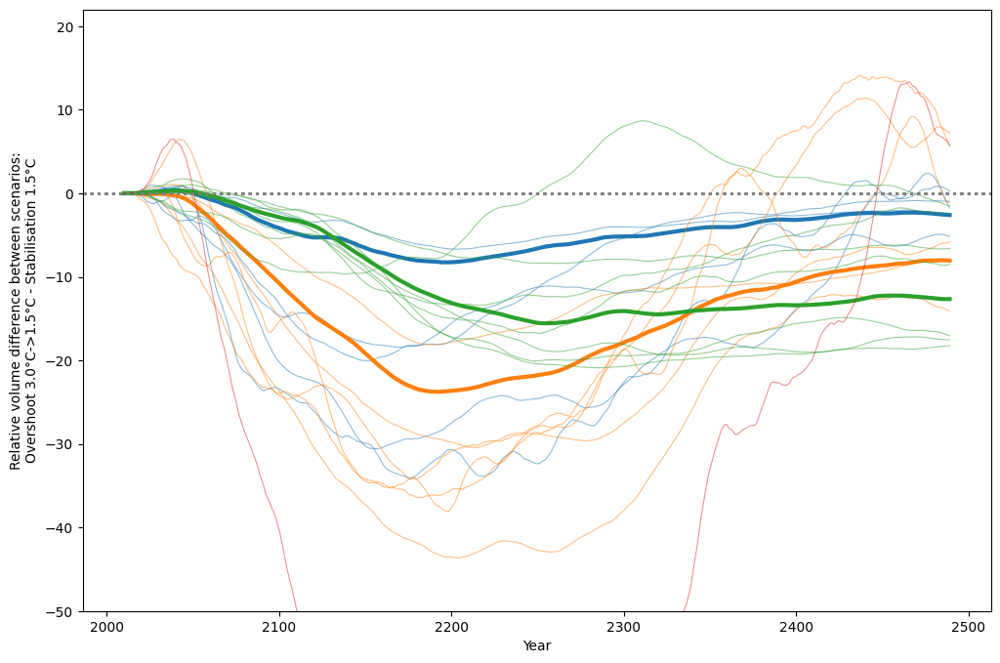

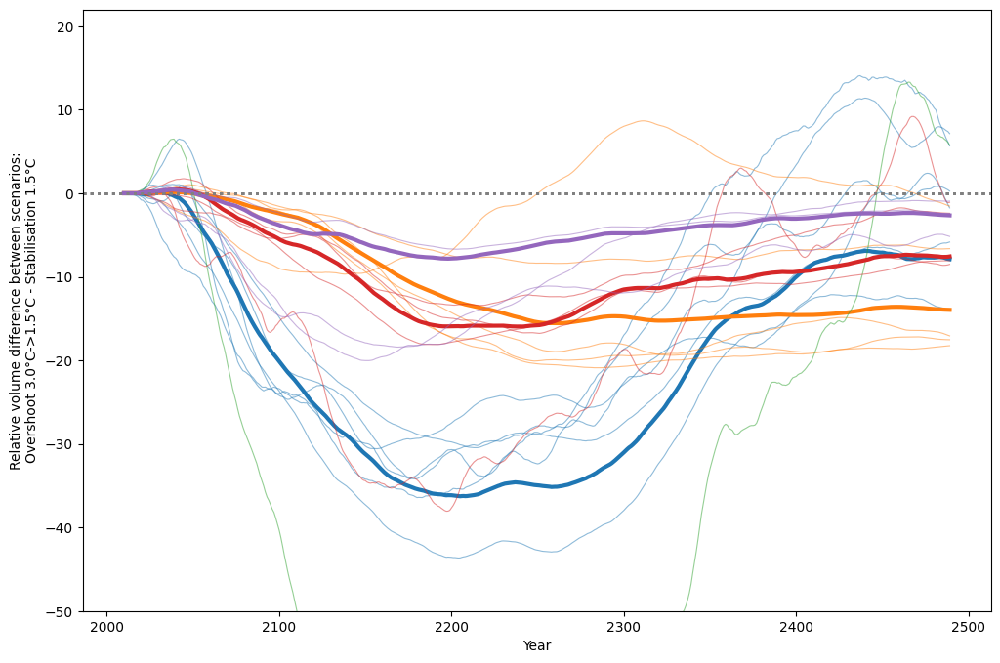

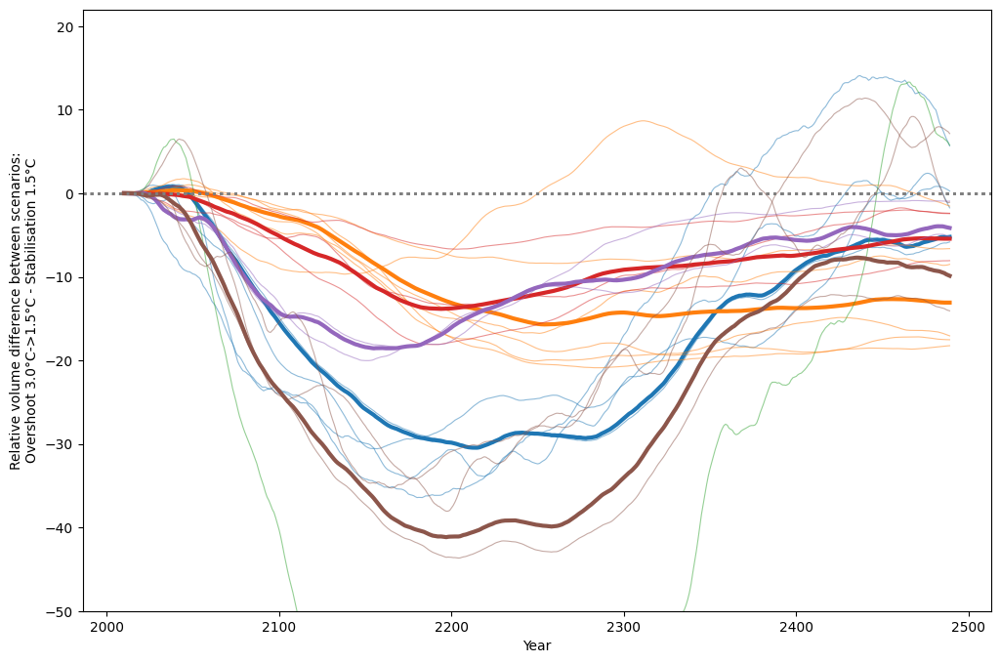

In [10]:
for k in [4,5,6]: 
    for s,p in zip(scenarios,palette):
        if s=='oversh_T30OS15':
            c_o = p
        elif s == 'stab_T15':
            c_s = p
    fig, axs = plt.subplots(1,1, figsize=(12,8), sharey=True)
    ax = axs
    for c in np.arange(0,6,1):
        #ax = axs[c]
        #plt.subplot(2,3,c+1)
        rgi_regs_sel = pd_clusters_all.loc[pd_clusters_all[f'kmeans_{k}clusters{normadd}']==c].index.values
        init_sel_sum = _df_scenario_common_rgi_reg.volume.sel(time=2020).sel(rgi_reg = rgi_regs_sel).sum(dim='rgi_reg')
        _sel = df_scenario_common_rgi_reg.volume.sel(rgi_reg=rgi_regs_sel)
        print(c, _sel.rgi_reg.values)
        
        #ax.set_title([c, _sel.rgi_reg.values], fontsize=12)
        df_scenario_common_cluster = _sel.sum(dim='rgi_reg')
        df_scenario_common_cluster_rel = 100*df_scenario_common_cluster/init_sel_sum
        #äfor s in color_scenario_poster.keys(): 
        sel_diff_rel = df_scenario_common_cluster_rel.sel(scenario='oversh_T30OS15').squeeze()-df_scenario_common_cluster_rel.sel(scenario='stab_T15').squeeze()
        if str(_sel.rgi_reg.values) != "['12']":
            ax.plot(df_scenario_common_cluster_rel.time,
                     sel_diff_rel.rolling(time=21,center=True).mean(),
                     color=f'C{c}', #color_scenario_poster[s],
                     lw=3)  
        sel_diff = df_scenario_common_vol_rel.sel(rgi_reg=rgi_regs_sel).sel(scenario='oversh_T30OS15')-df_scenario_common_vol_rel.sel(rgi_reg=rgi_regs_sel).sel(scenario='stab_T15')
        for r in _sel.rgi_reg:
            ax.plot(_sel.time,
                     sel_diff.sel(rgi_reg=r).squeeze().rolling(time=21, center=True).mean(), lw=0.8, color = f'C{c}', alpha = 0.5)
        ax.axhline(0, lw=2, color='grey',ls=':')
    ax.set_ylim([-50, 22])
    ax.set_ylabel('Relative volume difference between scenarios:\nOvershoot 3.0°C->1.5°C - Stabilisation 1.5°C')
    ax.set_xlabel('Year')

0 ['02' '04' '08' '10' '11']
1 ['05' '13' '14' '15' '16' '18']
2 ['01' '03' '06' '07' '09' '17' '19']
3 ['12']
4 []
5 []
0 ['10' '11' '13' '14' '15' '16']
1 ['03' '06' '07' '09' '19']
2 ['12']
3 ['01' '05' '17' '18']
4 ['02' '04' '08']
5 []
0 ['10' '11' '14' '16']
1 ['01' '03' '06' '07' '09' '19']
2 ['12']
3 ['04' '05' '17']
4 ['02' '08']
5 ['13' '15' '18']


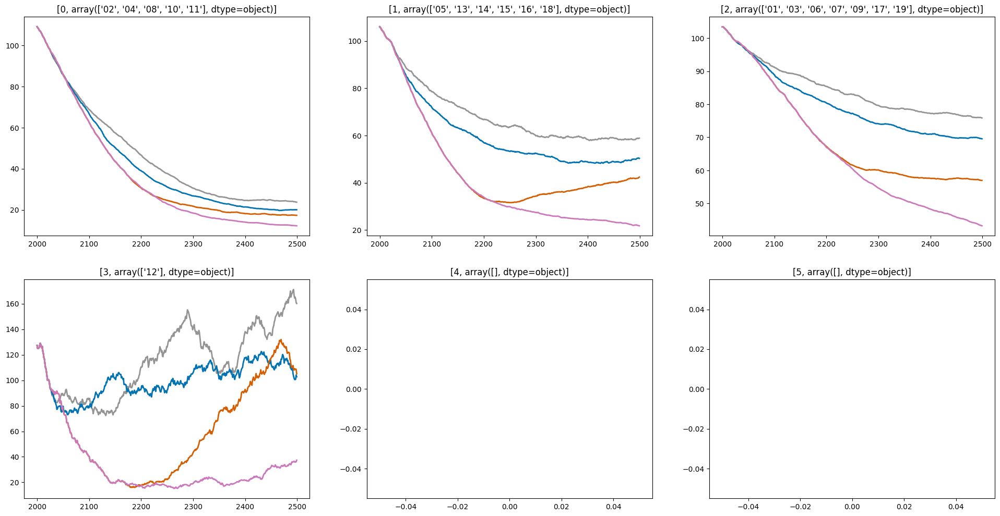

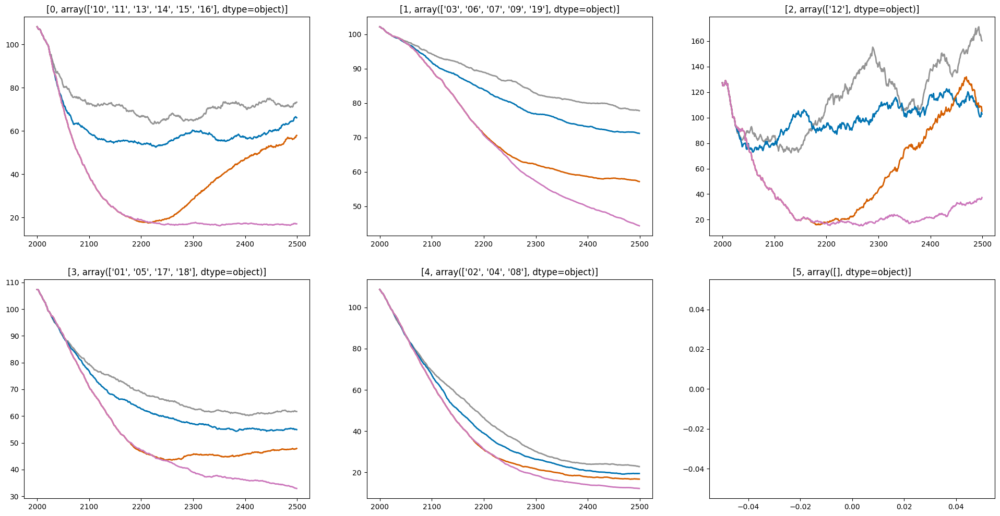

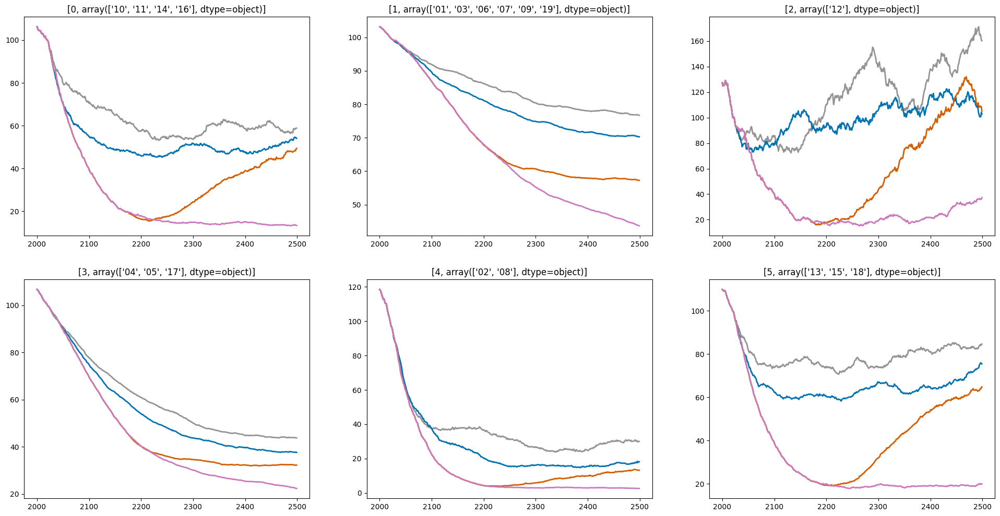

In [11]:
for k in [4,5,6]: 
    for s,p in zip(scenarios,palette):
        if s=='oversh_T30OS15':
            c_o = p
        elif s == 'stab_T15':
            c_s = p
    plt.figure(figsize=(24,12))
    for c in np.arange(0,6,1):
        plt.subplot(2,3,c+1)
        rgi_regs_sel = pd_clusters_all.loc[pd_clusters_all[f'kmeans_{k}clusters{normadd}']==c].index.values
        init_sel_sum = _df_scenario_common_rgi_reg.volume.sel(time=2020).sel(rgi_reg = rgi_regs_sel).sum(dim='rgi_reg')
        _sel = df_scenario_common_rgi_reg.volume.sel(rgi_reg=rgi_regs_sel)
        print(c, _sel.rgi_reg.values)
        plt.title([c, _sel.rgi_reg.values], fontsize=12)
        df_scenario_common_cluster = _sel.sum(dim='rgi_reg')
        df_scenario_common_cluster_rel = 100*df_scenario_common_cluster/init_sel_sum
        for s in color_scenario_poster.keys(): 
            plt.plot(df_scenario_common_cluster_rel.time, df_scenario_common_cluster_rel.sel(scenario=s).squeeze(), color=color_scenario_poster[s],
                    lw=2)    

In [12]:
pd_vol_all_diff = (df_scenario_common_vol_rel_sel.sel(scenario='stab_T15') - df_scenario_common_vol_rel_sel.sel(scenario='oversh_T30OS15')).to_dataframe().reset_index()
pd_vol_all_diff = pd_vol_all_diff[['rgi_reg','time','volume']].pivot(index='time', columns='rgi_reg', values='volume')
pd_vol_all_diff = pd_vol_all_diff.T
data_all = pd_vol_all_diff.values
pregs = pd_vol_all_diff.index
for k in [4,5,6]:  #3
        
    #k = 6  # Number of clusters
    #kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans = KMeans(n_clusters=k,  n_init=100, max_iter=1000)
    labels = ['test']

    #while np.any(labels!=np.array([1, 0, 3, 4, 1, 1, 3, 4, 3, 0, 0, 5, 2, 2, 2, 0, 1, 2, 3])):

    kmeans.fit(data_all)

    # Get the resulting centroids and labels
    centroids = kmeans.cluster_centers_
    labels = kmeans.labels_

    # Print the resulting centroids and labels
    print("Centroids:")
    print(centroids)
    print("Labels:")
    print(labels)

    #pd_clusters_all = pd.DataFrame(index=pregs)
    pd_clusters_all[f'kmeans_{k}clusters_diff_oversh'] = labels
    wcss[f'kmeans_{k}clusters_diff_oversh'] = kmeans.inertia_

    pd_clusters_all
print(wcss)

Centroids:
[[ 2.0153809e-02  1.9584654e-02  1.8501284e-02 ...  1.3926323e+01
   1.3870256e+01  1.3723614e+01]
 [ 4.3040682e-03  4.1242326e-03  4.0174210e-03 ...  3.7236035e+00
   2.7279344e+00  2.6726806e+00]
 [ 0.0000000e+00  0.0000000e+00  0.0000000e+00 ... -7.7109981e+00
  -4.4916158e+00 -2.3348923e+00]
 [ 1.2435908e-03  1.2054439e-03  1.1990867e-03 ...  3.5645103e+00
   3.5370326e+00  3.5363851e+00]]
Labels:
[0 3 3 3 0 3 0 3 0 1 1 2 1 1 1 1 3 1 0]
Centroids:
[[ 2.2697449e-04  2.3651123e-04  2.6130676e-04 ...  9.1616392e-01
  -4.0062380e-01 -2.7021646e-01]
 [ 2.0153809e-02  1.9584654e-02  1.8501284e-02 ...  1.3926323e+01
   1.3870256e+01  1.3723614e+01]
 [ 0.0000000e+00  0.0000000e+00  0.0000000e+00 ... -7.7109981e+00
  -4.4916158e+00 -2.3348923e+00]
 [ 1.2435908e-03  1.2054439e-03  1.1990867e-03 ...  3.5645103e+00
   3.5370326e+00  3.5363851e+00]
 [ 9.7401943e-03  9.3078613e-03  9.0255737e-03 ...  7.4668570e+00
   6.8993454e+00  6.5965433e+00]]
Labels:
[1 3 3 3 1 3 1 3 1 4 0 2 4 4 

In [13]:
pd_clusters_all

,kmeans_4clusters_norm,kmeans_5clusters_norm,kmeans_6clusters_norm,kmeans_4clusters_diff_oversh,kmeans_5clusters_diff_oversh,kmeans_6clusters_diff_oversh
01,2,3,1,0,1,2
02,0,4,4,3,3,5
03,2,1,1,3,3,5
04,0,4,3,3,3,5
05,1,3,3,0,1,2
06,2,1,1,3,3,5
07,2,1,1,0,1,2
08,0,4,4,3,3,5
09,2,1,1,0,1,2
10,0,0,0,1,4,0


In [14]:
# we manually say that the Caucasus/middle east region should be in the same cluster as New Zealand  
# at least for the diff clustering
pd_clusters_all.loc['12', ['kmeans_4clusters_diff_oversh',
       'kmeans_5clusters_diff_oversh', 'kmeans_6clusters_diff_oversh']] = pd_clusters_all.loc['11',['kmeans_4clusters_diff_oversh',
       'kmeans_5clusters_diff_oversh', 'kmeans_6clusters_diff_oversh']]

0 ['01' '05' '07' '09' '19']
1 ['10' '11' '12' '13' '14' '15' '16' '18']
2 []
3 ['02' '03' '04' '06' '08' '17']
4 []
5 []
0 ['11' '12' '15' '16' '18']
1 ['01' '05' '07' '09' '19']
2 []
3 ['02' '03' '04' '06' '08' '17']
4 ['10' '13' '14']
5 []
0 ['10' '11' '12' '14' '18']
1 []
2 ['01' '05' '07' '09' '19']
3 ['13']
4 ['15' '16']
5 ['02' '03' '04' '06' '08' '17']


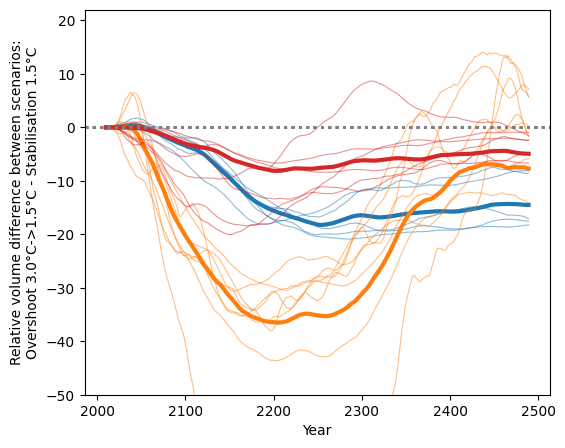

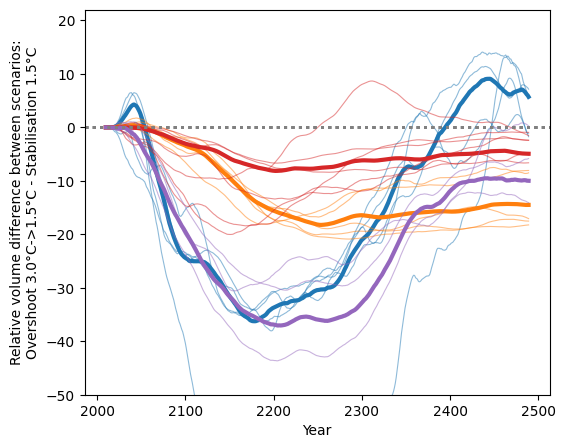

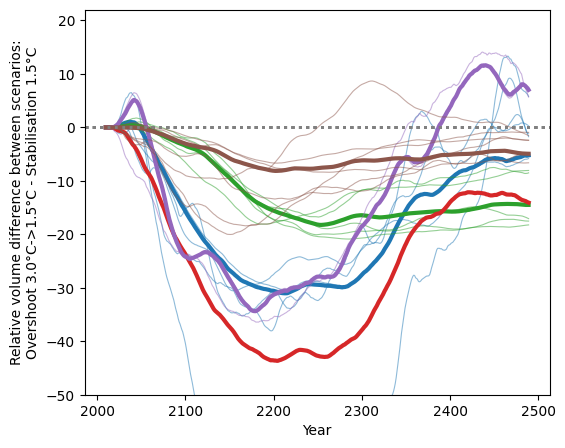

In [15]:
for k in [4,5,6]: 
    for s,p in zip(scenarios,palette):
        if s=='oversh_T30OS15':
            c_o = p
        elif s == 'stab_T15':
            c_s = p
    fig, axs = plt.subplots(1,1, figsize=(6,5), sharey=True)
    ax = axs
    for c in np.arange(0,6,1):
        #ax = axs[c]
        #plt.subplot(2,3,c+1)
        rgi_regs_sel = pd_clusters_all.loc[pd_clusters_all[f'kmeans_{k}clusters_diff_oversh']==c].index.values
        init_sel_sum = _df_scenario_common_rgi_reg.volume.sel(time=2020).sel(rgi_reg = rgi_regs_sel).sum(dim='rgi_reg')
        _sel = df_scenario_common_rgi_reg.volume.sel(rgi_reg=rgi_regs_sel)
        print(c, _sel.rgi_reg.values)
        
        #ax.set_title([c, _sel.rgi_reg.values], fontsize=12)
        df_scenario_common_cluster = _sel.sum(dim='rgi_reg')
        df_scenario_common_cluster_rel = 100*df_scenario_common_cluster/init_sel_sum
        #äfor s in color_scenario_poster.keys(): 
        sel_diff_rel = df_scenario_common_cluster_rel.sel(scenario='oversh_T30OS15').squeeze()-df_scenario_common_cluster_rel.sel(scenario='stab_T15').squeeze()
        if str(_sel.rgi_reg.values) != "['12']":
            ax.plot(df_scenario_common_cluster_rel.time,
                     sel_diff_rel.rolling(time=21,center=True).mean(),
                     color=f'C{c}', #color_scenario_poster[s],
                     lw=3)  
        sel_diff = df_scenario_common_vol_rel.sel(rgi_reg=rgi_regs_sel).sel(scenario='oversh_T30OS15')-df_scenario_common_vol_rel.sel(rgi_reg=rgi_regs_sel).sel(scenario='stab_T15')
        for r in _sel.rgi_reg:
            ax.plot(_sel.time,
                     sel_diff.sel(rgi_reg=r).squeeze().rolling(time=21, center=True).mean(), lw=0.8, color = f'C{c}', alpha = 0.5)
        ax.axhline(0, lw=2, color='grey',ls=':')
    ax.set_ylim([-50, 22])
    ax.set_ylabel('Relative volume difference between scenarios:\nOvershoot 3.0°C->1.5°C - Stabilisation 1.5°C')
    ax.set_xlabel('Year')

0 ['01' '05' '07' '09' '19']
1 ['10' '11' '12' '13' '14' '15' '16' '18']
2 []
3 ['02' '03' '04' '06' '08' '17']
4 []
5 []
0 ['11' '12' '15' '16' '18']
1 ['01' '05' '07' '09' '19']
2 []
3 ['02' '03' '04' '06' '08' '17']
4 ['10' '13' '14']
5 []
0 ['10' '11' '12' '14' '18']
1 []
2 ['01' '05' '07' '09' '19']
3 ['13']
4 ['15' '16']
5 ['02' '03' '04' '06' '08' '17']


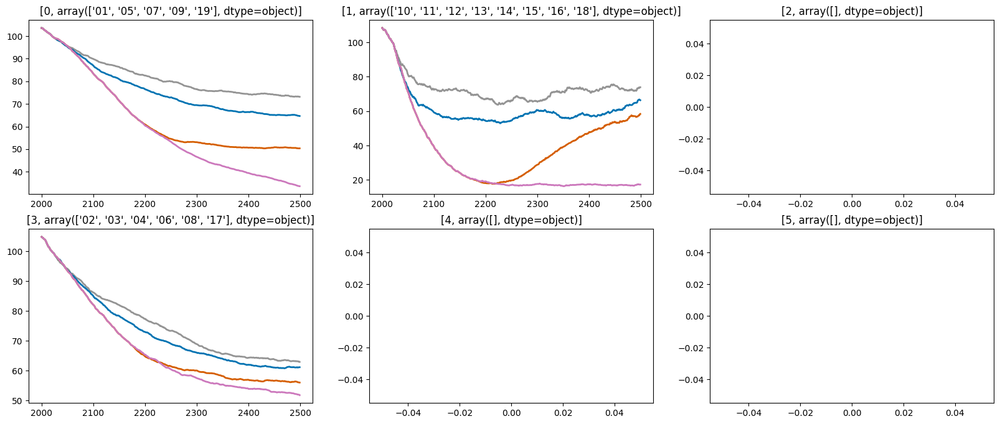

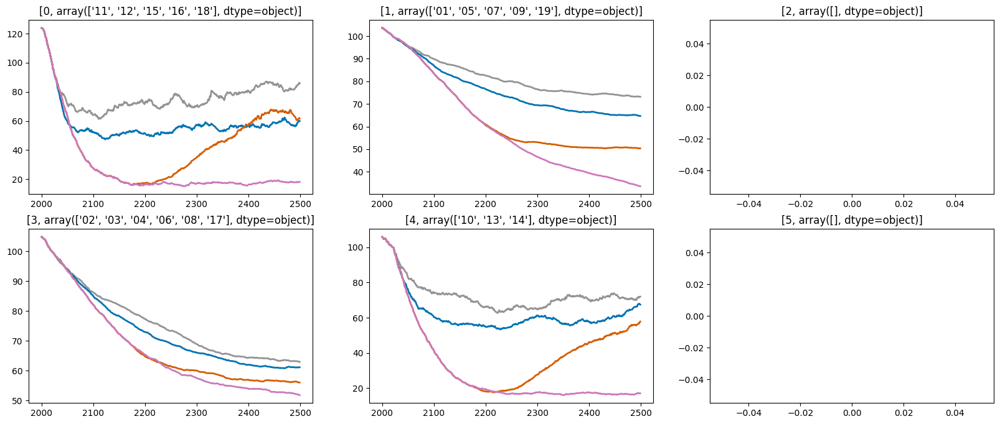

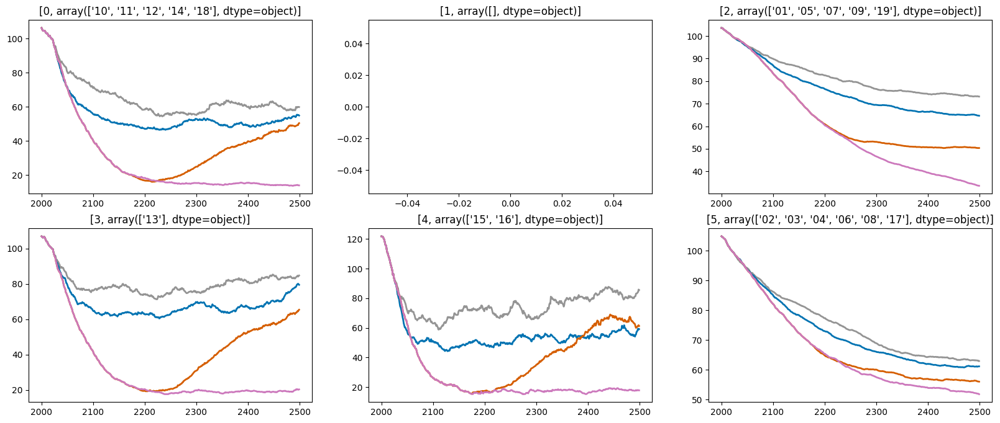

In [16]:
#k = 6
for k in [4,5,6]: 

    for s,p in zip(scenarios,palette):
        if s=='oversh_T30OS15':
            c_o = p
        elif s == 'stab_T15':
            c_s = p
    plt.figure(figsize=(20,8))
    for c in np.arange(0,6,1):
        plt.subplot(2,3,c+1)        
        rgi_regs_sel = pd_clusters_all.loc[pd_clusters_all[f'kmeans_{k}clusters_diff_oversh']==c].index.values
        init_sel_sum = _df_scenario_common_rgi_reg.volume.sel(time=2020).sel(rgi_reg = rgi_regs_sel).sum(dim='rgi_reg')
        _sel = df_scenario_common_rgi_reg.volume.sel(rgi_reg=rgi_regs_sel)
        print(c, _sel.rgi_reg.values)
        plt.title([c, _sel.rgi_reg.values], fontsize=12)
        df_scenario_common_cluster = _sel.sum(dim='rgi_reg')
        df_scenario_common_cluster_rel = 100*df_scenario_common_cluster/init_sel_sum
        for s in color_scenario_poster.keys(): 
            plt.plot(df_scenario_common_cluster_rel.time, df_scenario_common_cluster_rel.sel(scenario=s).squeeze(), color=color_scenario_poster[s],
                    lw=2)    

In [40]:
#plt.rc('font', size=14)
df_scenario_common = df_scenario_common_rgi_reg
for k in [4,5,6]: 
    for b,c in zip(pd_clusters_all.index, pd_clusters_all[f'kmeans_{k}clusters{normadd}'].values):
        df_rgi6g.loc[df_rgi6g.O1Region==b,f'kmeans_{k}clusters'] = c
        
for k in [4,5,6]: 
    for b,c in zip(pd_clusters_all.index, pd_clusters_all[f'kmeans_{k}clusters_diff_oversh'].values):
        df_rgi6g.loc[df_rgi6g.O1Region==b,f'kmeans_{k}clusters_diff_oversh'] = c

### Some summary plots

In [41]:
regs = pd_clim_all.region.unique()[2:]
#from sklearn.preprocessing import StandardScaler
# I think that does not work ... 
#pd_clim_all['temp_31yr_avg'] = pd_clim_all[['temp','year']].rolling(31, 31, center=True, on='year').mean()['temp'].dropna()

# volume difference of stabilisation vs overshoot  (rel. to 2020)
end_vol_rel_diff_stab_oversh = pd_vol_all_diff[2489].values  # for the end year
max_vol_rel_diff_stab_oversh =pd_vol_all_diff.max(axis=1).values # and maximum difference 
# volume of overshoot scenario (rel. to 2020)
end_vol_oversh =df_scenario_common_vol_rel_sel.sel(scenario='oversh_T30OS15').sel(time=2489).values.squeeze()
end_vol_stabT15 =df_scenario_common_vol_rel_sel.sel(scenario='stab_T15').sel(time=2489).values.squeeze()

min_vol_oversh =df_scenario_common_vol_rel_sel.sel(scenario='oversh_T30OS15').min(dim='time').values.squeeze()
# temperature stuff ---> started to apply now a 101 yr rolling average
roll_avg = 101
_ds_clim_oversh = pd_clim_all.groupby(['region','year', 'scenario']).mean().to_xarray().sel(scenario='oversh_T30OS15')
_temp_ch_oversh = (_ds_clim_oversh.rolling(year=roll_avg, center=True).mean()['temp'].dropna(dim='year') - _ds_clim_oversh.rolling(year=21, center=True).mean()['temp'].sel(year=2010)).sel(region=regs)

_ds_clim_stab = pd_clim_all.groupby(['region','year', 'scenario']).mean().to_xarray().sel(scenario='stab_T15')
_temp_ch_stab = (_ds_clim_stab.rolling(year=roll_avg, center=True).mean()['temp'].dropna(dim='year') - _ds_clim_stab.rolling(year=21, center=True).mean()['temp'].sel(year=2010)).sel(region=regs)
temp_ch_oversh_max = (_temp_ch_oversh).max(dim='year').values
temp_ch_oversh_end = (_temp_ch_oversh).isel(year=-1).values

temp_ch_diff_oversh_stab_end = temp_ch_oversh_end-(_temp_ch_stab).isel(year=-1).values
temp_ch_diff_oversh_stab_max = (_temp_ch_oversh-_temp_ch_stab).max(dim='year').values



**for k ==4**

In [42]:
k = 4

Text(0, 0.5, 'Maximum remaining ice difference (% rel. to 2020)\n(Overshoot 3.0°C->1.5°C - Stabilisation 1.5°C)')

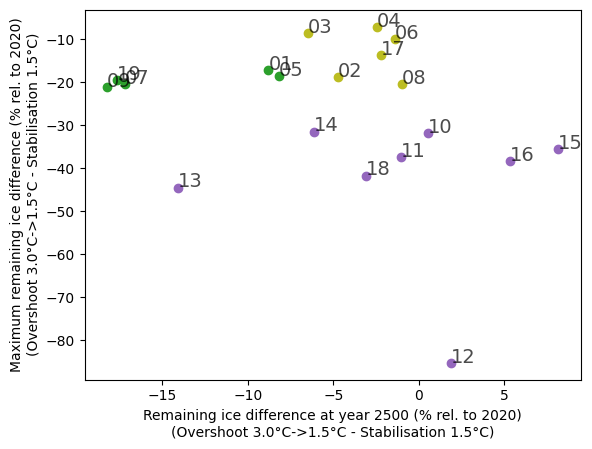

In [50]:

pd_t = pd.DataFrame([-end_vol_rel_diff_stab_oversh, -max_vol_rel_diff_stab_oversh]).T
pd_t['region'] = df_scenario_common_vol_rel_sel.rgi_reg
pd_t.index = pd_t.region
def plotlabel(xvar, yvar, label, ax=None):
    ax = plt.gca()
    ax.text(xvar-0.01, yvar+0.05, label, alpha=0.7, fontsize=14)

for c in np.arange(0,6,1):
    rgi_regs_sel = pd_clusters_all.loc[pd_clusters_all[f'kmeans_{k}clusters_diff_oversh']==c].index.values
    pd_t_sel = pd_t.loc[rgi_regs_sel]
    plt.plot(pd_t_sel[0], pd_t_sel[1],'o', color=cols[c])
pd_t.apply(lambda x: plotlabel(x[0],x[1], x.region, ax=ax), axis=1)
plt.xlabel('Remaining ice difference at year 2500 (% rel. to 2020)\n(Overshoot 3.0°C->1.5°C - Stabilisation 1.5°C)')
plt.ylabel('Maximum remaining ice difference (% rel. to 2020)\n(Overshoot 3.0°C->1.5°C - Stabilisation 1.5°C)')

Text(0, 0.5, 'Stabilisation vs Overshoot difference changes\n(maximum - year 2500 difference, in % rel. to 2020)')

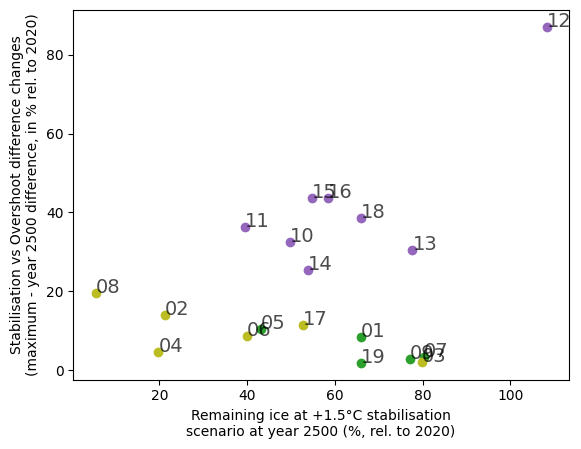

In [44]:
pd_t = pd.DataFrame([end_vol_stabT15, max_vol_rel_diff_stab_oversh-end_vol_rel_diff_stab_oversh]).T
pd_t['region'] = df_scenario_common_vol_rel_sel.rgi_reg
pd_t.index = pd_t.region
def plotlabel(xvar, yvar, label, ax=None):
    ax = plt.gca()
    ax.text(xvar-0.01, yvar+0.05, label, alpha=0.7, fontsize=14)

for c in np.arange(0,6,1):
    rgi_regs_sel = pd_clusters_all.loc[pd_clusters_all[f'kmeans_{k}clusters_diff_oversh']==c].index.values
    pd_t_sel = pd_t.loc[rgi_regs_sel]
    plt.plot(pd_t_sel[0], pd_t_sel[1],'o', color=cols[c])

pd_t.apply(lambda x: plotlabel(x[0],x[1], x.region, ax=ax), axis=1)
plt.xlabel('Remaining ice at +1.5°C stabilisation\nscenario at year 2500 (%, rel. to 2020)')
plt.ylabel('Stabilisation vs Overshoot difference changes\n(maximum - year 2500 difference, in % rel. to 2020)')

**Now the map ... ***

In [174]:
delta = 0
coordinates = [
    [0.0245, 0.25 + delta],
    [0.052, 0.762 + delta],
    [0.11, 0.628 + delta],
    [0.205, 0.88 + delta],
    [0.26, 0.635 + delta],
    [0.325, 0.90 + delta],
    [0.37, 0.67 + delta],
    [0.43, 0.91 + delta],
    [0.54, 0.912 + delta],
    [0.63, 0.89 + delta],
    [0.77, 0.817 + delta],
    [0.445, 0.597 + delta],
    [0.538, 0.56 + delta],
    [0.725, 0.645 + delta],
    [0.613, 0.527 + delta],
    [0.70, 0.497 + delta],
    [0.46, 0.438 + delta],
    [0.335, 0.331 + delta],
    [0.812, 0.385 + delta],
    [0.54, 0.225 + delta]
]

In [205]:


# go down from rgi7_scripts/workflow
data_dir = '/home/www/fmaussion/misc/rgi7_data/rgi7_final'

# from fabi's RGI6/rgi7 code  ... https://nbviewer.org/urls/cluster.klima.uni-bremen.de/~fmaussion/misc/rgi7_scripts/workflow/postprocessing/plots_for_doc/global_overview_maps.ipynb
df_reg_shp_rgi7 = gpd.read_file('zip://' + data_dir+'/RGI2000-v7.0-regions.zip/RGI2000-v7.0-o1regions.shp')
df_reg_shp_rgi7['min_x'] = [g.bounds[0] for g in df_reg_shp_rgi7.geometry]
df_reg_shp_rgi7['max_x'] = [g.bounds[2] for g in df_reg_shp_rgi7.geometry]
df_reg_shp_rgi7['min_y'] = [g.bounds[1] for g in df_reg_shp_rgi7.geometry]
df_reg_shp_rgi7['max_y'] = [g.bounds[3] for g in df_reg_shp_rgi7.geometry]

In [330]:
num_dict = {0:'(a)', 1:'(b)', 2:'(c)', 3:'(d)', 4: '(e)',
            5:'(f)', 6:'(g)', 7:'(h)', 8:'(i)', 9:'(j)',
            10:'(k)', 11:'(l)', 12:'(m)'} 

0 ['01' '05' '07' '09' '19']
1 ['10' '11' '12' '13' '14' '15' '16' '18']
2 []
3 ['02' '03' '04' '06' '08' '17']
4 []
5 []
0 ['01' '05' '07' '09' '19']
65.37
3 ['02' '03' '04' '06' '08' '17']
29.78
1 ['10' '11' '12' '13' '14' '15' '16' '18']
4.84


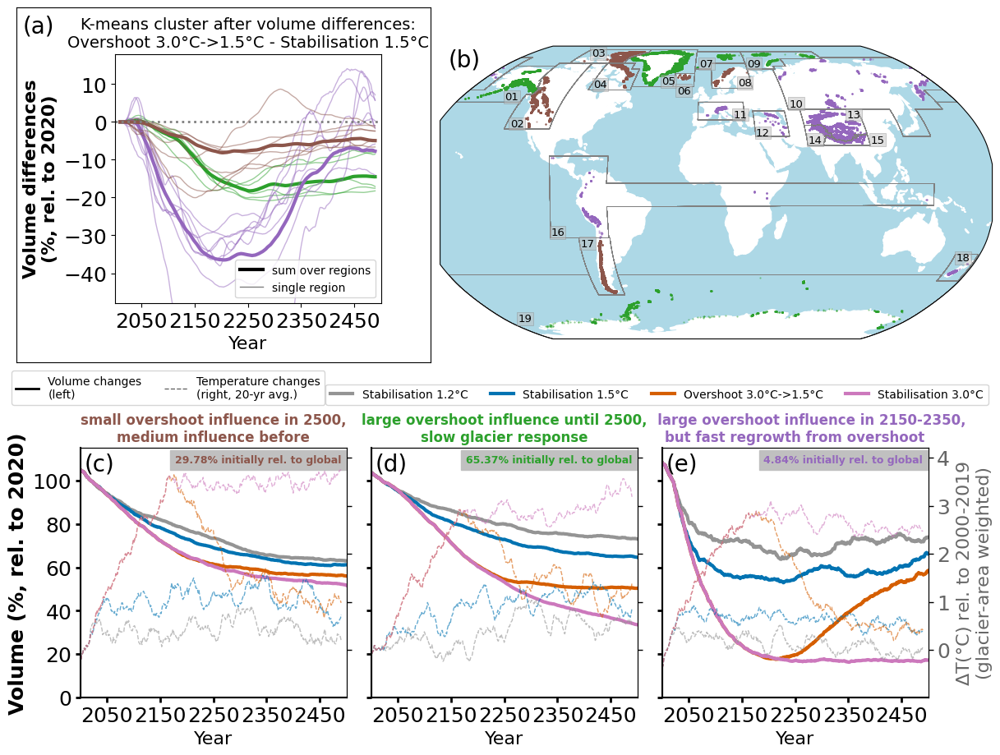

In [346]:
for k in [k]: #,5,6]: 
    for clustering_opt in [f'kmeans_{k}clusters_diff_oversh']: #,  f'kmeans_{k}clusters{normadd}', 
        if clustering_opt == f'kmeans_{k}clusters_diff_oversh':
            kk = k-1
        else:
            kk = k
        pie_scenarios = [2]
        for pie_scenario in pie_scenarios:

            fig = plt.figure() #figsize=(20,8))
            # Add background image
            ax_background = fig.add_axes([0.44,0.5,0.56,0.5], projection=ccrs.Robinson())
            ax_background.patch.set_facecolor('lightblue')
            ax_background.get_yaxis().set_visible(False)
            ax_background.get_xaxis().set_visible(False)
        #    ax_background.coastlines(color='white')
            ax_background.add_feature(cartopy.feature.LAND, color='white')

            # Add global boundary
            ax_global_patch = fig.add_axes([0.01,0.52,0.42,0.48], facecolor='white')
            ax_global_patch.get_yaxis().set_visible(False)
            ax_global_patch.get_xaxis().set_visible(False)

            # Add RGI glacier outlines
            cols = ['C2','C4','C8','C5','C9','C6']

            if add_rgi_glaciers:
                # if I do that here: 
                # **somehow only the glaicers of one RGI region are visible**
                #shape_feature = ShapelyFeature(Reader(rgi_shp_fn).geometries(), ccrs.Robinson(),alpha=1,facecolor='indigo',linewidth=0.35,edgecolor='indigo')
                #ax_background.add_feature(shape_feature)
                # instead aplly that here ... 
                for c in np.arange(0,6,1):
                    df_rgi6g_sel = df_rgi6g.loc[df_rgi6g[clustering_opt]==c]
                    ax_background.scatter(df_rgi6g_sel.CenLon.values, df_rgi6g_sel.CenLat.values,
                                          color=cols[c],
                                          #color='lightgrey',
                                          s=0.3, alpha =0.5,
                                          transform=ccrs.PlateCarree());
            for en,rgi_reg in enumerate(df_scenario_common.rgi_reg):
                coords = coordinates[en]
                shape_feature = ShapelyFeature(Reader(rgi_regions_fn).geometries(), ccrs.Robinson(),facecolor="None", edgecolor='grey', alpha = 1, lw=0.4)
                                               #alpha=1,facecolor='None',linewidth=0.35,edgecolor='k')
                ax_background.add_feature(shape_feature)
                
            
            ### copied from fabis RGI6/7 code ....
            did10 = False
            for i, r in df_reg_shp_rgi7.iterrows():
                tx = r.min_x + 4
                ty = r.min_y 
                fs = 16
                t = r.o1region

                if t == '01':
                    tx = r.min_x + 35
                if t == '03':
                    tx = r.min_x + 15
                    ty = r.min_y + 3
                if t == '05':
                    tx = r.min_x + 40
                if t == '06':
                    ty = r.min_y - 5.5
                if t == '08':
                    tx = r.min_x + 20
                if t == '09':
                    tx = r.min_x 
                if t == '11':
                    tx = r.min_x + 24
                if t == '10':
                    tx = r.min_x + 1
                    ty = r.min_y + 15
                    if not did10:
                        did10 = True
                        continue
                if t == '13':
                    ty = r.min_y + 12
                    tx = r.min_x + 30
                if t in ['14', '12', '16', '17']:
                    tx = r.min_x 
                if t == '15':
                    tx = r.min_x + 30
                if t == '17':
                    ty = r.min_y + 26
                if t == '18':
                    ty = r.min_y + 10
                if t == '19':
                    ty = r.min_y + 10
                if t == '20':
                    continue

                ax_background.text(tx, ty, t, transform=ccrs.PlateCarree(), 
                        ha='left', va='bottom', fontsize=9.5,bbox=dict(facecolor='silver', edgecolor='grey',
                                                                       pad=1, lw=0.5, alpha=0.5)
                                  )
            #################
            
            reg_pie_sizes=[]
            for c in np.arange(0,kk,1):
                pie_size = 0.27
                reg_pie_sizes.append(pie_size)
            fac=1.25
            axgb = fig.add_axes([0.11,0.6,reg_pie_sizes[0],reg_pie_sizes[0]*fac], facecolor='white') # 0.01 
            
            
            ax = axgb
            # just for the legend
            line1 = Line2D([0], [0], color='k',
                             label='sum over regions',
                             lw=3, alpha = 1)  
            line2 = Line2D([0], [0], color='k',
                             label='single region',
                             lw=1, alpha = 0.5)  
            from matplotlib.lines import Line2D
            ax.legend([line1,line2],['sum over regions','single region'],
                       fontsize=10, ncol=1, loc='lower right')
            ##############################
            
            for c in np.arange(0,6,1):
                #ax = axs[c]
                #plt.subplot(2,3,c+1)
                rgi_regs_sel = pd_clusters_all.loc[pd_clusters_all[f'kmeans_{k}clusters_diff_oversh']==c].index.values
                init_sel_sum = _df_scenario_common_rgi_reg.volume.sel(time=2020).sel(rgi_reg = rgi_regs_sel).sum(dim='rgi_reg')
                _sel = df_scenario_common_rgi_reg.volume.sel(rgi_reg=rgi_regs_sel)
                print(c, _sel.rgi_reg.values)
                #ax.set_title([c, _sel.rgi_reg.values], fontsize=12)
                df_scenario_common_cluster = _sel.sum(dim='rgi_reg')
                df_scenario_common_cluster_rel = 100*df_scenario_common_cluster/init_sel_sum
                #äfor s in color_scenario_poster.keys(): 
                sel_diff_rel = df_scenario_common_cluster_rel.sel(scenario='oversh_T30OS15').squeeze()-df_scenario_common_cluster_rel.sel(scenario='stab_T15').squeeze()
                if str(_sel.rgi_reg.values) != "['12']":
                    ax.plot(df_scenario_common_cluster_rel.time,
                             sel_diff_rel.rolling(time=21,center=True).mean(),
                             color=f'{cols[c]}', #color_scenario_poster[s],
                             lw=3)  
                sel_diff = df_scenario_common_vol_rel.sel(rgi_reg=rgi_regs_sel).sel(scenario='oversh_T30OS15')-df_scenario_common_vol_rel.sel(rgi_reg=rgi_regs_sel).sel(scenario='stab_T15')
                for r in _sel.rgi_reg:
                    ax.plot(_sel.time,
                             sel_diff.sel(rgi_reg=r).squeeze().rolling(time=21, center=True).mean(), lw=1, color = f'{cols[c]}', alpha = 0.5,
                            )

            ax.axhline(0, lw=2, color='grey',ls=':')
            
            ax.set_ylim([-48, 18])
            ax.set_yticks([-40,-30,-20,-10,0,10])
            ax.set_ylabel('Volume differences\n(%, rel. to 2020)', fontsize=16,fontweight='bold')
            ax.set_title('K-means cluster after volume differences:\nOvershoot 3.0°C->1.5°C - Stabilisation 1.5°C', fontsize=14)
            ax.set_xlabel('Year', fontsize=16) #,fontweight='bold')
            ax.set_xlim([2000,2500])
            ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
            
            ax0b = fig.add_axes([0.075,0.067,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')
            ax1b = fig.add_axes([0.37,0.067,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')
            ax2b = fig.add_axes([0.665,0.067,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')    
            #ax3b = fig.add_axes([0.05,0.04,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')
            #ax4b = fig.add_axes([0.38,0.04,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')
            #ax5b = fig.add_axes([0.71,0.04,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')


            ################################## REGIONAL
            texts = ['large overshoot influence until 2500,\nslow glacier response',
                'small overshoot influence in 2500,\nmedium influence before',
                '       large overshoot influence in 2150-2350,\nbut fast regrowth from overshoot']
                     #, 'fast response, large loss',
                     # r'fast regrowth, highest $\Delta$T sensitivity',
                 #r'fastest regrowth, medium loss', #high $\Delta$T sensitivity', 'slow response, medium loss',
                 #    '..., large loss', r'fast regrowth, highest $\Delta$T sensitivity'
                 #'no regional temp. overshoot'
            nums = ['(d)','(c)','(e)'] #,'(d)','(e)','(g)']
            #            nums = ['(b)','(d)','(f)','(a)','(e)','(c)']
            for cc,ax in enumerate([ax1b,ax0b,ax2b,
                                    #ax3b,ax4b,ax5b
                                   ][:kk]):

                c = pd_clusters_all[clustering_opt].unique()[cc]
                _sel = df_scenario_common.volume.sel(rgi_reg=pd_clusters_all.loc[pd_clusters_all[clustering_opt]==c].index.values)
                print(c, _sel.rgi_reg.values)
                #ax.set_title(c, color=f'C{c}')
                df_scenario_common_cluster = _sel.sum(dim='rgi_reg')
                df_scenario_common_cluster_rel = 100*df_scenario_common_cluster/df_scenario_common_cluster.sel(time=2020)
                for s in color_scenario_poster.keys(): 
                    ax.plot(df_scenario_common_cluster_rel.time, df_scenario_common_cluster_rel.sel(scenario=s).squeeze(),
                            color=color_scenario_poster[s],
                            lw=3, label=label_scenario[s]) 
                leg = ax.legend(loc='lower left', bbox_to_anchor=(0.9,1.15), fontsize=10, ncol=4)

                if cc == 1:
                    ### add legends
                    handles, labels = ax.get_legend_handles_labels()
                    handles_2, labels_2 = ax2.get_legend_handles_labels()
                    leg2 = ax.legend([handles[0], handles_2[0]], ['Volume changes\n(left)',
                                                                  'Temperature changes\n(right, 20-yr avg.)'],
                                     loc='lower left', ncol=2, fontsize=10, bbox_to_anchor=(-0.28,1.15))
                    leg2.get_lines()[0].set_linewidth(2)
                    leg2.get_lines()[1].set_linewidth(1)
                    for l in leg2.get_lines():
                        l.set_color('black')
                    ax.add_artist(leg)    
                else:
                    leg.remove()
                    
            
                ax.set_title(texts[cc], color=cols[c], fontsize=12,fontweight='bold') #+' '+ texts[c], fontsize=11)
                delta=0
                tt = ''
                rgi_regs_temp=[]
                for p in _sel.rgi_reg.values:
                    t = d_reg_num_name[p]
                    if tt !='':
                        tt = tt + '\n' +t
                    else:
                        tt=t

                    #shape_feature = ShapelyFeature(geo, ccrs.PlateCarree(), facecolor="None", edgecolor=cols[c], lw=2)
                    #ax_background.add_feature(shape_feature)

                    shape_feature = ShapelyFeature(Reader(rgi_regions_fn).geometries(), ccrs.Robinson(),facecolor="None", edgecolor='grey', alpha = 1, lw=0.4)
                                                   #alpha=1,facecolor='None',linewidth=0.35,edgecolor='k')
                    ax_background.add_feature(shape_feature)
                    label_rgi_reg = False
                    if label_rgi_reg:
                        # TODO
                        geo = gdf.loc[gdf.provide_id == p]['geometry'].values
                        max_x = gdf.loc[gdf.provide_id == p]['max_x'].values[0]
                        max_y = gdf.loc[gdf.provide_id == p]['max_y'].values[0]
                        print(max_x,max_x)
                        if p in ['P13','P02','P01','P03', 'P05']:
                            ax_background.text(max_x-30,max_y-1, p, va='top', ha='right',
                               transform=ccrs.PlateCarree(),
                               fontsize=8, fontweight='bold') #, backgroundcolor=cols[c]) #, edgecolor=cols[c] )
                        elif p == 'P06':
                            ax_background.text(179,max_y-1, p, va='top', ha='right',
                               transform=ccrs.PlateCarree(),
                               fontsize=8, fontweight='bold')
                        else:
                            ax_background.text(max_x-3,max_y-1, p, va='top', ha='right',
                                               transform=ccrs.PlateCarree(),
                                               fontsize=8, fontweight='bold') #, backgroundcolor=cols[c]) #, edgecolor=cols[c] )

                    rgi_regs_temp.append(f'RGI{p}_glacier')

                init = df_scenario_common_cluster.isel(time=0).mean() # all 8 scenarios are anyways equal
                init_all = df_scenario_common.isel(time=0).sum(dim='rgi_reg').volume.mean()
                perc_init = np.round(100*init/init_all,2).values
                print(perc_init)
                #tt = tt + f'\n{perc_init}% initially rel. to global' 
                tt = f'{perc_init}% initially rel. to global' 

                if cols[c] =='C8':
                    bc = 'grey'
                else:
                    bc='silver'
                #if c in [10]:
                #    if c==4:
                #        fs=7
                #    else:
                #        fs=7
                #    ax.text(2015,5, tt , va='bottom', fontsize=fs, ha='left', color=cols[c], backgroundcolor=bc, fontweight='bold', zorder=0)
                #else:
                ax.text(2490,112, tt , va='top', fontsize=9, ha='right', color=cols[c], backgroundcolor=bc, fontweight='bold')
                ax.set_ylim([0,115])
                ax.set_xlim([2000,2500])
                ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
                for axis in 'left', 'bottom':
                    ax.spines[axis].set_linewidth(1.5)
                ax.tick_params(axis='both', which='major', width=2, length=4)

                ### regional glacier-area weighted temp. change 
                if len(rgi_regs_temp) == 1:
                    pd_clim_all_r = pd_clim_all.loc[pd_clim_all.region == f'RGI{p}_glacier']
                else :
                    condis = np.repeat(False, len(pd_clim_all.region))
                    # should be in one of the basins 
                    for r in rgi_regs_temp:
                        condis = condis | (pd_clim_all.region == r) 
                    assert len(rgi_regs_temp)*len(pd_clim_all.scenario.unique())*len(pd_clim_all.year.unique()) == len(pd_clim_all[condis])
                    pd_clim_all_r = pd_clim_all.loc[condis].groupby(['scenario', 'year'])[['temp_20yr_avg', 
                                                                                           'area']].apply(lambda x: np.average(x['temp_20yr_avg'], weights=x['area'])).dropna().reset_index()
                    pd_clim_all_r['temp_20yr_avg'] = pd_clim_all_r[0].values

                ax2 = ax.twinx()  
                for scenario in color_scenario_poster.keys():
                    pd_clim_scenario_g = pd_clim_all_r.loc[pd_clim_all_r.scenario==scenario]
                    pd_clim_scenario_g.index = pd_clim_scenario_g.year
                    # this is approximately correct .. 
                    temp_ref_g = pd_clim_scenario_g.loc[2009][['temp_20yr_avg']].mean()
                    var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

                    ax2.plot(pd_clim_scenario_g.year,
                             var_g_to_ref,
                             alpha = 0.6, 
                             ls = '--',
                             lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
                ax2.set_ylabel('')
                ax2.set_yticks(ticks=[0,1,2,3,4],
                               labels=[0,1,2,3,4], alpha=0.6)
                ax2.set_ylim([-0.99,4.2]);
                ax2.set_xlim([2000,2500])
                ax2.tick_params(axis='both', which='major', width=1, length=4, grid_alpha =0.6)
                if nums[cc] in ['(e)','(f)']:
                    ax2.set_ylabel(r'$\Delta$T'+'(°C) rel. to 2000-2019\n(glacier-area weighted)',
                                  alpha = 0.6, fontsize=16)
                    plt.setp(ax.get_yticklabels(), visible=False, fontsize=1)
                elif nums[cc] == '(c)':
                    ax.set_ylabel('Volume (%, rel. to 2020)',fontweight='bold')   
                    plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

                else:
                    plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
                    plt.setp(ax.get_yticklabels(), visible=False, fontsize=1)
                ax.set_xlabel('Year', fontsize=16) #,fontweight='bold')

                                    
        ##################################
        num_text_x = 0.015
        for j,axi in enumerate([ax_global_patch, ax_background,ax0b,ax1b,ax2b]):
            num_text_y = 0.93
            shift = 0
            if j>=2:
                shift = -0.02
            axi.text(num_text_x, num_text_y+shift,
                     num_dict[j], fontsize=20, transform=axi.transAxes)
        
        #plt.savefig('2x_worldmap_cluster_volume_v0.png')
        #plt.savefig('figures/2x_worldmap_cluster_volume_v0.png')
        fig.set_size_inches(12, 9)
        if 'diff_oversh' in clustering_opt:
            clustering_opt_add = f'{clustering_opt}_12_merged_to_11_cluster'
        else:
            clustering_opt_add = clustering_opt
        fig.savefig(f'2x_worldmap_cluster_volume_rgi_reg_{clustering_opt}_v2.png', dpi=300)

In [ ]:
pd_gmip3_stats = pd.read_csv('glaciermip3_shift_summary_region_characteristics.csv',index_col=0)
pd_gmip3_stats = pd_gmip3_stats.drop(columns = ['prcp_avg_1981-2000','temp_avg_1981-2000',
 'prcp_avg_1995-2014','temp_avg_1995-2014',
 'continentality_index_avg_1995-2014', 'continentality_index_avg_1981-2000'])
regrowth_var = end_vol_oversh-min_vol_oversh
pd_gmip3_stats['regrowth_overshoot_study'] = np.concatenate([np.array([np.NaN]),(regrowth_var)])
pd_gmip3_stats['diff_yr_2500_overshoot_study']  = np.concatenate([np.array([np.NaN]),
                                                                  (-end_vol_rel_diff_stab_oversh)])
pd_gmip3_stats['maximum_difference_overshoot_study'] =  np.concatenate([np.array([np.NaN]),
                                                                        -max_vol_rel_diff_stab_oversh])


pd_gmip3_stats['end_vol_stabT15'] = np.concatenate([np.array([np.NaN]),
                                                                  (end_vol_stabT15)])



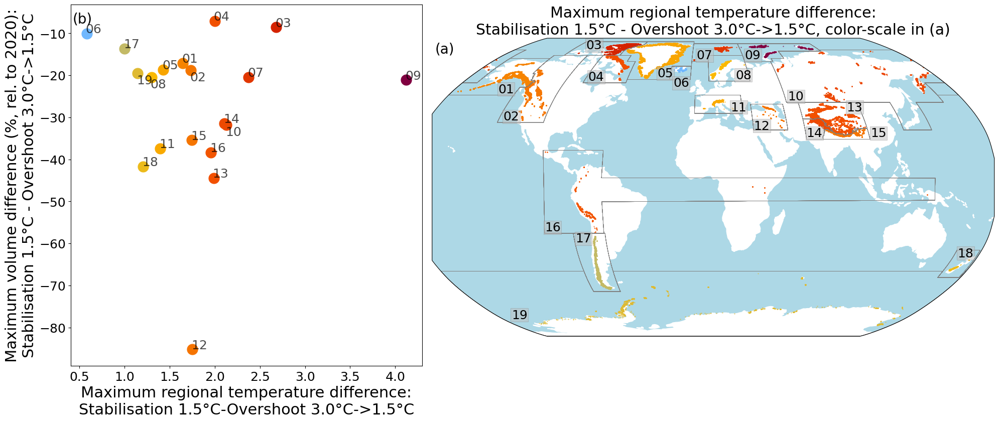

In [377]:
from matplotlib.colors import LinearSegmentedColormap
from sklearn.preprocessing import MinMaxScaler
colors_icci_l3 = ['#70B8FF', '#FABB00', '#F25100', '#D42300', '#B3001E', '#800040']#, '#550066']#, '#2B084D'] #,
cmap_icci_3 = LinearSegmentedColormap.from_list('bins_100', colors_icci_l3, N=1000)
# IDEA --> Let's scale from 1.2 onwards
scaler = MinMaxScaler()
temp_ch_sel = np.arange(temp_ch_diff_oversh_stab_max.min(),temp_ch_diff_oversh_stab_max.max(),0.25)
scaler.fit(temp_ch_sel.reshape(-1,1))
cmap = cmap_icci_3

fig = plt.figure(figsize=(20,8))
# Add background image
ax_background = fig.add_axes([0.44,0.05,0.56,0.95], projection=ccrs.Robinson())
ax_background.patch.set_facecolor('lightblue')
ax_background.get_yaxis().set_visible(False)
ax_background.get_xaxis().set_visible(False)
#    ax_background.coastlines(color='white')
ax_background.add_feature(cartopy.feature.LAND, color='white')

# Add global boundary
#ax_global_patch = fig.add_axes([0.01,0.52,0.42,0.48], facecolor='white')
#ax_global_patch.get_yaxis().set_visible(False)
#ax_global_patch.get_xaxis().set_visible(False)

# Add RGI glacier outlines
cols = ['C2','C4','C8','C5','C9','C6']

if add_rgi_glaciers:
    # if I do that here: 
    # **somehow only the glaicers of one RGI region are visible**
    #shape_feature = ShapelyFeature(Reader(rgi_shp_fn).geometries(), ccrs.Robinson(),alpha=1,facecolor='indigo',linewidth=0.35,edgecolor='indigo')
    #ax_background.add_feature(shape_feature)
    # instead aplly that here ... 
    for reg, temp_ch in zip(df_rgi6g['O1Region'].unique(),temp_ch_diff_oversh_stab_max): #p.arange(0,6,1):
        #df_rgi6g_sel = df_rgi6g.loc[df_rgi6g[clustering_opt]==c]
        df_rgi6g_sel = df_rgi6g.loc[df_rgi6g['O1Region'] ==reg]
        ax_background.scatter(df_rgi6g_sel.CenLon.values, df_rgi6g_sel.CenLat.values,
                              color=cmap(scaler.transform(temp_ch.reshape(-1,1))),
                              #color='lightgrey',
                              s=0.3, alpha =0.8,
                              transform=ccrs.PlateCarree());
for en,rgi_reg in enumerate(df_scenario_common.rgi_reg):
    coords = coordinates[en]
    shape_feature = ShapelyFeature(Reader(rgi_regions_fn).geometries(), ccrs.Robinson(),facecolor="None", edgecolor='grey', alpha = 1, lw=0.4)
                                   #alpha=1,facecolor='None',linewidth=0.35,edgecolor='k')
    ax_background.add_feature(shape_feature)


### copied from fabis RGI6/7 code ....
did10 = False
for i, r in df_reg_shp_rgi7.iterrows():
    tx = r.min_x + 4
    ty = r.min_y 
    fs = 16
    t = r.o1region

    if t == '01':
        tx = r.min_x + 35
    if t == '03':
        tx = r.min_x + 15
        ty = r.min_y + 3
    if t == '05':
        tx = r.min_x + 40
    if t == '06':
        ty = r.min_y - 5.5
    if t == '08':
        tx = r.min_x + 20
    if t == '09':
        tx = r.min_x 
    if t == '11':
        tx = r.min_x + 24
    if t == '10':
        tx = r.min_x + 1
        ty = r.min_y + 15
        if not did10:
            did10 = True
            continue
    if t == '13':
        ty = r.min_y + 12
        tx = r.min_x + 30
    if t in ['14', '12', '16', '17']:
        tx = r.min_x 
    if t == '15':
        tx = r.min_x + 30
    if t == '17':
        ty = r.min_y + 26
    if t == '18':
        ty = r.min_y + 10
    if t == '19':
        ty = r.min_y + 10
    if t == '20':
        continue

    ax_background.text(tx, ty, t, transform=ccrs.PlateCarree(), 
            ha='left', va='bottom', fontsize=18,bbox=dict(facecolor='silver', edgecolor='grey',
                                                           pad=1, lw=0.5, alpha=0.5)
                      )
ax_background.set_title('Maximum regional temperature difference:\nStabilisation 1.5°C - Overshoot 3.0°C->1.5°C, color-scale in (a)')
#################

reg_pie_sizes=[]
for c in np.arange(0,kk,1):
    pie_size = 0.27
    reg_pie_sizes.append(pie_size)
fac=1.25
ax = fig.add_axes([0.08,0.08,0.35,0.9], facecolor='white') # 0.01 

pd_t = pd.DataFrame([temp_ch_diff_oversh_stab_max,-max_vol_rel_diff_stab_oversh]).T
pd_t['region'] = df_scenario_common_vol_rel_sel.rgi_reg
def plotlabel(xvar, yvar, label, ax=None):
    ax.text(xvar-0.01, yvar+0.2, label, alpha=0.7, fontsize=18)
def plotlabel_b(xvar, yvar, label, ax=None):
    ax.text(xvar-0.01, yvar-2.5, label, alpha=0.7, fontsize=18)
for j, temp_ch in enumerate(temp_ch_diff_oversh_stab_max): #p.arange(0,6,1):
    ax.plot(temp_ch, pd_t[1][j],'o', ms =15,
            color=cmap(scaler.transform(temp_ch.reshape(-1,1))).flatten())
pd_t.index = pd_t.region  
drop_rgis = ['08','02','19', '10']
pd_t.drop(drop_rgis).apply(lambda x: plotlabel(x[0],x[1], x.region, ax=ax), axis=1)
pd_t.loc[drop_rgis].apply(lambda x: plotlabel_b(x[0],x[1], x.region, ax=ax), axis=1)

ax.set_xlabel('Maximum regional temperature difference:\nStabilisation 1.5°C-Overshoot 3.0°C->1.5°C', fontsize=22)
ax.set_ylabel('Maximum volume difference (%, rel. to 2020):\nStabilisation 1.5°C - Overshoot 3.0°C->1.5°C', fontsize=22)
num_text_x = 0.005
for j,axi in enumerate([ax,ax_background]):
    num_text_y = 0.95
    axi.text(num_text_x, num_text_y,
             num_dict[j], fontsize=20, transform=axi.transAxes)


posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


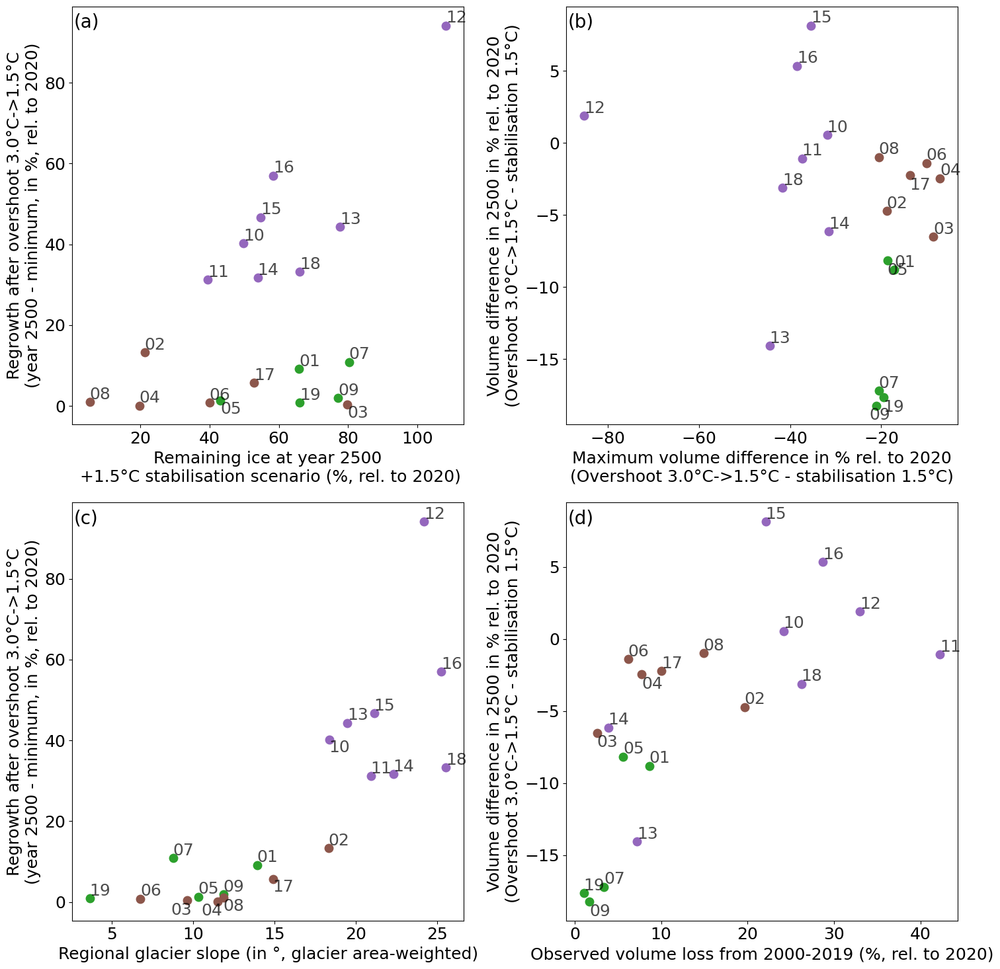

In [340]:
def plotlabel(xvar, yvar, label, ax=None):
    ax.text(xvar-0.01, yvar+0.7, label, alpha=0.7, fontsize=18)
def plotlabel_b(xvar, yvar, label, ax=None):
    ax.text(xvar-0.01, yvar-3.2, label, alpha=0.7, fontsize=18)
def plotlabel_c(xvar, yvar, label, ax=None):
    ax.text(xvar-1.5, yvar-3.5, label, alpha=0.7, fontsize=18)
    

    
def plotlabel_d(xvar, yvar, label, ax=None):
    ax.text(xvar-0.01, yvar+0.2, label, alpha=0.7, fontsize=18)
def plotlabel_bd(xvar, yvar, label, ax=None):
    ax.text(xvar-0.01, yvar-1, label, alpha=0.7, fontsize=18)
def plotlabel_cd(xvar, yvar, label, ax=None):
    ax.text(xvar-1.5, yvar-1, label, alpha=0.7, fontsize=18)
    
fig, axs = plt.subplots(2,2,figsize=(15,15))
axs = axs.flatten()
plt.rc('font', size=18)  

#ax = axs[0] #ax3b


ax= axs[0] #ax4b
pd_t = pd.DataFrame([end_vol_stabT15,end_vol_oversh-min_vol_oversh]).T
pd_t['region'] = df_scenario_common_vol_rel_sel.rgi_reg
pd_t.index = pd_t.region

for c in np.arange(0,6,1):
    rgi_regs_sel = pd_clusters_all.loc[pd_clusters_all[f'kmeans_{k}clusters_diff_oversh']==c].index.values
    pd_t_sel = pd_t.loc[rgi_regs_sel]
    ax.plot(pd_t_sel[0], pd_t_sel[1],'o', ms=9, color=cols[c])
#plt.plot(end_vol_stabT15, end_vol_oversh-min_vol_oversh,'o')

drops = ['03','05']
pd_t.drop(drops).apply(lambda x: plotlabel(x[0],x[1], x.region, ax=ax), axis=1)
pd_t.loc[drops].apply(lambda x: plotlabel_b(x[0],x[1], x.region, ax=ax), axis=1)
ax.set_xlabel('Remaining ice at year 2500\n +1.5°C stabilisation scenario (%, rel. to 2020)', fontsize=18)
ax.set_ylabel('Regrowth after overshoot 3.0°C->1.5°C\n(year 2500 - minimum, in %, rel. to 2020)', fontsize=18)


ax = axs[1] #ax5b
#ax.set_title('Remaining ice difference, % rel. to 2020:\nOvershoot 3.0°C->1.5°C - Stabilisation 1.5°C', fontsize=18)
pd_t = pd.DataFrame([-max_vol_rel_diff_stab_oversh, -end_vol_rel_diff_stab_oversh]).T
pd_t['region'] = df_scenario_common_vol_rel_sel.rgi_reg
pd_t.index = pd_t.region

    
for c in np.arange(0,6,1):
    rgi_regs_sel = pd_clusters_all.loc[pd_clusters_all[f'kmeans_{k}clusters_diff_oversh']==c].index.values
    pd_t_sel = pd_t.loc[rgi_regs_sel]
    ax.plot(pd_t_sel[0], pd_t_sel[1],'o', ms=9, color=cols[c])
drops = ['09','19','17','05']
pd_t.drop(drops).apply(lambda x: plotlabel_d(x[0],x[1], x.region, ax=ax), axis=1)
pd_t.loc[['19','17','05']].apply(lambda x: plotlabel_bd(x[0],x[1], x.region, ax=ax), axis=1)
pd_t.loc[['09']].apply(lambda x: plotlabel_cd(x[0],x[1], x.region, ax=ax), axis=1)

ax.set_ylabel('Volume difference in 2500 in % rel. to 2020\n(Overshoot 3.0°C->1.5°C - stabilisation 1.5°C)', fontsize=18)
ax.set_xlabel('Maximum volume difference in % rel. to 2020\n(Overshoot 3.0°C->1.5°C - stabilisation 1.5°C)', fontsize=18)

#ax.set_xlabel('Difference at year 2500', fontsize=18)
#ax.set_ylabel('Maximum difference', fontsize=18)




#### some regional characteristics added 

ax = axs[2] #ax5b
xx = 'slope_weighted_area_avg'
yy = 'regrowth_overshoot_study'

def plotlabel_cc(xvar, yvar, label, ax=None):
    ax.text(xvar-1, yvar-3.5, label, alpha=0.7, fontsize=18)
    
for c in np.arange(0,6,1):
    rgi_regs_sel = pd_clusters_all.loc[pd_clusters_all[f'kmeans_{k}clusters_diff_oversh']==c].index.values
    pd_t_sel = pd_gmip3_stats.loc[rgi_regs_sel]
    ax.plot(pd_t_sel[xx], pd_t_sel[yy],'o', ms=9, color=cols[c])
drops = ['03','04','17','10','08']
pd_gmip3_stats.drop(drops).apply(lambda x: plotlabel(x[xx],x[yy], x.region, ax=ax), axis=1)
pd_gmip3_stats.loc[['17','10','08']].apply(lambda x: plotlabel_b(x[xx],x[yy], x.region, ax=ax), axis=1)
pd_gmip3_stats.loc[['03','04']].apply(lambda x: plotlabel_cc(x[xx],x[yy], x.region, ax=ax), axis=1)

ax.set_ylabel('Regrowth after overshoot 3.0°C->1.5°C\n(year 2500 - minimum, in %, rel. to 2020)', fontsize=18)
ax.set_xlabel('Regional glacier slope (in °, glacier area-weighted)')



ax = axs[3]


xx = '20yr_regional_dvol_dt_2000_2019_vs_2020_vol_%'
yy = 'diff_yr_2500_overshoot_study'

for c in np.arange(0,6,1):
    rgi_regs_sel = pd_clusters_all.loc[pd_clusters_all[f'kmeans_{k}clusters_diff_oversh']==c].index.values
    pd_t_sel = pd_gmip3_stats.loc[rgi_regs_sel]
    ax.plot(pd_t_sel[xx], pd_t_sel[yy],'o', ms=9, color=cols[c])
drops = ['03','04','09'] #,'10','08']
pd_gmip3_stats.drop(drops).apply(lambda x: plotlabel_d(x[xx],x[yy], x.region, ax=ax), axis=1)
pd_gmip3_stats.loc[drops].apply(lambda x: plotlabel_bd(x[xx],x[yy], x.region, ax=ax), axis=1)

ax.set_ylabel('Volume difference in 2500 in % rel. to 2020\n(Overshoot 3.0°C->1.5°C - stabilisation 1.5°C)', fontsize=18)
ax.set_xlabel('Observed volume loss from 2000-2019 (%, rel. to 2020)')

num_text_x = 0.005
for j,axi in enumerate(axs):
    num_text_y = 0.95
    axi.text(num_text_x, num_text_y,
             num_dict[j], fontsize=20, transform=axi.transAxes)

plt.tight_layout()

plt.savefig('worldmap_appendix_subplot_2024-01-12.png')

/home/users/lschuster/.local/lib/python3.10/site-packages/scipy/stats/_stats_py.py:110: RuntimeWarning: The input array could not be properly checked for nan values. nan values will be ignored.
  warnings.warn("The input array could not be properly "


<AxesSubplot:title={'center':'spearman rank'}>

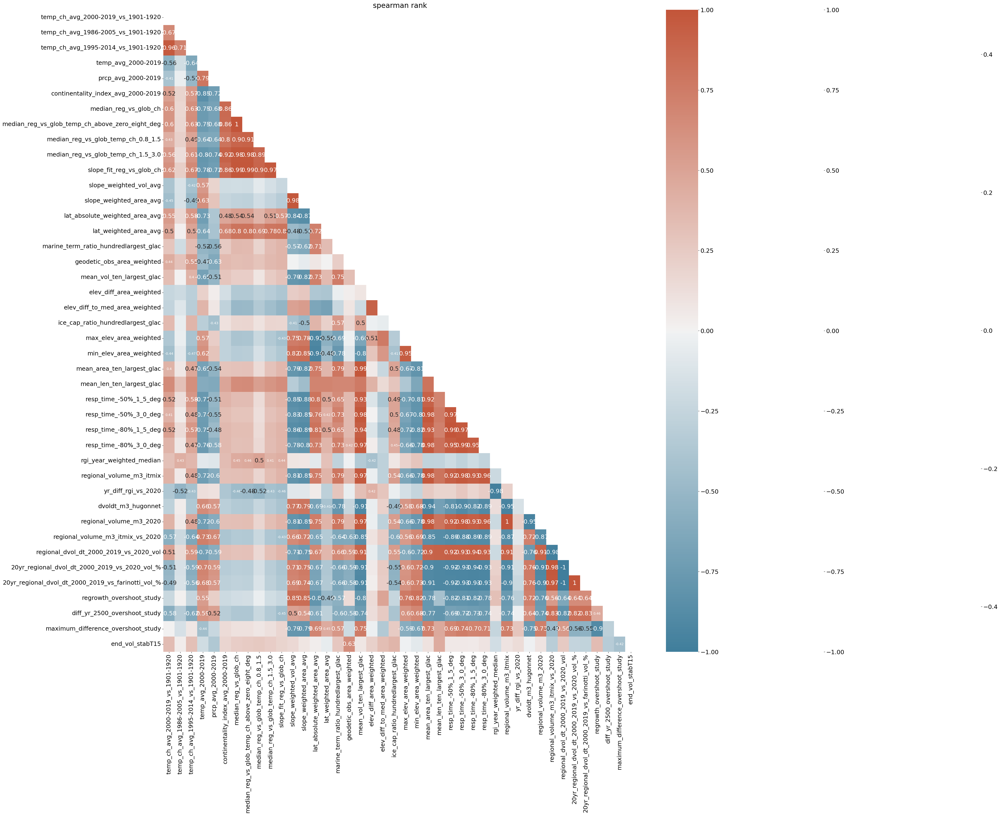

In [311]:
#Correlation between different variables
#
from scipy.stats import pearsonr, spearmanr

df_sel = pd_gmip3_stats.iloc[2:].reset_index(drop=True)#[columns_sel3]
corr = df_sel.corr(method='spearman') # df_sel.corr()
#
# Set up the matplotlib plot configuration
#
f, ax = plt.subplots(figsize=(50, 35))
#
plt.title('spearman rank')
# Generate a mask for upper traingle
#
mask = np.triu(np.ones_like(corr, dtype=bool))
#
# Configure a custom diverging colormap
#
cmap = sns.diverging_palette(230, 20, as_cmap=True)
#
# Draw the heatmap
#
# Create an empty matrix to store p-values
num_cols = len(df_sel.columns)
p_values = np.zeros((num_cols, num_cols))

# Calculate p-values for each pair of columns
for i, col1 in enumerate(df_sel.columns):
    for j, col2 in enumerate(df_sel.columns):
        corr_coef, p_value = spearmanr(df_sel[col1], df_sel[col2])
        p_values[i][j] = p_value

# Convert the matrix to a DataFrame for better visualization
p_values_df = pd.DataFrame(p_values, columns=df_sel.columns, index=df_sel.columns)

sns.heatmap(corr[(p_values_df<0.1)&(p_values_df>=0.05)],annot=True, mask = mask, cmap=cmap, annot_kws={'fontsize':10}, alpha =0)
sns.heatmap(corr[p_values_df<0.05],annot=True, mask = mask, cmap=cmap, annot_kws={'fontsize':18}, alpha =0)
sns.heatmap(corr, annot=False, mask = mask, cmap=cmap)


In [ ]:
plt.plot(pd_gmip3_stats['resp_time_-80%_1_5_deg'],pd_gmip3_stats['regrowth_overshoot_study'], '.')
plt.ylabel('Regrowth after overshoot 3.0°C->1.5°C\n(year 2500 - minimum, in %, rel. to 2020)', fontsize=18)
plt.xlabel('Years when 80% of change occurs (GlacierMIP3)')


In [294]:
spearmanr(pd_gmip3_stats[['geodetic_obs_area_weighted','end_vol_stabT15']].dropna()['geodetic_obs_area_weighted'],
        pd_gmip3_stats[['geodetic_obs_area_weighted','end_vol_stabT15']].dropna()['end_vol_stabT15'])

SpearmanrResult(correlation=0.5736842105263157, pvalue=0.010222581046377573)

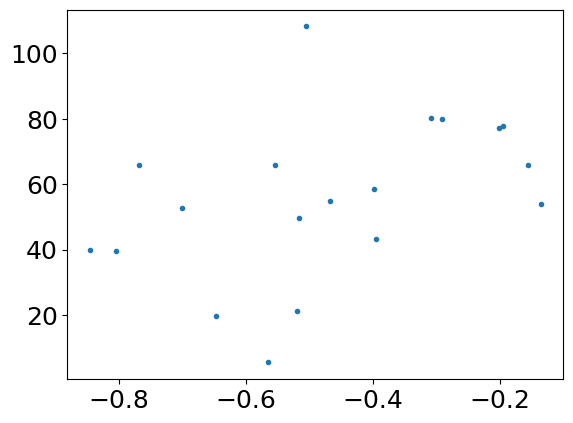

In [289]:
plt.plot(pd_gmip3_stats['geodetic_obs_area_weighted'],pd_gmip3_stats['end_vol_stabT15'], '.')


#  LET'S  now go more crazy ... 

**Now, let's cluster after 8 characteristics in total**

- summary: it does not seem to work better ... 

In [ ]:
pd_t = pd.DataFrame([temp_ch_diff_oversh_stab_max,max_vol_rel_diff_stab_oversh]).T
pd_t['region'] = df_scenario_common_vol_rel_sel.rgi_reg
def plotlabel(xvar, yvar, label, ax=None):
    ax = plt.gca()
    ax.text(xvar-0.01, yvar+0.05, label, alpha=0.7, fontsize=14)
for j, temp_ch in enumerate(temp_ch_diff_oversh_stab_max): #p.arange(0,6,1):
    plt.plot(temp_ch, pd_t[1][j],'o', color=cmap(scaler.transform(temp_ch.reshape(-1,1))))
pd_t.apply(lambda x: plotlabel(x[0],x[1], x.region, ax=ax), axis=1)
plt.xlabel('Maximum regional temp. difference (overshoot-stab)')
plt.ylabel('Maximum difference (%, rel. to 2020)\n(Stabilisation - overshoot 3.0°C->1.5°C scenario)')

In [ ]:
data_all = np.array([end_vol_rel_diff_stab_oversh, 
                     max_vol_rel_diff_stab_oversh,
                     end_vol_oversh, # otherwise the final end volume has too much weight?
                     min_vol_oversh,
                     temp_ch_oversh_max,
                     temp_ch_oversh_end,
                     temp_ch_diff_oversh_stab_end,
                     temp_ch_diff_oversh_stab_max
                    ])
data_only_vol = np.array([max_vol_rel_diff_stab_oversh-end_vol_rel_diff_stab_oversh,
                     end_vol_oversh, # otherwise the final end volume has too much weight?
                     #min_vol_oversh,
                     #temp_ch_oversh_max,
                     #temp_ch_oversh_end,
                     #temp_ch_diff_oversh_stab_end,
                     #temp_ch_diff_oversh_stab_max
                    ])

In [ ]:
data_all_norm = normalize(data_all, norm='l2')
data_only_vol_norm = normalize(data_only_vol, norm='l2')

#data_all_norm

In [ ]:
# only 4 features (ONLY VOL)
pd_data_all_norm = pd.DataFrame(data_only_vol_norm).T
data_all = pd_data_all_norm # pd_vol_all_diff.values
pregs = pd_vol_all_diff.index

for k in [3,4,5,6]: 
        
    #k = 6  # Number of clusters
    #kmeans = KMeans(n_clusters=k, random_state=42, n_init=30)
    kmeans = KMeans(n_clusters=k,  n_init=100, max_iter=1000)

    labels = ['test']

    #while np.any(labels!=np.array([1, 0, 3, 4, 1, 1, 3, 4, 3, 0, 0, 5, 2, 2, 2, 0, 1, 2, 3])):

    kmeans.fit(data_all)

    # Get the resulting centroids and labels
    centroids = kmeans.cluster_centers_
    labels = kmeans.labels_

    # Print the resulting centroids and labels
    print("Centroids:")
    print(centroids)
    print("Labels:")
    print(labels)

    #pd_clusters_all = pd.DataFrame(index=pregs)
    pd_clusters_all[f'kmeans_{k}clusters_4features_only_vol'] = labels

    pd_clusters_all
    
for k in [3,4,5,6]: 
    for s,p in zip(scenarios,palette):
        if s=='oversh_T30OS15':
            c_o = p
        elif s == 'stab_T15':
            c_s = p
    plt.figure(figsize=(24,12))
    for c in np.arange(0,6,1):
        plt.subplot(2,3,c+1)
        rgi_regs_sel = pd_clusters_all.loc[pd_clusters_all[f'kmeans_{k}clusters_4features_only_vol']==c].index.values
        init_sel_sum = _df_scenario_common_rgi_reg.volume.sel(time=2020).sel(rgi_reg = rgi_regs_sel).sum(dim='rgi_reg')
        _sel = df_scenario_common_rgi_reg.volume.sel(rgi_reg=rgi_regs_sel)
        #print(c, _sel.rgi_reg.values)
        plt.title([c, _sel.rgi_reg.values], fontsize=12)
        df_scenario_common_cluster = _sel.sum(dim='rgi_reg')
        df_scenario_common_cluster_rel = 100*df_scenario_common_cluster/init_sel_sum
        for s in color_scenario_poster.keys(): 
            plt.plot(df_scenario_common_cluster_rel.time, df_scenario_common_cluster_rel.sel(scenario=s).squeeze(), color=color_scenario_poster[s],
                    lw=2)    
        plt.ylim([-2,130])

In [ ]:
# all 8 features
pd_data_all_norm = pd.DataFrame(data_all_norm).T
data_all = pd_data_all_norm # pd_vol_all_diff.values
pregs = pd_vol_all_diff.index

for k in [3,4,5,6]: 
        
    #k = 6  # Number of clusters
    #kmeans = KMeans(n_clusters=k, random_state=42, n_init=30)
    kmeans = KMeans(n_clusters=k,  n_init=100, max_iter=1000)

    labels = ['test']

    #while np.any(labels!=np.array([1, 0, 3, 4, 1, 1, 3, 4, 3, 0, 0, 5, 2, 2, 2, 0, 1, 2, 3])):

    kmeans.fit(data_all)

    # Get the resulting centroids and labels
    centroids = kmeans.cluster_centers_
    labels = kmeans.labels_

    # Print the resulting centroids and labels
    print("Centroids:")
    print(centroids)
    print("Labels:")
    print(labels)

    #pd_clusters_all = pd.DataFrame(index=pregs)
    pd_clusters_all[f'kmeans_{k}clusters_8features'] = labels

    pd_clusters_all
    
for k in [3,4,5,6]: 
    for s,p in zip(scenarios,palette):
        if s=='oversh_T30OS15':
            c_o = p
        elif s == 'stab_T15':
            c_s = p
    plt.figure(figsize=(24,12))
    for c in np.arange(0,6,1):
        plt.subplot(2,3,c+1)
        rgi_regs_sel = pd_clusters_all.loc[pd_clusters_all[f'kmeans_{k}clusters_8features']==c].index.values
        init_sel_sum = _df_scenario_common_rgi_reg.volume.sel(time=2020).sel(rgi_reg = rgi_regs_sel).sum(dim='rgi_reg')
        _sel = df_scenario_common_rgi_reg.volume.sel(rgi_reg=rgi_regs_sel)
        #print(c, _sel.rgi_reg.values)
        plt.title([c, _sel.rgi_reg.values], fontsize=12)
        df_scenario_common_cluster = _sel.sum(dim='rgi_reg')
        df_scenario_common_cluster_rel = 100*df_scenario_common_cluster/init_sel_sum
        for s in color_scenario_poster.keys(): 
            plt.plot(df_scenario_common_cluster_rel.time, df_scenario_common_cluster_rel.sel(scenario=s).squeeze(), color=color_scenario_poster[s],
                    lw=2)    
        plt.ylim([-2,130])

# MAPS

In [15]:
#plt.rc('font', size=14)
df_scenario_common = df_scenario_common_rgi_reg
for k in [3,4,5,6]: 
    for b,c in zip(pd_clusters_all.index, pd_clusters_all[f'kmeans_{k}clusters{normadd}'].values):
        df_rgi6g.loc[df_rgi6g.O1Region==b,f'kmeans_{k}clusters'] = c
        
for k in [3,4,5,6]: 
    for b,c in zip(pd_clusters_all.index, pd_clusters_all[f'kmeans_{k}clusters_diff_oversh'].values):
        df_rgi6g.loc[df_rgi6g.O1Region==b,f'kmeans_{k}clusters_diff_oversh'] = c
        
for k in [3,4,5,6]: 
    for b,c in zip(pd_clusters_all.index, pd_clusters_all[f'kmeans_{k}clusters_8features'].values):
        df_rgi6g.loc[df_rgi6g.O1Region==b, f'kmeans_{k}clusters_8features'] = c

#%% ----- FIGURE: GLOBAL COMBINED -----
add_rgi_glaciers = True
add_rgi_regions = True
for k in [3,4,5,6]: 
    for clustering_opt in [f'kmeans_{k}clusters', f'kmeans_{k}clusters_diff_oversh', f'kmeans_{k}clusters_8features']:
        pie_scenarios = [2]
        for pie_scenario in pie_scenarios:

            fig = plt.figure() #figsize=(20,8))
            # Add background image
            ax_background = fig.add_axes([0.36,0.3,0.64,0.4], projection=ccrs.Robinson())
            ax_background.patch.set_facecolor('lightblue')
            ax_background.get_yaxis().set_visible(False)
            ax_background.get_xaxis().set_visible(False)
        #    ax_background.coastlines(color='white')
            ax_background.add_feature(cartopy.feature.LAND, color='white')

            # Add global boundary
            ax_global_patch = fig.add_axes([0.01,0.305,0.395,0.40], facecolor='white')
            ax_global_patch.get_yaxis().set_visible(False)
            ax_global_patch.get_xaxis().set_visible(False)

            # Add RGI glacier outlines
            cols = ['C2','C4','C5','C8','C9','C6']

            if add_rgi_glaciers:
                # if I do that here: 
                # **somehow only the glaicers of one RGI region are visible**
                #shape_feature = ShapelyFeature(Reader(rgi_shp_fn).geometries(), ccrs.Robinson(),alpha=1,facecolor='indigo',linewidth=0.35,edgecolor='indigo')
                #ax_background.add_feature(shape_feature)
                # instead aplly that here ... 
                for c in np.arange(0,6,1):
                    df_rgi6g_sel = df_rgi6g.loc[df_rgi6g[clustering_opt]==c]
                    ax_background.scatter(df_rgi6g_sel.CenLon.values, df_rgi6g_sel.CenLat.values,
                                          color=cols[c],
                                          #color='lightgrey',
                                          s=0.3, alpha =0.5,
                                          transform=ccrs.PlateCarree());
            reg_pie_sizes=[]
            for c in np.arange(0,k,1):
                pie_size = 0.25
                reg_pie_sizes.append(pie_size)
            fac=0.95
            axgb = fig.add_axes([0.085,0.37,reg_pie_sizes[0],reg_pie_sizes[0]*fac], facecolor='white') # 0.01 
            ax0b = fig.add_axes([0.05,0.74,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')

            ax1b = fig.add_axes([0.38,0.74,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')

            ax2b = fig.add_axes([0.71,0.74,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')    
            ax3b = fig.add_axes([0.05,0.04,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')
            ax4b = fig.add_axes([0.38,0.04,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')
            ax5b = fig.add_axes([0.71,0.04,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')

            # all 
            ax = axgb
            _sel = df_scenario_common.volume
            #ax.set_title('Globally', color='Black')
            df_scenario_common_cluster = _sel.sum(dim='rgi_reg')
            df_scenario_common_cluster_rel = 100*df_scenario_common_cluster/df_scenario_common_cluster.sel(time=2020)
            for s in color_scenario_poster.keys(): 
                ax.plot(df_scenario_common_cluster_rel.time, df_scenario_common_cluster_rel.sel(scenario=s).squeeze(), color=color_scenario_poster[s],
                        lw=2, label=label_scenario[s]) 
            leg = ax.legend(loc='lower right', bbox_to_anchor=(1.3,1), fontsize=8)
            ax.set_ylim([0,115])
            ax.set_ylabel('Remaining ice (%, rel. to 2020)    ',fontweight='bold')
            ax.set_xlabel('Year',fontweight='bold')
            ax.text(2490,112, 'Globally' , va='top', fontsize=10, ha='right', color=f'Black',
                   backgroundcolor='silver', fontweight='bold')
            ax.set_title('(g)                                       ', fontsize=11)

            # global temperature 
            for axis in 'left', 'bottom':
                ax.spines[axis].set_linewidth(1.5)

            # set the parameters for both axis: label size in font points, the line tick line 
            # width and length in pixels
            ax.tick_params(axis='both', which='major', width=2, length=4)
            ax2 = ax.twinx()  
            for scenario in color_scenario_poster.keys():
                pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
                pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == 'global_glacier']
                pd_clim_scenario_g.index = pd_clim_scenario_g.year
                # this is approximately correct
                temp_ref_g = pd_clim_scenario_g.loc[2009][['temp_20yr_avg']].mean()
                var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

                ax2.plot(pd_clim_scenario_g.year,
                         var_g_to_ref,
                         alpha = 0.6, 
                         ls = '--',
                         lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
            ax2.set_yticks(ticks=[0,1,2,3,4],
                           labels=[0,1,2,3,4], alpha=0.6)
            ax2.set_ylim([-0.99,4.2]);

            #plt.setp(
            #ax2.get_yticklabels(), visible=False, fontsize=1)
            ax.set_xlim([2000,2500])
            ax2.set_xlim([2000,2500])
            ax2.tick_params(axis='both', which='major', width=1, length=4, grid_alpha =0.6)
            ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
            ax2.set_ylabel(r'$\Delta$T'+'(°C) rel. to 2000-2019\n(glacier-area weighted)',
                                  alpha = 0.6)


            ### add legends
            handles, labels = ax.get_legend_handles_labels()

            handles_2, labels_2 = ax2.get_legend_handles_labels()
            leg2 = ax.legend([handles[0], handles_2[0]], ['Glacier Ice (left)',
                                                          'Temperature change\n(right, 20-yr avg.)'],
                             loc='lower left', ncol=1, fontsize=8, bbox_to_anchor=(-0.26,1.1))
            leg2.get_lines()[0].set_linewidth(2)
            leg2.get_lines()[1].set_linewidth(1)
            for l in leg2.get_lines():
                l.set_color('black')
            ax.add_artist(leg)


            ################################## REGIONAL
            texts = ['medium regrowth, medium loss', 'fast response, large loss',
                      r'fast regrowth, highest $\Delta$T sensitivity',
                 r'fastest regrowth, medium loss', #high $\Delta$T sensitivity', 'slow response, medium loss',
                     '..., large loss', r'fast regrowth, highest $\Delta$T sensitivity'
                 #'no regional temp. overshoot'
                    ]
            nums = ['(b)','(d)','(f)','(a)','(e)','(c)']
            for c,ax in enumerate([ax1b,ax3b, ax5b, ax0b,ax4b,ax2b][:k]):
                _sel = df_scenario_common.volume.sel(rgi_reg=pd_clusters_all.loc[pd_clusters_all[clustering_opt]==c].index.values)
                print(c, _sel.rgi_reg.values)
                #ax.set_title(c, color=f'C{c}')
                df_scenario_common_cluster = _sel.sum(dim='rgi_reg')
                df_scenario_common_cluster_rel = 100*df_scenario_common_cluster/df_scenario_common_cluster.sel(time=2020)
                for s in color_scenario_poster.keys(): 
                    ax.plot(df_scenario_common_cluster_rel.time, df_scenario_common_cluster_rel.sel(scenario=s).squeeze(),
                            color=color_scenario_poster[s],
                            lw=2) 
                ax.set_title(nums[c]) #+' '+ texts[c], fontsize=11)
                delta=0
                tt = ''
                rgi_regs_temp=[]
                for p in _sel.rgi_reg.values:
                    t = d_reg_num_name[p]
                    if tt !='':
                        tt = tt + '\n' +t
                    else:
                        tt=t

                    #shape_feature = ShapelyFeature(geo, ccrs.PlateCarree(), facecolor="None", edgecolor=cols[c], lw=2)
                    #ax_background.add_feature(shape_feature)

                    shape_feature = ShapelyFeature(Reader(rgi_regions_fn).geometries(), ccrs.Robinson(),facecolor="None", edgecolor='grey', alpha = 1, lw=0.4)
                                                   #alpha=1,facecolor='None',linewidth=0.35,edgecolor='k')
                    ax_background.add_feature(shape_feature)
                    label_rgi_reg = False
                    if label_rgi_reg:
                        # TODO
                        geo = gdf.loc[gdf.provide_id == p]['geometry'].values
                        max_x = gdf.loc[gdf.provide_id == p]['max_x'].values[0]
                        max_y = gdf.loc[gdf.provide_id == p]['max_y'].values[0]
                        print(max_x,max_x)
                        if p in ['P13','P02','P01','P03', 'P05']:
                            ax_background.text(max_x-30,max_y-1, p, va='top', ha='right',
                               transform=ccrs.PlateCarree(),
                               fontsize=8, fontweight='bold') #, backgroundcolor=cols[c]) #, edgecolor=cols[c] )
                        elif p == 'P06':
                            ax_background.text(179,max_y-1, p, va='top', ha='right',
                               transform=ccrs.PlateCarree(),
                               fontsize=8, fontweight='bold')
                        else:
                            ax_background.text(max_x-3,max_y-1, p, va='top', ha='right',
                                               transform=ccrs.PlateCarree(),
                                               fontsize=8, fontweight='bold') #, backgroundcolor=cols[c]) #, edgecolor=cols[c] )

                    rgi_regs_temp.append(f'RGI{p}_glacier')

                init = df_scenario_common_cluster.isel(time=0).mean() # all 8 scenarios are anyways equal
                init_all = df_scenario_common.isel(time=0).sum(dim='rgi_reg').volume.mean()
                perc_init = np.round(100*init/init_all,2).values
                print(perc_init)
                #tt = tt + f'\n{perc_init}% initially rel. to global' 
                tt = f'{perc_init}% initially rel. to global' 

                if cols[c] =='C8':
                    bc = 'grey'
                else:
                    bc='silver'
                if c in [1,2,3,4]:
                    if c==4:
                        fs=7
                    else:
                        fs=7
                    ax.text(2015,5, tt , va='bottom', fontsize=fs, ha='left', color=cols[c], backgroundcolor=bc, fontweight='bold', zorder=0)
                else:
                    ax.text(2490,112, tt , va='top', fontsize=7, ha='right', color=cols[c], backgroundcolor=bc, fontweight='bold')
                ax.set_ylim([0,115])
                ax.set_xlim([2000,2500])
                ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
                for axis in 'left', 'bottom':
                    ax.spines[axis].set_linewidth(1.5)
                ax.tick_params(axis='both', which='major', width=2, length=4)

                ### regional glacier-area weighted temp. change 
                if len(rgi_regs_temp) == 1:
                    pd_clim_all_r = pd_clim_all.loc[pd_clim_all.region == f'RGI{p}_glacier']
                else :
                    condis = np.repeat(False, len(pd_clim_all.region))
                    # should be in one of the basins 
                    for r in rgi_regs_temp:
                        condis = condis | (pd_clim_all.region == r) 
                    assert len(rgi_regs_temp)*len(pd_clim_all.scenario.unique())*len(pd_clim_all.year.unique()) == len(pd_clim_all[condis])
                    pd_clim_all_r = pd_clim_all.loc[condis].groupby(['scenario', 'year'])[['temp_20yr_avg', 
                                                                                           'area']].apply(lambda x: np.average(x['temp_20yr_avg'], weights=x['area'])).dropna().reset_index()
                    pd_clim_all_r['temp_20yr_avg'] = pd_clim_all_r[0].values

                ax2 = ax.twinx()  
                for scenario in color_scenario_poster.keys():
                    pd_clim_scenario_g = pd_clim_all_r.loc[pd_clim_all_r.scenario==scenario]
                    pd_clim_scenario_g.index = pd_clim_scenario_g.year
                    # this is approximately correct .. 
                    temp_ref_g = pd_clim_scenario_g.loc[2009][['temp_20yr_avg']].mean()
                    var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

                    ax2.plot(pd_clim_scenario_g.year,
                             var_g_to_ref,
                             alpha = 0.6, 
                             ls = '--',
                             lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
                ax2.set_ylabel('')
                ax2.set_yticks(ticks=[0,1,2,3,4],
                               labels=[0,1,2,3,4], alpha=0.6)
                ax2.set_ylim([-0.99,4.2]);
                ax2.set_xlim([2000,2500])
                ax2.tick_params(axis='both', which='major', width=1, length=4, grid_alpha =0.6)
                if nums[c] in ['(c)','(f)']:
                    pass
                else:
                    plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

        #plt.savefig('2x_worldmap_cluster_volume_v0.png')
        #plt.savefig('figures/2x_worldmap_cluster_volume_v0.png')
        fig.set_size_inches(8.8, 8)
        if 'diff_oversh' in cluster_opt:
            clustering_opt_add = f'{clustering_opt}_12_merged_to_11_cluster'
        else:
            clustering_opt_add = clustering_opt
        fig.savefig(f'2x_worldmap_cluster_volume_rgi_reg_{clustering_opt}_v1.png', dpi=300)

KeyError: 'kmeans_3clusters_8features'

## For the Appendix --> RGI regions 

In [118]:
df_scenario = xr.open_dataset(f'common_running_sum_all_rgi_reg_oversh_stab_2000_2500_bc_1980_2019.nc')


In [130]:
color_scenario_all_oversh = {'stab_T12': (0.5803921568627451, 0.5803921568627451, 0.5803921568627451),
 'stab_T15': (0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
 'oversh_T20OS15': (0.33725490196078434,
  0.7058823529411765,
  0.9137254901960784),
 'oversh_T25OS15': (0.8705882352941177,
  0.5607843137254902,
  0.0196078431372549),
 'oversh_T30OS15': (0.8352941176470589, 0.3686274509803922, 0.0),
 'stab_T30': (0.8, 0.47058823529411764, 0.7372549019607844)}
'_all_overshoots'

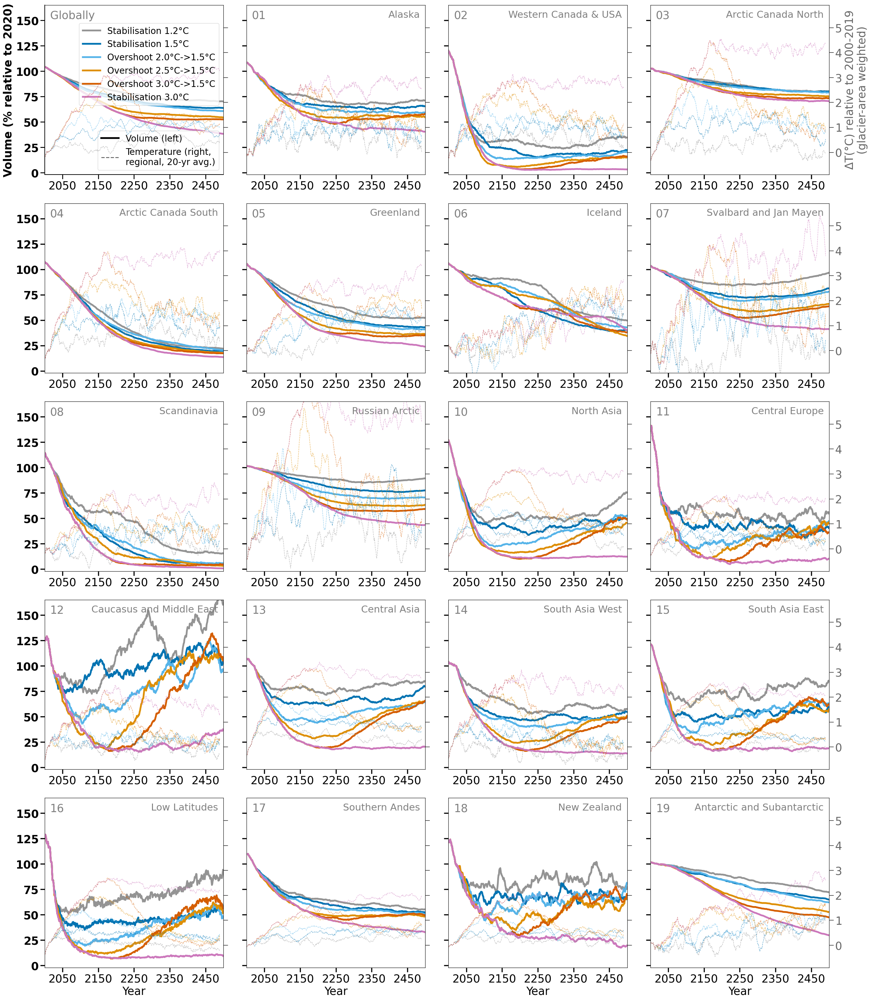

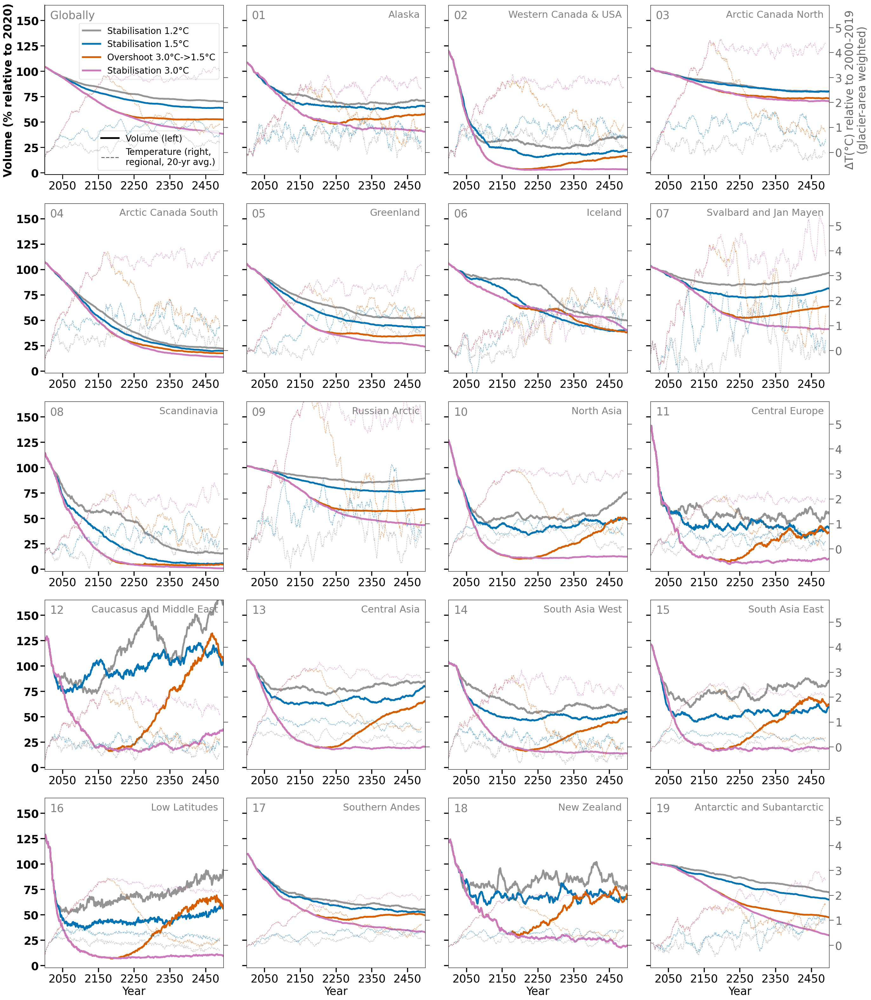

In [131]:
plt.rc('font', size=25)
portrait = True
pd_vol_scenario_rel = (100*df_scenario/df_scenario.sel(time=2020)).volume.to_dataframe('volume_rel_2020_%').reset_index()
df_scenario_glob = df_scenario.sum(dim='rgi_reg')
pd_vol_scenario_glob = (100*df_scenario_glob/df_scenario_glob.sel(time=2020)).volume.to_dataframe('volume_rel_2020_%').reset_index()

for a,color_scenarios in zip(['_all_overshoots', '_poster_iugg'],
                       [color_scenario_all_oversh, color_scenario_poster]):
    scenarios = color_scenarios.keys()
    paletti = list(color_scenarios.values())  
    if portrait:
        plt.figure(figsize=(28,32)) #, sharey=True, sharex=True)
        plt.subplot(5,4,1)
    else:
        plt.figure(figsize=(45,16)) #, sharey=True, sharex=True)
        plt.subplot(2,7,1)
    ax = plt.gca()
    #ax.set_title('Globally')
    plt.text(0.03,0.97, 'Globally',
             transform=ax.transAxes,ha='left',va='top',
             color='grey', fontsize=25)
    ax.set_ylabel('Volume (% relative to 2020)', weight='bold')
    sns.lineplot(data=pd_vol_scenario_glob.loc[pd_vol_scenario_glob.bias_correction=='bc_1980_2019'],
                 hue='scenario', x='time', y= 'volume_rel_2020_%', 
                 palette=paletti,
                 hue_order=scenarios,lw=4, legend=True,
                 ax = ax)
    #ax.set_xlabel('Year')
    #ax.grid(axis='x')
    ax.set_ylim([-2,165]);
    ax.set_yticks(ticks=[0,25,50,75,100,125, 150],
                       labels=[0,25,50,75,100,125, 150], weight='bold')

    for axis in 'left', 'bottom':
        ax.spines[axis].set_linewidth(1.5)

    # set the parameters for both axis: label size in font points, the line tick line 
    # width and length in pixels
    ax.tick_params(axis='both', which='major', width=2, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == 'global_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 0.6, 
                 ls = '--',
                 lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
    ax2.set_ylabel('')
    ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
    ax2.set_ylim([-0.9,5.9]);

    plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
    ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])

    ### add legends
    handles, labels = ax.get_legend_handles_labels()
    ax.get_legend().remove()
    handles_2, labels_2 = ax2.get_legend_handles_labels()
    leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], #title='Scenarios',
                    fontsize=20, title_fontsize=22, bbox_to_anchor=(1,0.92), loc = 'upper right')
    for l in leg.get_lines():
        l.set_linewidth(4)
    leg2 = ax.legend([handles[0], handles_2[0]], ['Volume (left)',
                                                  'Temperature (right,\nregional, 20-yr avg.)'],
                     loc='lower right', ncol=1, fontsize=20)
    leg2.get_lines()[0].set_linewidth(4)
    leg2.get_lines()[1].set_linewidth(2)
    for l in leg2.get_lines():
        l.set_color('black')
    ax.add_artist(leg)


    for j, pi in enumerate(np.arange(1,20,1)):
        if pi<10:
            Preg = f'0{pi}'
        else:
            Preg = f'{pi}'
        if portrait:
            plt.subplot(5,4,j+2)
            x_j = np.arange(3,19,4)
            x2_j = np.arange(2,19,4)
            year_xlabel_condi = j>14

        else:
            plt.subplot(2,7,j+2)
            x_j = [6]
            x2_j = [5,12]
            year_xlabel_condi = j>5
        ax = plt.gca()
        pd_vol_scenario_rel_reg = pd_vol_scenario_rel.loc[pd_vol_scenario_rel.rgi_reg==Preg]
        sns.lineplot(data=pd_vol_scenario_rel_reg.loc[pd_vol_scenario_rel_reg.bias_correction=='bc_1980_2019'],
                     hue='scenario', x='time', y= 'volume_rel_2020_%', 
                     palette=paletti,
                 hue_order=scenarios,lw=4, legend=False,
                 ax = ax)

        #ax.set_title(f'{Preg}')
        plt.text(0.03,0.97, Preg,
                 transform=ax.transAxes,ha='left',va='top',
                 color='grey', fontsize=25)
        plt.text(0.97,0.97, d_reg_num_name[Preg],
                 transform=ax.transAxes,ha='right',va='top',
                 color='grey', fontsize=22)
        ax.set_yticks(ticks=[0,25,50,75,100,125,150],
                       labels=[0,25,50,75,100,125,150], weight='bold')
        if j in x_j:
            #plt.ylabel(f'Volume (% relative to 2020)', weight='bold')
            plt.ylabel('')
            ax.set_yticks(ticks=[0,25,50,75,100,125,150],
                       labels=[0,25,50,75,100,125,150], weight='bold')
        else:
            plt.ylabel('')
            ax.set_yticks(ticks=[0,25,50,75,100,125, 150],
                       labels=[0,25,50,75,100,125, 150], alpha=0, fontsize=1) #visible=False) 
            #plt.setp(ax.get_yticklabels(), visible=False)

        ax.set_ylim([-2,165]);
        ax.tick_params(axis='both', which='major', width=2.5, length=10)
        ax2 = ax.twinx()  
        for scenario in scenarios:
                        #'stab_T30']:

            pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
            pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'RGI{Preg}_glacier']
            pd_clim_scenario_g.index = pd_clim_scenario_g.year
            temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

            ax2.plot(pd_clim_scenario_g.year,
                     var_g_to_ref,
                     alpha = 0.6, 
                     ls = '--',
                     lw=1, color = color_scenario[scenario], label=label_scenario[scenario])

        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
        if j in x2_j:
            if j == 2: 
                ax2.set_ylabel(r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)',
                              alpha = 0.6)
            else:
                ax2.set_ylabel('')
            #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
        else:
            ax2.set_ylabel('')
            #ax2.set_yticks([])
            plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

        ax2.set_ylim([-0.9,5.9]);
        if year_xlabel_condi:
            ax.set_xlabel('Year')
        else:
            ax.set_xlabel('')
        ax.set_xlim([2000,2500])
        ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
        ax2.set_xlim([2000,2500])
        ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)  

    plt.tight_layout()
    if portrait:
        plt.savefig(f'2_rgi_reg_volume_changes_overshoot{a}_{bc}_portrait_4cols.pdf')
        plt.savefig(f'2_rgi_reg_volume_changes_overshoot{a}_{bc}_portrait_4cols.png')

    else:
        plt.savefig(f'2_rgi_reg_volume_changes_overshoot{a}_{bc}.pdf')

### OLD

### 6 clusters 

0 ['P02' 'P05' 'P13']
-58.0 -58.0
128.0 128.0
180.0 180.0
1 ['P06' 'P07' 'P10']
-169.0 -169.0
31.0 31.0
-30.0 -30.0
2 ['P09' 'P12']
128.0 128.0
179.0 179.0
3 ['P01' 'P03' 'P11']
-89.0 -89.0
-10.0 -10.0
-62.0 -62.0
4 ['P08']
54.0 54.0
5 ['P04']
35.0 35.0


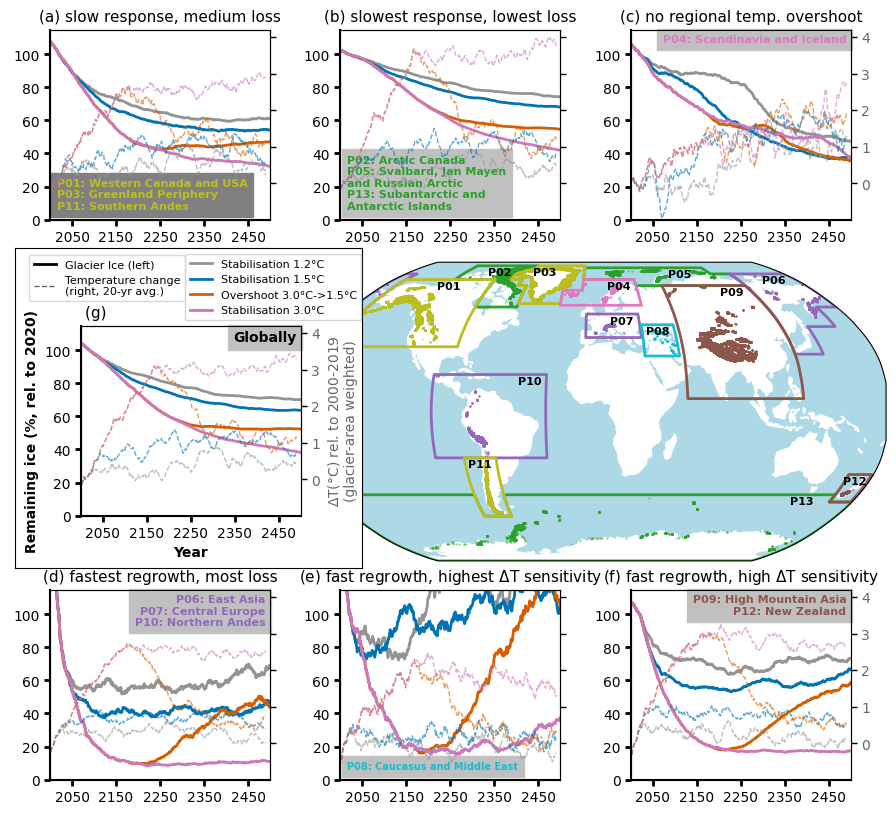

In [304]:
#%% ----- FIGURE: GLOBAL COMBINED -----
add_rgi_glaciers = True
add_rgi_regions = True

pie_scenarios = [2]
for pie_scenario in pie_scenarios:

    fig = plt.figure() #figsize=(20,8))

    # Add background image
    ax_background = fig.add_axes([0.36,0.3,0.64,0.4], projection=ccrs.Robinson())
    ax_background.patch.set_facecolor('lightblue')
    ax_background.get_yaxis().set_visible(False)
    ax_background.get_xaxis().set_visible(False)
#    ax_background.coastlines(color='white')
    ax_background.add_feature(cartopy.feature.LAND, color='white')

    # Add global boundary
    ax_global_patch = fig.add_axes([0.01,0.305,0.395,0.40], facecolor='white')
    ax_global_patch.get_yaxis().set_visible(False)
    ax_global_patch.get_xaxis().set_visible(False)

    # Add RGI glacier outlines
    cols = ['C2','C4','C5','C8','C9','C6']
    
    if add_rgi_glaciers:
        # if I do that here: 
        # **somehow only the glaicers of one RGI region are visible**
        #shape_feature = ShapelyFeature(Reader(rgi_shp_fn).geometries(), ccrs.Robinson(),alpha=1,facecolor='indigo',linewidth=0.35,edgecolor='indigo')
        #ax_background.add_feature(shape_feature)
        # instead aplly that here ... 
        for c in np.arange(0,6,1):
            df_rgi6g_sel = df_rgi6g.loc[df_rgi6g.kmeans_6clusters_all==c]
            ax_background.scatter(df_rgi6g_sel.CenLon.values, df_rgi6g_sel.CenLat.values,
                                  color=cols[c],
                                  #color='lightgrey',
                                  s=0.3, alpha =0.5,
                                  transform=ccrs.PlateCarree());
    if add_rgi_regions:
        shape_feature = ShapelyFeature(Reader(pregs_fn).geometries(), ccrs.Robinson(),alpha=1,facecolor='None',linewidth=0.35,edgecolor='k')
        ax_background.add_feature(shape_feature)
    reg_pie_sizes=[]
    for c in np.arange(0,6,1):
        pie_size = 0.25
        reg_pie_sizes.append(pie_size)
    fac=0.95
    axgb = fig.add_axes([0.085,0.37,reg_pie_sizes[0],reg_pie_sizes[0]*fac], facecolor='white') # 0.01 
    ax0b = fig.add_axes([0.05,0.74,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')
    
    ax1b = fig.add_axes([0.38,0.74,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')
    
    ax2b = fig.add_axes([0.71,0.74,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')    
    ax3b = fig.add_axes([0.05,0.04,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')
    ax4b = fig.add_axes([0.38,0.04,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')
    ax5b = fig.add_axes([0.71,0.04,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')

    # all 
    ax = axgb
    _sel = df_scenario_common.volume
    #ax.set_title('Globally', color='Black')
    df_scenario_common_cluster = _sel.sum(dim='provide_region')
    df_scenario_common_cluster_rel = 100*df_scenario_common_cluster/df_scenario_common_cluster.sel(time=2020)
    for s in color_scenario_poster.keys(): 
        ax.plot(df_scenario_common_cluster_rel.time, df_scenario_common_cluster_rel.sel(scenario=s).squeeze(), color=color_scenario_poster[s],
                lw=2, label=label_scenario[s]) 
    leg = ax.legend(loc='lower right', bbox_to_anchor=(1.3,1), fontsize=8)
    ax.set_ylim([0,115])
    ax.set_ylabel('Remaining ice (%, rel. to 2020)    ',fontweight='bold')
    ax.set_xlabel('Year',fontweight='bold')
    ax.text(2490,112, 'Globally' , va='top', fontsize=10, ha='right', color=f'Black',
           backgroundcolor='silver', fontweight='bold')
    ax.set_title('(g)                                       ', fontsize=11)
    
    # global temperature 
    for axis in 'left', 'bottom':
        ax.spines[axis].set_linewidth(1.5)

    # set the parameters for both axis: label size in font points, the line tick line 
    # width and length in pixels
    ax.tick_params(axis='both', which='major', width=2, length=4)
    ax2 = ax.twinx()  
    for scenario in color_scenario_poster.keys():
        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == 'global_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        # this is approximately correct
        temp_ref_g = pd_clim_scenario_g.loc[2009][['temp_20yr_avg']].mean()
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 0.6, 
                 ls = '--',
                 lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
    ax2.set_yticks(ticks=[0,1,2,3,4],
                   labels=[0,1,2,3,4], alpha=0.6)
    ax2.set_ylim([-0.99,4.2]);

    #plt.setp(
    #ax2.get_yticklabels(), visible=False, fontsize=1)
    ax.set_xlim([2000,2500])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=4, grid_alpha =0.6)
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax2.set_ylabel(r'$\Delta$T'+'(°C) rel. to 2000-2019\n(glacier-area weighted)',
                          alpha = 0.6)
    
    
    ### add legends
    handles, labels = ax.get_legend_handles_labels()

    handles_2, labels_2 = ax2.get_legend_handles_labels()
    leg2 = ax.legend([handles[0], handles_2[0]], ['Glacier Ice (left)',
                                                  'Temperature change\n(right, 20-yr avg.)'],
                     loc='lower left', ncol=1, fontsize=8, bbox_to_anchor=(-0.26,1.1))
    leg2.get_lines()[0].set_linewidth(2)
    leg2.get_lines()[1].set_linewidth(1)
    for l in leg2.get_lines():
        l.set_color('black')
    ax.add_artist(leg)
    
    
    ################################## REGIONAL
    texts = ['slowest response, lowest loss', 'fastest regrowth, most loss',
         r'fast regrowth, high $\Delta$T sensitivity', 'slow response, medium loss',
         r'fast regrowth, highest $\Delta$T sensitivity', 'no regional temp. overshoot']
    nums = ['(b)','(d)','(f)','(a)','(e)','(c)']
    for c,ax in enumerate([ax1b,ax3b, ax5b, ax0b,ax4b,ax2b]):
        _sel = df_scenario_common.volume.sel(provide_region=pd_clusters_all.loc[pd_clusters_all.kmeans_6clusters==c].index.values)
        print(c, _sel.provide_region.values)
        #ax.set_title(c, color=f'C{c}')
        df_scenario_common_cluster = _sel.sum(dim='provide_region')
        df_scenario_common_cluster_rel = 100*df_scenario_common_cluster/df_scenario_common_cluster.sel(time=2020)
        for s in color_scenario_poster.keys(): 
            ax.plot(df_scenario_common_cluster_rel.time, df_scenario_common_cluster_rel.sel(scenario=s).squeeze(),
                    color=color_scenario_poster[s],
                    lw=2) 
        ax.set_title(nums[c]+' '+ texts[c], fontsize=11)
        delta=0
        tt = ''
        pregs_temp=[]
        for p in _sel.provide_region.values:
            t = p+': '+provide_reg_full_name_dict[p]
            if tt !='':
                tt = tt + '\n' +t
            else:
                tt=t
            geo = gdf.loc[gdf.provide_id == p]['geometry'].values
            max_x = gdf.loc[gdf.provide_id == p]['max_x'].values[0]
            max_y = gdf.loc[gdf.provide_id == p]['max_y'].values[0]
            print(max_x,max_x)
            shape_feature = ShapelyFeature(geo, ccrs.PlateCarree(), facecolor="None", edgecolor=cols[c], lw=2)
            ax_background.add_feature(shape_feature)
            if p in ['P13','P02','P01','P03', 'P05']:
                ax_background.text(max_x-30,max_y-1, p, va='top', ha='right',
                   transform=ccrs.PlateCarree(),
                   fontsize=8, fontweight='bold') #, backgroundcolor=cols[c]) #, edgecolor=cols[c] )
            elif p == 'P06':
                ax_background.text(179,max_y-1, p, va='top', ha='right',
                   transform=ccrs.PlateCarree(),
                   fontsize=8, fontweight='bold')
            else:
                ax_background.text(max_x-3,max_y-1, p, va='top', ha='right',
                                   transform=ccrs.PlateCarree(),
                                   fontsize=8, fontweight='bold') #, backgroundcolor=cols[c]) #, edgecolor=cols[c] )
            pregs_temp.append(f'provide_reg_{p}_glacier')
        if cols[c] =='C8':
            bc = 'grey'
        else:
            bc='silver'
        if c in [0,3,4]:
            if c==4:
                fs=7
            else:
                fs=8
            ax.text(2015,5, tt , va='bottom', fontsize=fs, ha='left', color=cols[c], backgroundcolor=bc, fontweight='bold', zorder=0)
        else:
            ax.text(2490,112, tt , va='top', fontsize=8, ha='right', color=cols[c], backgroundcolor=bc, fontweight='bold')
        ax.set_ylim([0,115])
        ax.set_xlim([2000,2500])
        ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
        for axis in 'left', 'bottom':
            ax.spines[axis].set_linewidth(1.5)
        ax.tick_params(axis='both', which='major', width=2, length=4)
        
        ### regional glacier-area weighted temp. change 
        if len(pregs_temp) == 1:
            pd_clim_all_r = pd_clim_all.loc[pd_clim_all.region == f'provide_reg_{p}_glacier']
        else :
            if  len(pregs_temp) == 2:
                condis = (pd_clim_all.region == pregs_temp[0]) | (pd_clim_all.region == pregs_temp[1])
            elif len(pregs_temp)==3:
                condis = (pd_clim_all.region == pregs_temp[0]) | (pd_clim_all.region == pregs_temp[1]) | (pd_clim_all.region == pregs_temp[2])
            else:
                print('NOT implemented')
            pd_clim_all_r = pd_clim_all.loc[condis].groupby(['scenario',
                                             'year'])[['temp_20yr_avg',
                                                       'area']].apply(lambda x: np.average(x['temp_20yr_avg'], weights=x['area'])).dropna().reset_index()
            pd_clim_all_r['temp_20yr_avg'] = pd_clim_all_r[0].values
        ax2 = ax.twinx()  
        for scenario in color_scenario_poster.keys():
            pd_clim_scenario_g = pd_clim_all_r.loc[pd_clim_all_r.scenario==scenario]
            pd_clim_scenario_g.index = pd_clim_scenario_g.year
            # this is approximately correct .. 
            temp_ref_g = pd_clim_scenario_g.loc[2009][['temp_20yr_avg']].mean()
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

            ax2.plot(pd_clim_scenario_g.year,
                     var_g_to_ref,
                     alpha = 0.6, 
                     ls = '--',
                     lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
        ax2.set_ylabel('')
        ax2.set_yticks(ticks=[0,1,2,3,4],
                       labels=[0,1,2,3,4], alpha=0.6)
        ax2.set_ylim([-0.99,4.2]);
        ax2.set_xlim([2000,2500])
        ax2.tick_params(axis='both', which='major', width=1, length=4, grid_alpha =0.6)
        if nums[c] in ['(c)','(f)']:
            pass
        else:
            plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

#plt.savefig('2x_worldmap_cluster_volume_v0.png')
#plt.savefig('figures/2x_worldmap_cluster_volume_v0.png')
fig.set_size_inches(8.8, 8)
fig.savefig('2x_worldmap_cluster_volume_v0_6clusters.png', dpi=100)

0 ['P02' 'P05' 'P13']
-58.0 -58.0
128.0 128.0
180.0 180.0
1 ['P06' 'P07' 'P10']
-169.0 -169.0
31.0 31.0
-30.0 -30.0
2 ['P09' 'P12']
128.0 128.0
179.0 179.0
3 ['P01' 'P03' 'P04' 'P11']
-89.0 -89.0
-10.0 -10.0
35.0 35.0
-62.0 -62.0
4 ['P08']
54.0 54.0


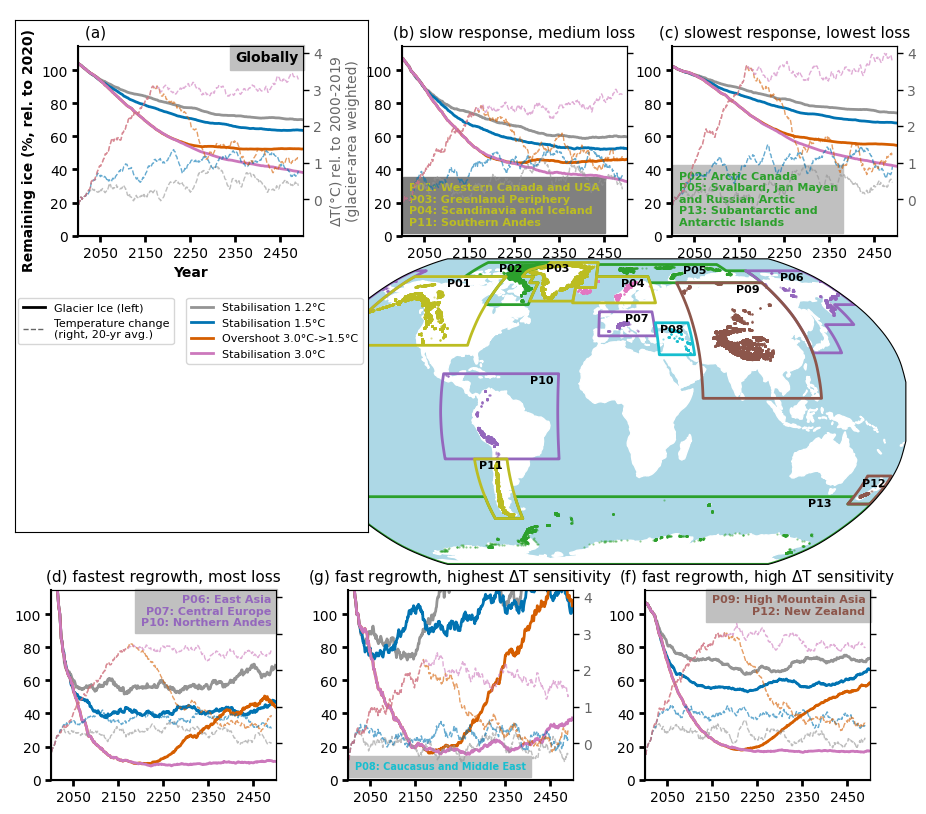

In [333]:
#%% ----- FIGURE: GLOBAL COMBINED -----
add_rgi_glaciers = True
add_rgi_regions = True

pie_scenarios = [2]
for pie_scenario in pie_scenarios:

    fig = plt.figure() #figsize=(20,8))

    # Add background image
    ax_background = fig.add_axes([0.36,0.3,0.64,0.4], projection=ccrs.Robinson())
    ax_background.patch.set_facecolor('lightblue')
    ax_background.get_yaxis().set_visible(False)
    ax_background.get_xaxis().set_visible(False)
#    ax_background.coastlines(color='white')
    ax_background.add_feature(cartopy.feature.LAND, color='white')

    # Add global boundary
    ax_global_patch = fig.add_axes([0.01,0.5,0.39,0.49], facecolor='white')
    ax_global_patch.get_yaxis().set_visible(False)
    ax_global_patch.get_xaxis().set_visible(False)

    # Add RGI glacier outlines
    cols = ['C2','C4','C5','C8','C9','C6']
    
    if add_rgi_glaciers:
        # if I do that here: 
        # **somehow only the glaicers of one RGI region are visible**
        #shape_feature = ShapelyFeature(Reader(rgi_shp_fn).geometries(), ccrs.Robinson(),alpha=1,facecolor='indigo',linewidth=0.35,edgecolor='indigo')
        #ax_background.add_feature(shape_feature)
        # instead aplly that here ... 
        for c in np.arange(0,6,1):
            df_rgi6g_sel = df_rgi6g.loc[df_rgi6g.kmeans_6clusters_all==c]
            ax_background.scatter(df_rgi6g_sel.CenLon.values, df_rgi6g_sel.CenLat.values,
                                  color=cols[c],
                                  #color='lightgrey',
                                  s=0.3, alpha =0.5,
                                  transform=ccrs.PlateCarree());
    if add_rgi_regions:
        shape_feature = ShapelyFeature(Reader(pregs_fn).geometries(), ccrs.Robinson(),alpha=1,facecolor='None',linewidth=0.35,edgecolor='k')
        ax_background.add_feature(shape_feature)
    reg_pie_sizes=[]
    for c in np.arange(0,5,1):
        pie_size = 0.25
        reg_pie_sizes.append(pie_size)
    fac=0.95
    axgb = fig.add_axes([0.08,0.72,reg_pie_sizes[0],reg_pie_sizes[0]*fac], facecolor='white') # 0.01 
    #ax0b = fig.add_axes([0.05,0.74,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')
    
    ax0b = fig.add_axes([0.44,0.72,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')
    
    ax1b = fig.add_axes([0.74,0.72,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')    
    ax3b = fig.add_axes([0.05,0.04,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')
    ax4b = fig.add_axes([0.38,0.04,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')
    ax5b = fig.add_axes([0.71,0.04,reg_pie_sizes[1],reg_pie_sizes[1]*fac], facecolor='white')

    # all 
    ax = axgb
    _sel = df_scenario_common.volume
    #ax.set_title('Globally', color='Black')
    df_scenario_common_cluster = _sel.sum(dim='provide_region')
    df_scenario_common_cluster_rel = 100*df_scenario_common_cluster/df_scenario_common_cluster.sel(time=2020)
    for s in color_scenario_poster.keys(): 
        ax.plot(df_scenario_common_cluster_rel.time, df_scenario_common_cluster_rel.sel(scenario=s).squeeze(), color=color_scenario_poster[s],
                lw=2, label=label_scenario[s]) 
    leg = ax.legend(loc='upper right', bbox_to_anchor=(1.29,-0.3), fontsize=8)
    ax.set_ylim([0,115])
    ax.set_ylabel('Remaining ice (%, rel. to 2020)    ',fontweight='bold')
    ax.set_xlabel('Year',fontweight='bold')
    ax.text(2490,112, 'Globally' , va='top', fontsize=10, ha='right', color=f'Black',
           backgroundcolor='silver', fontweight='bold')
    ax.set_title('(a)                                       ', fontsize=11)
    
    # global temperature 
    for axis in 'left', 'bottom':
        ax.spines[axis].set_linewidth(1.5)

    # set the parameters for both axis: label size in font points, the line tick line 
    # width and length in pixels
    ax.tick_params(axis='both', which='major', width=2, length=4)
    ax2 = ax.twinx()  
    for scenario in color_scenario_poster.keys():
        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == 'global_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        # this is approximately correct
        temp_ref_g = pd_clim_scenario_g.loc[2009][['temp_20yr_avg']].mean()
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 0.6, 
                 ls = '--',
                 lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
    ax2.set_yticks(ticks=[0,1,2,3,4],
                   labels=[0,1,2,3,4], alpha=0.6)
    ax2.set_ylim([-0.99,4.2]);

    #plt.setp(
    #ax2.get_yticklabels(), visible=False, fontsize=1)
    ax.set_xlim([2000,2500])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=4, grid_alpha =0.6)
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax2.set_ylabel(r'$\Delta$T'+'(°C) rel. to 2000-2019\n(glacier-area weighted)',
                          alpha = 0.6)
    
    
    ### add legends
    handles, labels = ax.get_legend_handles_labels()

    handles_2, labels_2 = ax2.get_legend_handles_labels()
    leg2 = ax.legend([handles[0], handles_2[0]], ['Glacier Ice (left)',
                                                  'Temperature change\n(right, 20-yr avg.)'],
                     loc='upper left', ncol=1, fontsize=8, bbox_to_anchor=(-0.29,-0.3))
    leg2.get_lines()[0].set_linewidth(2)
    leg2.get_lines()[1].set_linewidth(1)
    for l in leg2.get_lines():
        l.set_color('black')
    ax.add_artist(leg)
    
    
    ################################## REGIONAL
    texts = ['slowest response, lowest loss  ', 'fastest regrowth, most loss  ',
         r'fast regrowth, high $\Delta$T sensitivity  ', 'slow response, medium loss  ',
         r'fast regrowth, highest $\Delta$T sensitivity'  , 'no regional temp. overshoot  ']
    nums = ['(c)','(d)','(f)','(b)','(g)']
    for c,ax in enumerate([ax1b,ax3b, ax5b, ax0b,ax4b]): #,ax2b]):
        _sel = df_scenario_common.volume.sel(provide_region=pd_clusters_all.loc[pd_clusters_all.kmeans_5clusters==c].index.values)
        print(c, _sel.provide_region.values)
        #ax.set_title(c, color=f'C{c}')
        df_scenario_common_cluster = _sel.sum(dim='provide_region')
        df_scenario_common_cluster_rel = 100*df_scenario_common_cluster/df_scenario_common_cluster.sel(time=2020)
        for s in color_scenario_poster.keys(): 
            ax.plot(df_scenario_common_cluster_rel.time, df_scenario_common_cluster_rel.sel(scenario=s).squeeze(),
                    color=color_scenario_poster[s],
                    lw=2) 
        ax.set_title(nums[c], fontsize=11) #+' '+ texts[c]
        delta=0
        tt = ''
        pregs_temp=[]
        for p in _sel.provide_region.values:
            t = p+': '+provide_reg_full_name_dict[p]
            if tt !='':
                tt = tt + '\n' +t
            else:
                tt=t
            geo = gdf.loc[gdf.provide_id == p]['geometry'].values
            max_x = gdf.loc[gdf.provide_id == p]['max_x'].values[0]
            max_y = gdf.loc[gdf.provide_id == p]['max_y'].values[0]
            print(max_x,max_x)
            shape_feature = ShapelyFeature(geo, ccrs.PlateCarree(), facecolor="None", edgecolor=cols[c], lw=2)
            ax_background.add_feature(shape_feature)
            if p in ['P13','P02','P01','P03', 'P05']:
                ax_background.text(max_x-30,max_y-1, p, va='top', ha='right',
                   transform=ccrs.PlateCarree(),
                   fontsize=8, fontweight='bold') #, backgroundcolor=cols[c]) #, edgecolor=cols[c] )
            elif p == 'P06':
                ax_background.text(179,max_y-1, p, va='top', ha='right',
                   transform=ccrs.PlateCarree(),
                   fontsize=8, fontweight='bold')
            else:
                ax_background.text(max_x-3,max_y-1, p, va='top', ha='right',
                                   transform=ccrs.PlateCarree(),
                                   fontsize=8, fontweight='bold') #, backgroundcolor=cols[c]) #, edgecolor=cols[c] )
            pregs_temp.append(f'provide_reg_{p}_glacier')
        if cols[c] =='C8':
            bc = 'grey'
        else:
            bc='silver'
        if c in [0,3,4]:
            if c==4:
                fs=7
            else:
                fs=8
            ax.text(2015,5, tt , va='bottom', fontsize=fs, ha='left', color=cols[c], backgroundcolor=bc, fontweight='bold', zorder=0)
        else:
            ax.text(2490,112, tt , va='top', fontsize=8, ha='right', color=cols[c], backgroundcolor=bc, fontweight='bold')
        ax.set_ylim([0,115])
        ax.set_xlim([2000,2500])
        ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
        for axis in 'left', 'bottom':
            ax.spines[axis].set_linewidth(1.5)
        ax.tick_params(axis='both', which='major', width=2, length=4)
        
        ### regional glacier-area weighted temp. change 
        if len(pregs_temp) == 1:
            pd_clim_all_r = pd_clim_all.loc[pd_clim_all.region == f'provide_reg_{p}_glacier']
        else :
            if  len(pregs_temp) == 2:
                condis = (pd_clim_all.region == pregs_temp[0]) | (pd_clim_all.region == pregs_temp[1])
            elif len(pregs_temp)==3:
                condis = (pd_clim_all.region == pregs_temp[0]) | (pd_clim_all.region == pregs_temp[1]) | (pd_clim_all.region == pregs_temp[2])
            elif len(pregs_temp)==4:
                condis = (pd_clim_all.region == pregs_temp[0]) | (pd_clim_all.region == pregs_temp[1]) | (pd_clim_all.region == pregs_temp[2]) | (pd_clim_all.region == pregs_temp[3])
            else:
                print('NOT implemented')
            pd_clim_all_r = pd_clim_all.loc[condis].groupby(['scenario',
                                             'year'])[['temp_20yr_avg',
                                                       'area']].apply(lambda x: np.average(x['temp_20yr_avg'], weights=x['area'])).dropna().reset_index()
            pd_clim_all_r['temp_20yr_avg'] = pd_clim_all_r[0].values
        ax2 = ax.twinx()  
        for scenario in color_scenario_poster.keys():
            pd_clim_scenario_g = pd_clim_all_r.loc[pd_clim_all_r.scenario==scenario]
            pd_clim_scenario_g.index = pd_clim_scenario_g.year
            # this is approximately correct .. 
            temp_ref_g = pd_clim_scenario_g.loc[2009][['temp_20yr_avg']].mean()
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

            ax2.plot(pd_clim_scenario_g.year,
                     var_g_to_ref,
                     alpha = 0.6, 
                     ls = '--',
                     lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
        ax2.set_ylabel('')
        ax2.set_yticks(ticks=[0,1,2,3,4],
                       labels=[0,1,2,3,4], alpha=0.6)
        ax2.set_ylim([-0.99,4.2]);
        ax2.set_xlim([2000,2500])
        ax2.tick_params(axis='both', which='major', width=1, length=4, grid_alpha =0.6)
        if nums[c] in ['(c)','(g)']:
            pass
        else:
            plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

#plt.savefig('2x_worldmap_cluster_volume_v0.png')
#plt.savefig('figures/2x_worldmap_cluster_volume_v0.png')
fig.set_size_inches(9, 8)
fig.savefig('2x_worldmap_cluster_volume_v0_5clusters.png', dpi=100)

## OLD

In [ ]:
df_vol_diff = df_scenario_common_vol_rel.sel(scenario = 'oversh_T30OS15') - df_scenario_common_vol_rel.sel(scenario = 'stab_T15')
pd_vol_diff_overshoot = df_vol_diff.to_dataframe().reset_index()
pd_vol_diff_overshoot = pd_vol_diff_overshoot[['provide_region','time','volume']].pivot(index='time', columns='provide_region', values='volume')
pd_vol_diff_overshoot = pd_vol_diff_overshoot.T
data = pd_vol_diff_overshoot.values
pregs = pd_vol_diff_overshoot.index
import sklearn
from sklearn.cluster import KMeans

# do we need to 
#for var in ['a_simple', 'b_simple']:
#    pd_exp_decay_fits_simple_5000[var+'_norm'] = sklearn.preprocessing.normalize([pd_exp_decay_fits_simple_5000[var].values]).squeeze()
#regions = pd_exp_decay_fits_simple_5000.rgi_reg.values
#data = pd_exp_decay_fits_simple_5000[['a_simple_norm', 'b_simple_norm']].values
# Perform K-meansa clustering
k = 6  # Number of clusters
kmeans = KMeans(n_clusters=k)
labels = ['test']

#while np.any(labels!=np.array([[[0, 0, 0, 4, 3, 0, 2, 1, 2, 2, 0, 2, 3]]])):
kmeans.fit(data)

# Get the resulting centroids and labels
centroids = kmeans.cluster_centers_
labels = kmeans.labels_


# Print the resulting centroids and labels
print("Centroids:")
print(centroids)
print("Labels:")
print(labels)

#pd_clusters = pd.DataFrame(index=pregs)
pd_clusters[f'kmeans_{k}clusters'] = labels

pd_clusters

for s,p in zip(scenarios,palette):
    if s=='oversh_T30OS15':
        c_o = p
    elif s == 'stab_T15':
        c_s = p
plt.figure(figsize=(24,12))
for c in np.arange(0,6,1):
    plt.subplot(2,3,c+1)
    _sel = df_scenario_common.volume.sel(provide_region=pd_clusters.loc[pd_clusters.kmeans_6clusters==c].index.values)
    print(c, _sel.provide_region.values)
    plt.title([c, _sel.provide_region.values])
    df_scenario_common_cluster = _sel.sum(dim='provide_region')
    df_scenario_common_cluster_rel = 100*df_scenario_common_cluster/df_scenario_common_cluster.isel(time=0)
    plt.plot(df_scenario_common_cluster_rel.time, df_scenario_common_cluster_rel.sel(scenario='stab_T15').squeeze(), color=c_s)
    plt.plot(df_scenario_common_cluster_rel.time, df_scenario_common_cluster_rel.sel(scenario='oversh_T30OS15').squeeze(), color=c_o)

### OLD (from 2_volume_time_series ..)

In [5]:
## random climate     
pd_working_random_stab = pd.read_csv(f'../random_climate_run_20000years_working_rgis_for_oversh_stab_scenarios{bcs[0]}.csv', index_col='rgiid')
pd_working_random_stab = pd_working_random_stab.loc[all_running_rgis] # take only those that also work for all other scenarios (e.g. also stab_T12)

import json
frgi = utils.file_downloader('https://cluster.klima.uni-bremen.de/~oggm/rgi/rgi62_stats.h5')
#frgi = '/home/users/lschuster/glacierMIP/rgi62_stats.h5'
odf = pd.read_hdf(frgi, index_col=0)
for pi in np.arange(1,14,1):
    f = open('/home/www/lschuster/provide/provide_glacier_regions/rgi_ids_per_provide_region.json')
    if pi<10:
        Preg = f'P0{pi}'
    else:
        Preg = f'P{pi}'
    rgis_basin = json.load(f)[Preg]
    # remove connectivity level 2 glaciers only important for P03 (Greenland)
    rgis_basin = odf.loc[rgis_basin].loc[odf.loc[rgis_basin].Connect <2].index.values
    rgis_basin_w = list(set(rgis_basin).intersection(pd_working_random_stab.index))
    pd_working_random_stab.loc[rgis_basin_w,'provide_reg'] = Preg

load=False
# do the same for the provide regions with runoff 
if load:
    df_scenario_bc_l= []
    for bc in bcs:
        pd_geodetic_running = pd_geodetic.loc[all_running_rgis]
        df = []
        for preg in np.arange(1,14,1):
            if preg < 10:
                Preg = f'P0{preg}'
            else:
                Preg = f'P{preg}'
            print(Preg)
            dpath = f'/home/www/lschuster/provide/gfdl-esm2m_oversh_stab_uni_bern/runs/output/provide_reg/w5e5_gcm_merged_from_2000{bc}'
            # amount of glaciers in that rgi region
            #rgi_reg_glaciers = pd_geodetic.loc[pd_geodetic.reg==int(rgi_reg)].index
            rgi_reg_glaciers_working = pd_working_random_stab.loc[pd_working_random_stab.provide_reg == Preg]['all_running_rgis'].dropna().index.values

            with xr.open_mfdataset(f'{dpath}/{Preg}/random_climate_from2500_using2399_2499_provide_reg_*_w5e5_gcm_merged_from_2000{bc}.nc') as ds:
                ds_a = ds[['volume']].sel(rgi_id=rgi_reg_glaciers_working).sel(time=slice(0,101*150))
                ds_a = ds.sum(dim='rgi_id').load()
                # maybe this is a bit faster 
                df.append(ds_a)
        df_scenario_bc= xr.concat(df, dim='provide_region', fill_value=np.NaN)
        df_scenario_bc.coords['bias_correction'] = bc[1:]
        df_scenario_bc_l.append(df_scenario_bc)
    df_scenario_common = xr.concat(df_scenario_bc_l, dim='bias_correction', fill_value=np.NaN)
    df_scenario_common.to_netcdf(f'common_running_random_climate_stab_T15_sum_all_provide_reg_oversh_stab_{bc}.nc')
    # analysed in http://localhost:7261/lab/tree/www_lschuster/provide/gfdl-esm2m_oversh_stab_uni_bern/analysis_notebooks/schuster_el_al_phd_paper_2_overshoot_glaciers/4_steady_state_glacier_tipping_points.ipynb

In [6]:
pd_working_all = pd_working_all.where(pd_working_all['all_running_rgis'].dropna())
f = open('/home/www/fmaussion/misc/magicc/rgi_ids_per_basin.json')
rgi_ids_basin_idx = json.load(f)
for basin in rgi_ids_basin_idx.keys():
    intersect_rgi_ids = np.intersect1d(pd_working_all.index, rgi_ids_basin_idx[basin])
    pd_working_all.loc[intersect_rgi_ids, 'basin'] = basin


In [7]:
load=False
# do the same for the basins with runoff 
if load:
    # common running per basin 
    df_scenario_bc_l= []
    b_per_Preg = json.load(open('/home/www/lschuster/provide/provide_glacier_regions/basin_ids_per_provide_region.json'))

    for bc in bcs:
        pd_geodetic_running = pd_geodetic.loc[all_running_rgis]
        df = []
        for preg in np.arange(1,14,1):
            print(preg)
            if preg < 10:
                Preg = f'P0{preg}'
            else:
                Preg = f'P{preg}'
            dpath = f'/home/www/lschuster/provide/gfdl-esm2m_oversh_stab_uni_bern/runs/output/provide_reg/w5e5_gcm_merged_from_2000{bc}'
            # amount of glaciers int that rgi region
            #rgi_reg_glaciers = pd_geodetic.loc[pd_geodetic.reg==int(rgi_reg)].index
            with xr.open_mfdataset(f'{dpath}/{Preg}/provide_reg_{Preg}_*_run_hydro_w5e5_gcm_merged_from_2000_endyr2500{bc}.nc') as ds:
                #print(len(work_rgis),len(rgi_reg_glaciers_working))
                for basin in b_per_Preg[Preg]:
                    basin = str(basin)
                    basin_glaciers_working = pd_working_all.loc[pd_working_all.basin == basin].index.values
                    ds_sum = ds.sel(rgi_id=basin_glaciers_working).load().sum(dim='rgi_id')
                    ds_sum['basin'] = basin
                    ds_sum['provide_region'] = Preg
                    df.append(ds_sum)
        df_scenario_bc= xr.concat(df, dim='basin', fill_value=np.NaN)
        df_scenario_bc.coords['bias_correction'] = bc[1:]
        df_scenario_bc_l.append(df_scenario_bc)
    df_scenario_common_basin = xr.concat(df_scenario_bc_l, dim='bias_correction', fill_value=np.NaN)
    if compare_between_bc:
        df_scenario_common_basin.to_netcdf(f'common_running_sum_all_basins_oversh_stab_2000_2500.nc')
    else:
        df_scenario_common_basin.to_netcdf(f'common_running_sum_all_basins_oversh_stab_2000_2500{bc}.nc')
else:
    if compare_between_bc:
        df_scenario_common_basin = xr.open_dataset(f'common_running_sum_all_basins_oversh_stab_2000_2500.nc')
    else:
        df_scenario_common_basin = xr.open_dataset(f'common_running_sum_all_basins_oversh_stab_2000_2500{bc}.nc')

## Differences between applying common running glaciers or a filling approach:

In [8]:
df = xr.open_dataset('filled_sum_all_provide_reg_oversh_stab_2000_2500.nc')

In [9]:
diff = (df_scenario_common.volume.sel(provide_region='P11')-df.volume.sel(provide_region='P11'))/df.volume.sel(provide_region='P11')
pd_vol_scenario_rel_diff = (diff).to_dataframe('diff').reset_index()
paletti = list(color_scenario.values())     

In [10]:
bc = 'bc_1980_2019' # 'bc_1980_2019' #,

Text(0.5, 1.0, 'P11: differences between common running and filled scenarios')

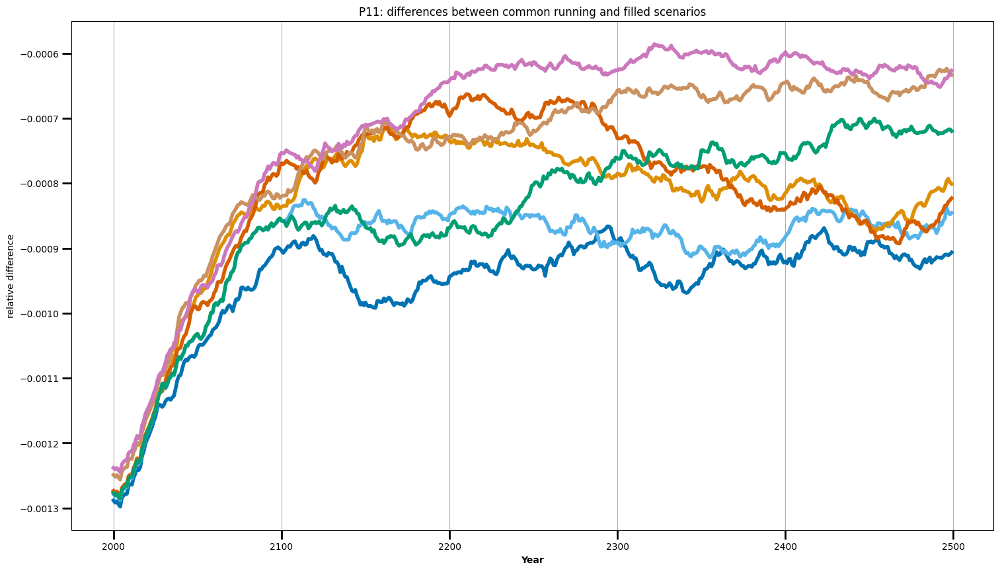

In [11]:
fig, ax = plt.subplots(1,1, figsize=(18,10), sharex=True)
sns.lineplot(data=pd_vol_scenario_rel_diff.loc[pd_vol_scenario_rel_diff.bias_correction==bc],
             hue='scenario', x='time', y= 'diff', 
             palette=paletti,
             hue_order=scenarios,lw=4, legend=False,
             ax = ax)
ax.set_xlabel('Year',  weight='bold')
ax.tick_params(axis='both', which='major', width=2, length=10)
ax.grid(axis='x')
plt.ylabel('relative difference')
plt.title('P11: differences between common running and filled scenarios')

# Figures:

In [12]:
# the same file of glacier projections for all figures:
#df_scenario = xr.open_dataset('filled_sum_all_provide_reg_oversh_stab_2000_2500.nc')
# we actually decided to use the 
df_scenario = xr.open_dataset(f'common_running_sum_all_provide_reg_oversh_stab_2000_2500_bc_1980_2019.nc')
# global and glacier region climate changes:
pd_clim_all = pd.read_csv('../annual_glob_rgi_reg_basin_temp_precip_timeseries_oversh_stab.csv', index_col = 'Unnamed: 0')
bc = 'bc_1980_2019' # 'bc_2000_2019' #x #
var = 'temp_20yr_avg'


## Global volume change plot:

In [14]:
color_scenario_manuscript = {}
for s in ['stab_T12','stab_T15','stab_T30', 'oversh_T20OS15','oversh_T25OS15','oversh_T30OS15']:
    if s not in ['stab_T20','stab_T25']:
        color_scenario_manuscript[s] = color_scenario[s]

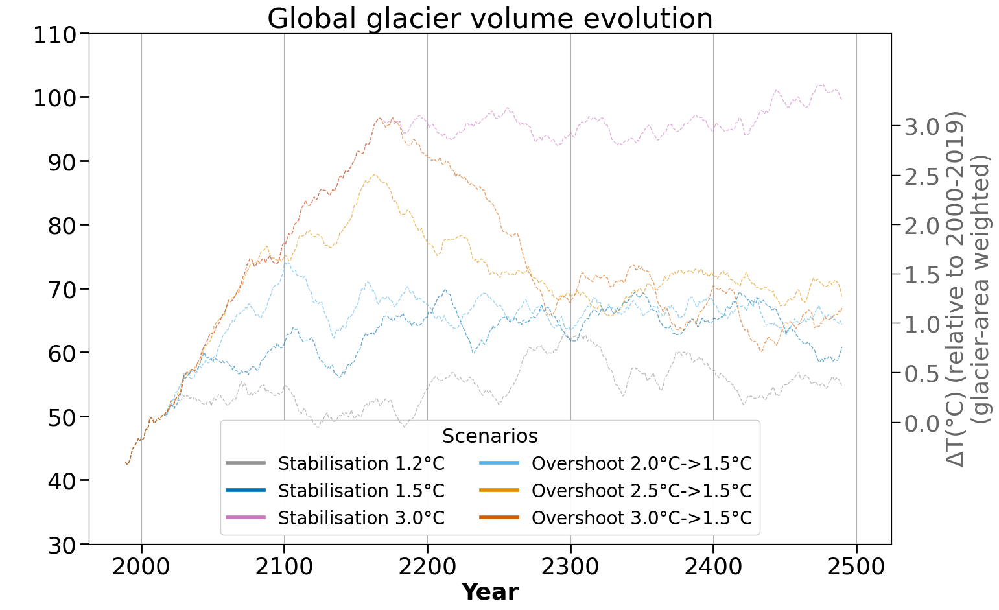

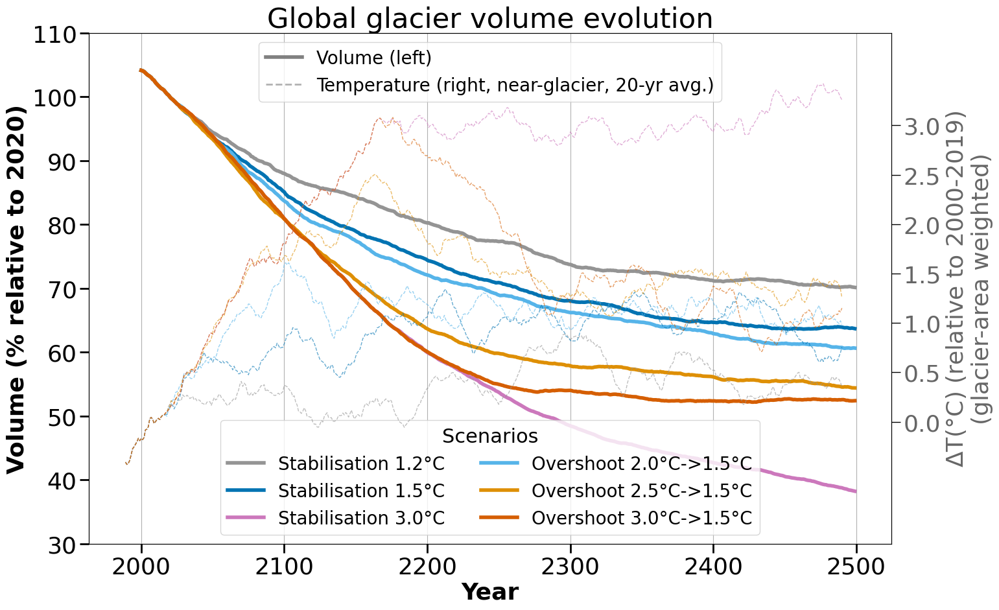

In [55]:
#####
plt.rc('font', size=26)
a = '_manuscript'
color_scenarios = color_scenario_manuscript
for alpha in [0,1]:
    scenarios = color_scenarios.keys()
    paletti = list(color_scenarios.values())     
    fig, ax = plt.subplots(1,1, figsize=(16,10), sharex=True)
    pd_vol_scenario_rel = (100*df_scenario/df_scenario.sel(time=2020)).volume.to_dataframe('volume_rel_2020_%').reset_index()
    df_scenario_glob = df_scenario.sum(dim='provide_region')
    pd_vol_scenario_glob = (100*df_scenario_glob/df_scenario_glob.sel(time=2020)).volume.to_dataframe('volume_rel_2020_%').reset_index()

    ax.set_ylabel('Volume (% relative to 2020)', weight='bold',alpha = alpha)

    sns.lineplot(data=pd_vol_scenario_glob.loc[pd_vol_scenario_glob.bias_correction==bc],
                 hue='scenario', x='time', y= 'volume_rel_2020_%', 
                 alpha = alpha,
                 palette=paletti,
                 hue_order=scenarios,lw=4, legend=True,
                 ax = ax)
    ax.set_xlabel('Year',  weight='bold')
    ax.tick_params(axis='both', which='major', width=2, length=10)
    ax.set_yticks(ticks=ax.get_yticks(), alpha=alpha)
    ax.grid(axis='x')
    ax.axhline(31, alpha=0)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == 'global_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 0.6, 
                 ls = '--',
                 lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
    ax2.set_yticks(ticks=[0.0,0.5,1.0,1.5,2.0,2.5,3.0],
                   labels=[0.0,0.5,1.0,1.5,2.0,2.5,3.0], alpha=0.6)
    #ax2.set_ylim([-0.9,5.9]);
    ax2.set_ylabel(r'$\Delta$T'+'(°C) (relative to 2000-2019)\n(glacier-area weighted)', alpha =0.6);
    ax2.tick_params(axis='both', which='major', width=1, length=10)
    ax2.axhline(-1, alpha=0)
    ax2.axhline(3.7, alpha=0)

    #plt.ylim([-2,122]);
    plt.tight_layout()
    
    ### add legends
    handles, labels = ax.get_legend_handles_labels()
    ax.get_legend().remove()
    handles_2, labels_2 = ax2.get_legend_handles_labels()
    if a == '_poster_iugg':
        leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], title='Scenarios',
                        fontsize=20, title_fontsize=22, bbox_to_anchor=(1,0.82), loc='upper right')
    else:
        leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], title='Scenarios',
                        fontsize=20, title_fontsize=22, #bbox_to_anchor=(1,1),
                        loc='lower center', ncol=2)
    for l in leg.get_lines():
        l.set_linewidth(4)
    if alpha !=0:
        leg2 = ax.legend([handles[0], handles_2[0]], ['Volume (left)',
                                                      r'Temperature (right, near-glacier, 20-yr avg.)'],
                         loc='upper center', ncol=1, fontsize=20)
    leg2.get_lines()[0].set_linewidth(4)
    leg2.get_lines()[1].set_linewidth(2)
    for l in leg2.get_lines():
        l.set_color('grey')
    ax.add_artist(leg)
    if a == '_poster_iugg':
        pass
        ax.text(0.98,0.98, 'Globally',
                 transform=ax.transAxes,ha='right',va='top',
                 color='grey', fontsize=24)
    else:
        ax.set_title('Global glacier volume evolution')

    plt.tight_layout()
    plt.savefig(f'2_global_glacier_volume{a}_{bc}_vol{alpha}.pdf')
    plt.savefig(f'2_global_glacier_volume{a}_{bc}_vol{alpha}.png')

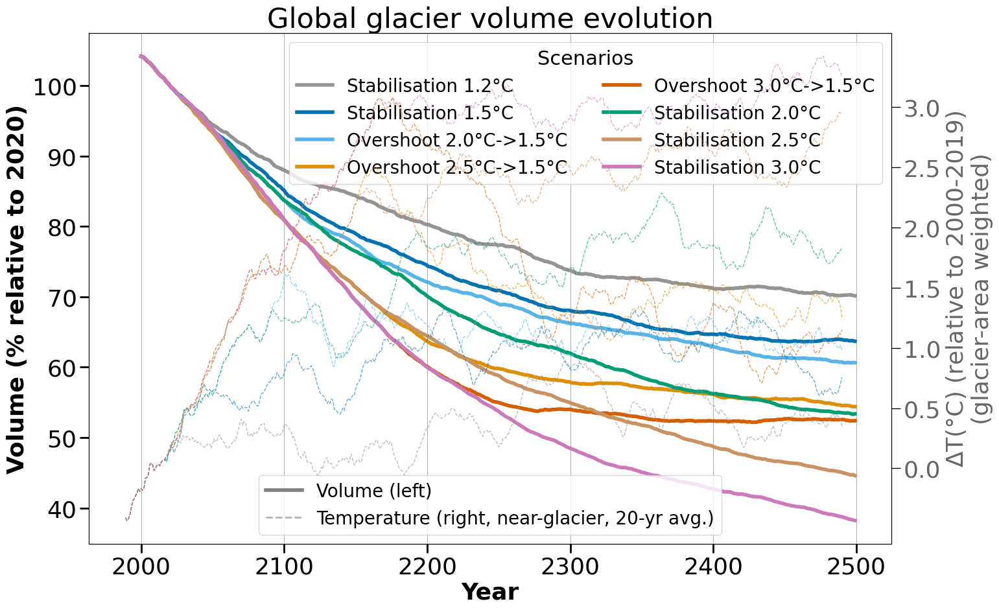

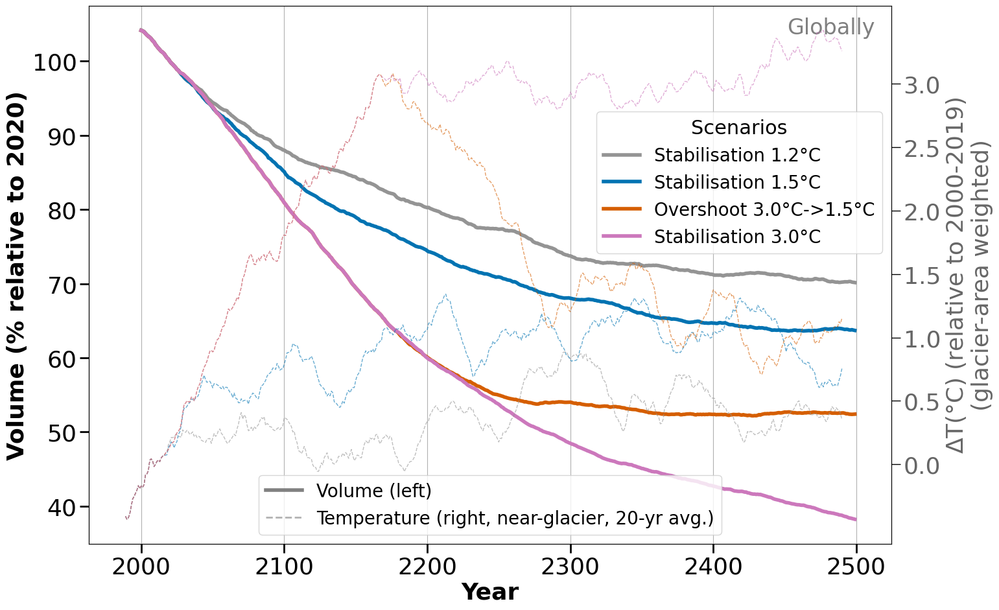

In [10]:
#####
plt.rc('font', size=26)
for a,color_scenarios in zip(['_all', '_poster_iugg'],
                       [color_scenario, color_scenario_poster]):
    scenarios = color_scenarios.keys()
    paletti = list(color_scenarios.values())     
    fig, ax = plt.subplots(1,1, figsize=(16,10), sharex=True)
    pd_vol_scenario_rel = (100*df_scenario/df_scenario.sel(time=2020)).volume.to_dataframe('volume_rel_2020_%').reset_index()
    df_scenario_glob = df_scenario.sum(dim='provide_region')
    pd_vol_scenario_glob = (100*df_scenario_glob/df_scenario_glob.sel(time=2020)).volume.to_dataframe('volume_rel_2020_%').reset_index()

    ax.set_ylabel('Volume (% relative to 2020)', weight='bold')

    sns.lineplot(data=pd_vol_scenario_glob.loc[pd_vol_scenario_glob.bias_correction==bc],
                 hue='scenario', x='time', y= 'volume_rel_2020_%', 
                 palette=paletti,
                 hue_order=scenarios,lw=4, legend=True,
                 ax = ax)
    ax.set_xlabel('Year',  weight='bold')
    ax.tick_params(axis='both', which='major', width=2, length=10)
    ax.grid(axis='x')

    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == 'global_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 0.6, 
                 ls = '--',
                 lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
    ax2.set_yticks(ticks=[0.0,0.5,1.0,1.5,2.0,2.5,3.0],
                   labels=[0.0,0.5,1.0,1.5,2.0,2.5,3.0], alpha=0.6)
    #ax2.set_ylim([-0.9,5.9]);
    ax2.set_ylabel(r'$\Delta$T'+'(°C) (relative to 2000-2019)\n(glacier-area weighted)', alpha =0.6);
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    #plt.ylim([-2,122]);
    plt.tight_layout()
    
    ### add legends
    handles, labels = ax.get_legend_handles_labels()
    ax.get_legend().remove()
    handles_2, labels_2 = ax2.get_legend_handles_labels()
    if a == '_poster_iugg':
        leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], title='Scenarios',
                        fontsize=20, title_fontsize=22, bbox_to_anchor=(1,0.82), loc='upper right')
    else:
        leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], title='Scenarios',
                        fontsize=20, title_fontsize=22, bbox_to_anchor=(1,1), loc='upper right', ncol=2)
    for l in leg.get_lines():
        l.set_linewidth(4)
    leg2 = ax.legend([handles[0], handles_2[0]], ['Volume (left)',
                                                  r'Temperature (right, near-glacier, 20-yr avg.)'],
                     loc='lower center', ncol=1, fontsize=20)
    leg2.get_lines()[0].set_linewidth(4)
    leg2.get_lines()[1].set_linewidth(2)
    for l in leg2.get_lines():
        l.set_color('grey')
    ax.add_artist(leg)
    if a == '_poster_iugg':
        pass
        ax.text(0.98,0.98, 'Globally',
                 transform=ax.transAxes,ha='right',va='top',
                 color='grey', fontsize=24)
    else:
        ax.set_title('Global glacier volume evolution')

    plt.tight_layout()
    plt.savefig(f'2_global_glacier_volume{a}_{bc}.pdf')
    plt.savefig(f'2_global_glacier_volume{a}_{bc}.png')

In [15]:
pd_vol_scenario_glob.loc[pd_vol_scenario_glob.time==2499]

,bias_correction,scenario,gcm,time,calendar_month,OGGM_version,volume_rel_2020_%
499,bc_1980_2019,oversh_T20OS15,GFDL-ESM2M,2499.0,1,OGGM_v161_gdirs_2023.3,60.645939
999,bc_1980_2019,oversh_T25OS15,GFDL-ESM2M,2499.0,1,OGGM_v161_gdirs_2023.3,54.403412
1499,bc_1980_2019,oversh_T30OS15,GFDL-ESM2M,2499.0,1,OGGM_v161_gdirs_2023.3,52.400246
1999,bc_1980_2019,stab_T12,GFDL-ESM2M,2499.0,1,OGGM_v161_gdirs_2023.3,70.151115
2499,bc_1980_2019,stab_T15,GFDL-ESM2M,2499.0,1,OGGM_v161_gdirs_2023.3,63.693253
2999,bc_1980_2019,stab_T20,GFDL-ESM2M,2499.0,1,OGGM_v161_gdirs_2023.3,53.363060
3499,bc_1980_2019,stab_T25,GFDL-ESM2M,2499.0,1,OGGM_v161_gdirs_2023.3,44.605957
3999,bc_1980_2019,stab_T30,GFDL-ESM2M,2499.0,1,OGGM_v161_gdirs_2023.3,38.224495


## Provide region volume evolution...

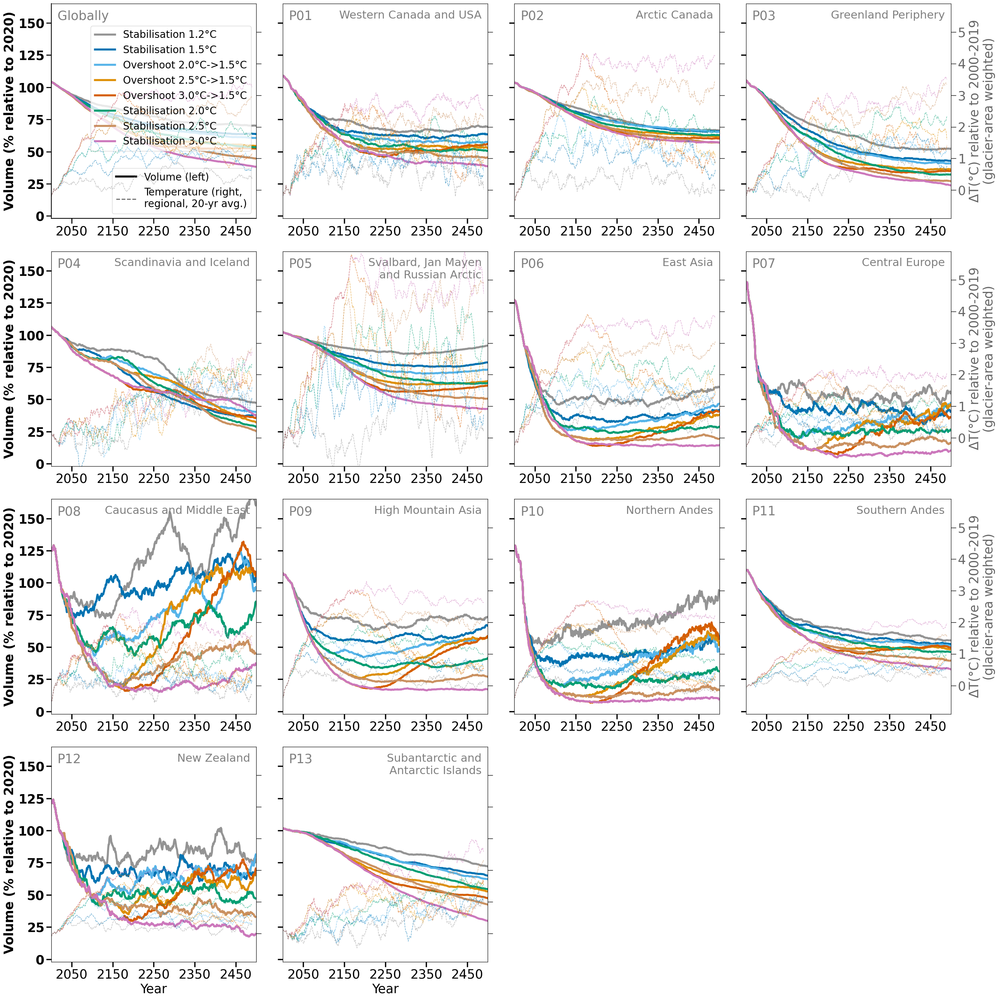

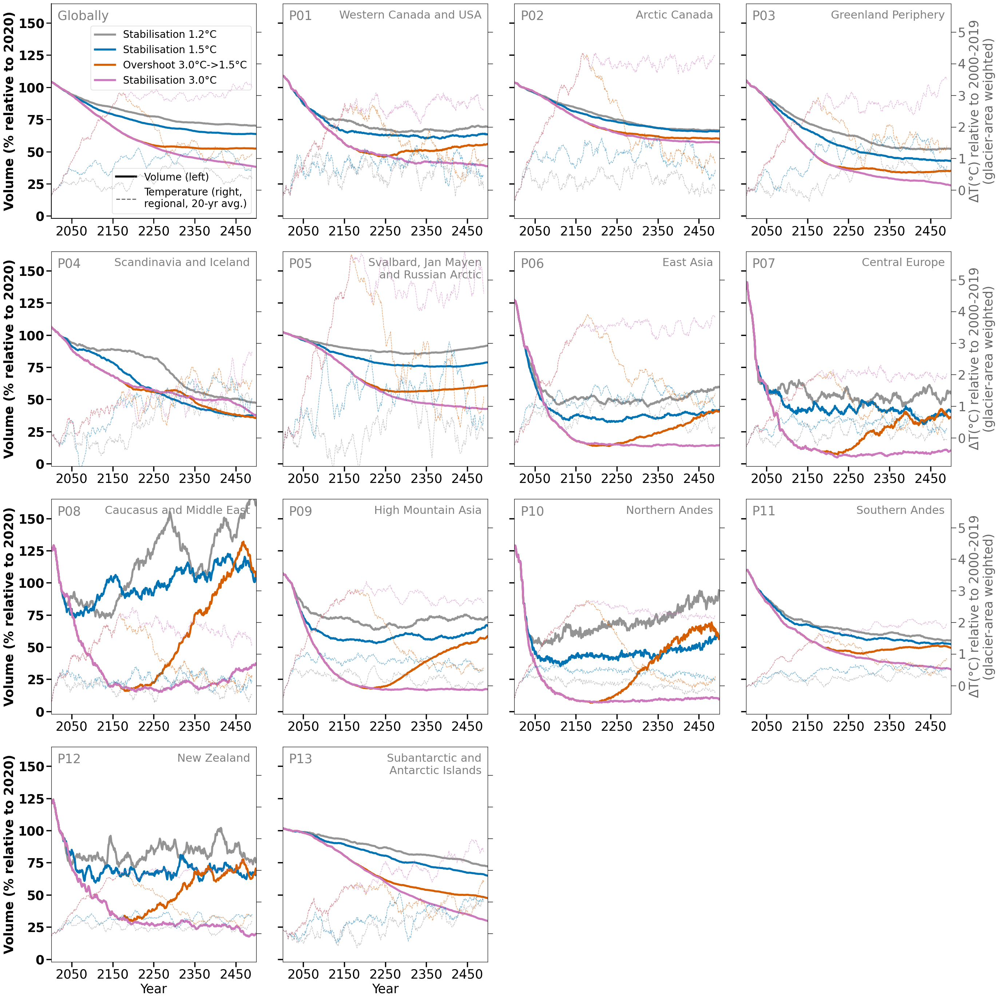

In [13]:
plt.rc('font', size=25)
portrait = True
pd_vol_scenario_rel = (100*df_scenario/df_scenario.sel(time=2020)).volume.to_dataframe('volume_rel_2020_%').reset_index()
df_scenario_glob = df_scenario.sum(dim='provide_region')
pd_vol_scenario_glob = (100*df_scenario_glob/df_scenario_glob.sel(time=2020)).volume.to_dataframe('volume_rel_2020_%').reset_index()

for a,color_scenarios in zip(['_all', '_poster_iugg'],
                       [color_scenario, color_scenario_poster]):
    scenarios = color_scenarios.keys()
    paletti = list(color_scenarios.values())  
    if portrait:
        plt.figure(figsize=(28,28)) #, sharey=True, sharex=True)
        plt.subplot(4,4,1)
    else:
        plt.figure(figsize=(45,16)) #, sharey=True, sharex=True)
        plt.subplot(2,7,1)
    ax = plt.gca()
    #ax.set_title('Globally')
    plt.text(0.03,0.97, 'Globally',
             transform=ax.transAxes,ha='left',va='top',
             color='grey', fontsize=25)
    ax.set_ylabel('Volume (% relative to 2020)', weight='bold')
    sns.lineplot(data=pd_vol_scenario_glob.loc[pd_vol_scenario_glob.bias_correction=='bc_1980_2019'],
                 hue='scenario', x='time', y= 'volume_rel_2020_%', 
                 palette=paletti,
                 hue_order=scenarios,lw=4, legend=True,
                 ax = ax)
    #ax.set_xlabel('Year')
    #ax.grid(axis='x')
    ax.set_ylim([-2,165]);
    ax.set_yticks(ticks=[0,25,50,75,100,125, 150],
                       labels=[0,25,50,75,100,125, 150], weight='bold')

    for axis in 'left', 'bottom':
        ax.spines[axis].set_linewidth(1.5)

    # set the parameters for both axis: label size in font points, the line tick line 
    # width and length in pixels
    ax.tick_params(axis='both', which='major', width=2, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == 'global_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 0.6, 
                 ls = '--',
                 lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
    ax2.set_ylabel('')
    ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
    ax2.set_ylim([-0.9,5.9]);

    plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
    ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])

    ### add legends
    handles, labels = ax.get_legend_handles_labels()
    ax.get_legend().remove()
    handles_2, labels_2 = ax2.get_legend_handles_labels()
    leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], #title='Scenarios',
                    fontsize=20, title_fontsize=22, bbox_to_anchor=(1,0.92), loc = 'upper right')
    for l in leg.get_lines():
        l.set_linewidth(4)
    leg2 = ax.legend([handles[0], handles_2[0]], ['Volume (left)',
                                                  'Temperature (right,\nregional, 20-yr avg.)'],
                     loc='lower right', ncol=1, fontsize=20)
    leg2.get_lines()[0].set_linewidth(4)
    leg2.get_lines()[1].set_linewidth(2)
    for l in leg2.get_lines():
        l.set_color('black')
    ax.add_artist(leg)


    for j, pi in enumerate(np.arange(1,14,1)):
        if pi<10:
            Preg = f'P0{pi}'
        else:
            Preg = f'P{pi}'
        if portrait:
            plt.subplot(4,4,j+2)
            x_j = np.arange(3,15,4)
            x2_j = np.arange(2,15,4)
            year_xlabel_condi = j>10

        else:
            plt.subplot(2,7,j+2)
            x_j = [6]
            x2_j = [5,12]
            year_xlabel_condi = j>5
        ax = plt.gca()
        pd_vol_scenario_rel_reg = pd_vol_scenario_rel.loc[pd_vol_scenario_rel.provide_region==Preg]
        sns.lineplot(data=pd_vol_scenario_rel_reg.loc[pd_vol_scenario_rel_reg.bias_correction=='bc_1980_2019'],
                     hue='scenario', x='time', y= 'volume_rel_2020_%', 
                     palette=paletti,
                 hue_order=scenarios,lw=4, legend=False,
                 ax = ax)

        #ax.set_title(f'{Preg}')
        plt.text(0.03,0.97, Preg,
                 transform=ax.transAxes,ha='left',va='top',
                 color='grey', fontsize=25)
        plt.text(0.97,0.97, provide_reg_full_name_dict[Preg],
                 transform=ax.transAxes,ha='right',va='top',
                 color='grey', fontsize=22)
        ax.set_yticks(ticks=[0,25,50,75,100,125, 150],
                       labels=[0,25,50,75,100,125, 150], weight='bold')
        if j in x_j:
            plt.ylabel(f'Volume (% relative to 2020)', weight='bold')
            ax.set_yticks(ticks=[0,25,50,75,100,125, 150],
                       labels=[0,25,50,75,100,125, 150], weight='bold')
        else:
            plt.ylabel('')
            ax.set_yticks(ticks=[0,25,50,75,100,125, 150],
                       labels=[0,25,50,75,100,125, 150], alpha=0, fontsize=1) #visible=False) 
            #plt.setp(ax.get_yticklabels(), visible=False)

        ax.set_ylim([-2,165]);
        ax.tick_params(axis='both', which='major', width=2.5, length=10)
        ax2 = ax.twinx()  
        for scenario in scenarios:
                        #'stab_T30']:

            pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
            pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'provide_reg_{Preg}_glacier']
            pd_clim_scenario_g.index = pd_clim_scenario_g.year
            temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

            ax2.plot(pd_clim_scenario_g.year,
                     var_g_to_ref,
                     alpha = 0.6, 
                     ls = '--',
                     lw=1, color = color_scenario[scenario], label=label_scenario[scenario])

        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
        if j in x2_j:
            ax2.set_ylabel(r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)',
                          alpha = 0.6)
            #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
        else:
            ax2.set_ylabel('')
            #ax2.set_yticks([])
            plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

        ax2.set_ylim([-0.9,5.9]);
        if year_xlabel_condi:
            ax.set_xlabel('Year')
        else:
            ax.set_xlabel('')
        ax.set_xlim([2000,2500])
        ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
        ax2.set_xlim([2000,2500])
        ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)  

    plt.tight_layout()
    #plt.savefig('test_provide_reg.png', dpi=450) #, bbox_inches='tight')
    if portrait:
        plt.savefig(f'2_provide_reg_volume_changes_overshoot{a}_{bc}_portrait_4cols.pdf')
        plt.savefig(f'2_provide_reg_volume_changes_overshoot{a}_{bc}_portrait_4cols.png')

    else:
        plt.savefig(f'2_provide_reg_volume_changes_overshoot{a}_{bc}.pdf')

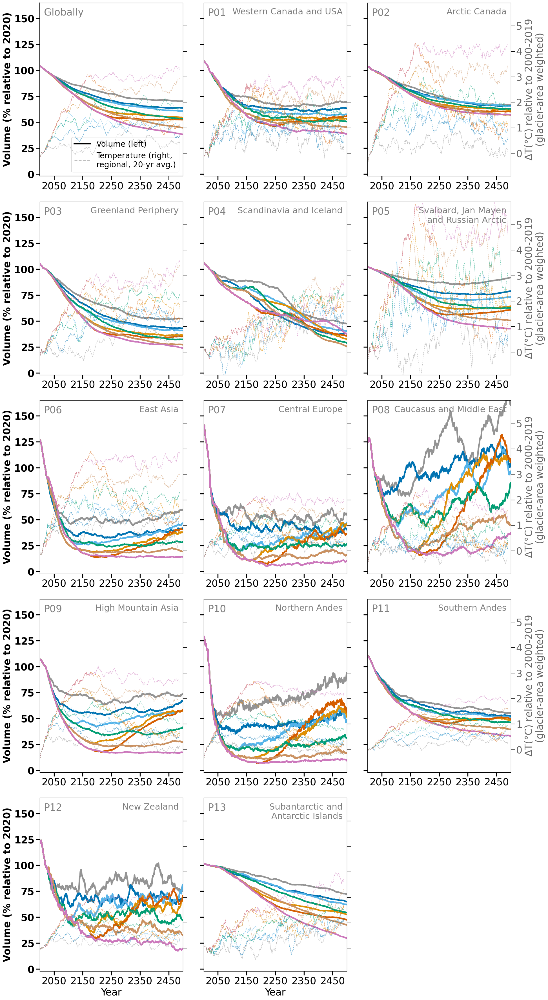

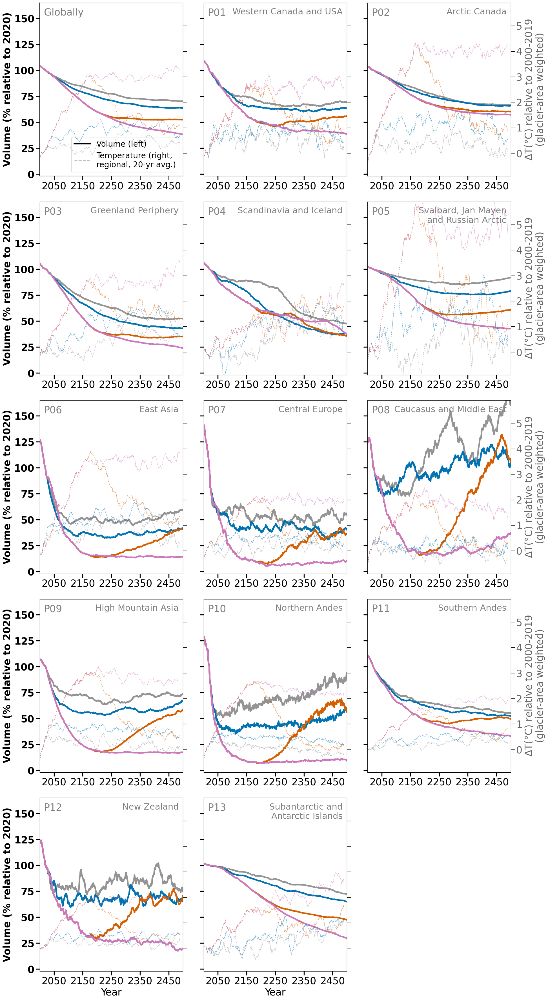

In [19]:
plt.rc('font', size=25)
portrait = True
pd_vol_scenario_rel = (100*df_scenario/df_scenario.sel(time=2020)).volume.to_dataframe('volume_rel_2020_%').reset_index()
df_scenario_glob = df_scenario.sum(dim='provide_region')
pd_vol_scenario_glob = (100*df_scenario_glob/df_scenario_glob.sel(time=2020)).volume.to_dataframe('volume_rel_2020_%').reset_index()

for a,color_scenarios in zip(['_all', '_poster_iugg'],
                       [color_scenario, color_scenario_poster]):
    scenarios = color_scenarios.keys()
    paletti = list(color_scenarios.values())  
    if portrait:
        plt.figure(figsize=(20,36)) #, sharey=True, sharex=True)
        plt.subplot(5,3,1)
    else:
        plt.figure(figsize=(45,16)) #, sharey=True, sharex=True)
        plt.subplot(2,7,1)
    ax = plt.gca()
    #ax.set_title('Globally')
    plt.text(0.03,0.97, 'Globally',
             transform=ax.transAxes,ha='left',va='top',
             color='grey', fontsize=25)
    ax.set_ylabel('Volume (% relative to 2020)', weight='bold')
    sns.lineplot(data=pd_vol_scenario_glob.loc[pd_vol_scenario_glob.bias_correction=='bc_1980_2019'],
                 hue='scenario', x='time', y= 'volume_rel_2020_%', 
                 palette=paletti,
                 hue_order=scenarios,lw=4, legend=True,
                 ax = ax)
    #ax.set_xlabel('Year')
    #ax.grid(axis='x')
    ax.set_ylim([-2,165]);
    ax.set_yticks(ticks=[0,25,50,75,100,125, 150],
                       labels=[0,25,50,75,100,125, 150], weight='bold')

    for axis in 'left', 'bottom':
        ax.spines[axis].set_linewidth(1.5)

    # set the parameters for both axis: label size in font points, the line tick line 
    # width and length in pixels
    ax.tick_params(axis='both', which='major', width=2, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == 'global_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 0.6, 
                 ls = '--',
                 lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
    ax2.set_ylabel('')
    ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
    ax2.set_ylim([-0.9,5.9]);

    plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
    ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])

    ### add legends
    handles, labels = ax.get_legend_handles_labels()
    ax.get_legend().remove()
    handles_2, labels_2 = ax2.get_legend_handles_labels()
    leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], #title='Scenarios',
                    fontsize=20, title_fontsize=22, bbox_to_anchor=(1,0.9), loc = 'upper right')
    for l in leg.get_lines():
        l.set_linewidth(4)
    leg2 = ax.legend([handles[0], handles_2[0]], ['Volume (left)',
                                                  'Temperature (right,\nregional, 20-yr avg.)'],
                     loc='lower right', ncol=1, fontsize=20)
    leg2.get_lines()[0].set_linewidth(4)
    leg2.get_lines()[1].set_linewidth(2)
    for l in leg2.get_lines():
        l.set_color('black')
    #ax.add_artist(leg)


    for j, pi in enumerate(np.arange(1,14,1)):
        if pi<10:
            Preg = f'P0{pi}'
        else:
            Preg = f'P{pi}'
        if portrait:
            plt.subplot(5,3,j+2)
            x_j = np.arange(2,15,3)
            x2_j = np.arange(1,15,3)
            year_xlabel_condi = j>10

        else:
            plt.subplot(2,7,j+2)
            x_j = [6]
            x2_j = [5,12]
            year_xlabel_condi = j>5
        ax = plt.gca()
        pd_vol_scenario_rel_reg = pd_vol_scenario_rel.loc[pd_vol_scenario_rel.provide_region==Preg]
        sns.lineplot(data=pd_vol_scenario_rel_reg.loc[pd_vol_scenario_rel_reg.bias_correction=='bc_1980_2019'],
                     hue='scenario', x='time', y= 'volume_rel_2020_%', 
                     palette=paletti,
                 hue_order=scenarios,lw=4, legend=False,
                 ax = ax)

        #ax.set_title(f'{Preg}')
        plt.text(0.03,0.97, Preg,
                 transform=ax.transAxes,ha='left',va='top',
                 color='grey', fontsize=25)
        plt.text(0.97,0.97, provide_reg_full_name_dict[Preg],
                 transform=ax.transAxes,ha='right',va='top',
                 color='grey', fontsize=22)
        ax.set_yticks(ticks=[0,25,50,75,100,125, 150],
                       labels=[0,25,50,75,100,125, 150], weight='bold')
        if j in x_j:
            plt.ylabel(f'Volume (% relative to 2020)', weight='bold')
            ax.set_yticks(ticks=[0,25,50,75,100,125, 150],
                       labels=[0,25,50,75,100,125, 150], weight='bold')
        else:
            plt.ylabel('')
            ax.set_yticks(ticks=[0,25,50,75,100,125, 150],
                       labels=[0,25,50,75,100,125, 150], alpha=0, fontsize=1) #visible=False) 
            #plt.setp(ax.get_yticklabels(), visible=False)

        ax.set_ylim([-2,165]);
        ax.tick_params(axis='both', which='major', width=2.5, length=10)
        ax2 = ax.twinx()  
        for scenario in scenarios:
                        #'stab_T30']:

            pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
            pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'provide_reg_{Preg}_glacier']
            pd_clim_scenario_g.index = pd_clim_scenario_g.year
            temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

            ax2.plot(pd_clim_scenario_g.year,
                     var_g_to_ref,
                     alpha = 0.6, 
                     ls = '--',
                     lw=1, color = color_scenario[scenario], label=label_scenario[scenario])

        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
        if j in x2_j:
            ax2.set_ylabel(r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)',
                          alpha = 0.6)
            #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
        else:
            ax2.set_ylabel('')
            #ax2.set_yticks([])
            plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

        ax2.set_ylim([-0.9,5.9]);
        if year_xlabel_condi:
            ax.set_xlabel('Year')
        else:
            ax.set_xlabel('')
        ax.set_xlim([2000,2500])
        ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
        ax2.set_xlim([2000,2500])
        ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)  

    plt.tight_layout()
    #plt.savefig('test_provide_reg.png', dpi=450) #, bbox_inches='tight')
    if portrait:
        plt.savefig(f'2_provide_reg_volume_changes_overshoot{a}_{bc}_portrait_3cols.pdf')
        plt.savefig(f'2_provide_reg_volume_changes_overshoot{a}_{bc}_portrait_3cols.png')

    else:
        plt.savefig(f'2_provide_reg_volume_changes_overshoot{a}_{bc}.pdf')

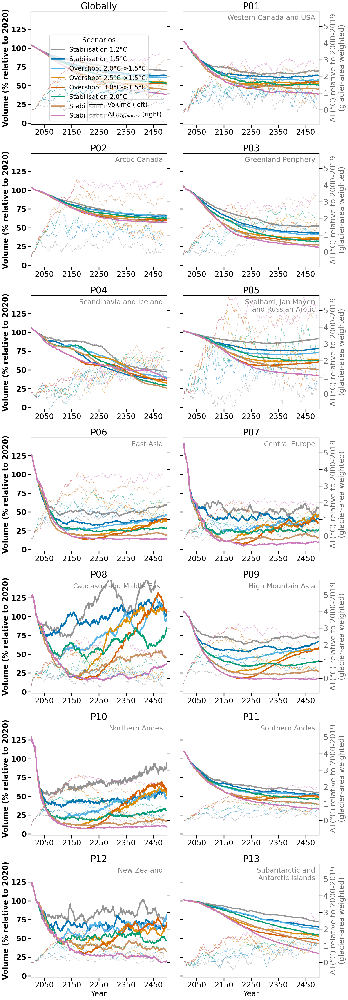

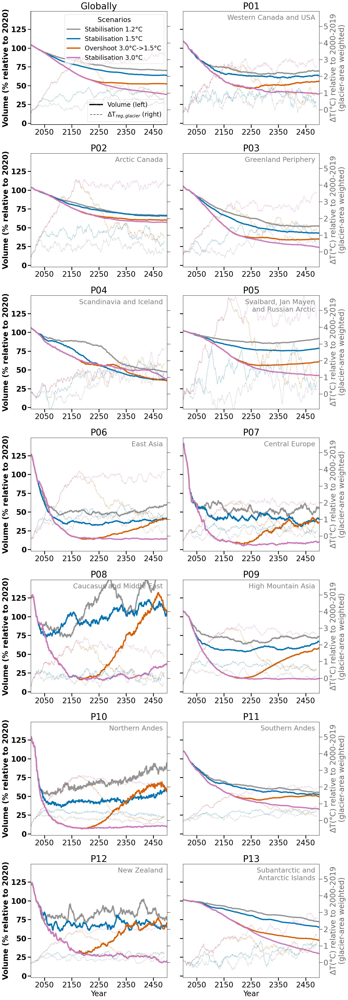

In [82]:
plt.rc('font', size=24)
portrait = True
pd_vol_scenario_rel = (100*df_scenario/df_scenario.sel(time=2020)).volume.to_dataframe('volume_rel_2020_%').reset_index()
df_scenario_glob = df_scenario.sum(dim='provide_region')
pd_vol_scenario_glob = (100*df_scenario_glob/df_scenario_glob.sel(time=2020)).volume.to_dataframe('volume_rel_2020_%').reset_index()

for a,color_scenarios in zip(['_all', '_poster_iugg'],
                       [color_scenario, color_scenario_poster]):
    scenarios = color_scenarios.keys()
    paletti = list(color_scenarios.values())  
    if portrait:
        plt.figure(figsize=(16,45)) #, sharey=True, sharex=True)
        plt.subplot(7,2,1)
    else:
        plt.figure(figsize=(45,16)) #, sharey=True, sharex=True)
        plt.subplot(2,7,1)
    ax = plt.gca()
    ax.set_title('Globally')

    ax.set_ylabel('Volume (% relative to 2020)', weight='bold')
    sns.lineplot(data=pd_vol_scenario_glob.loc[pd_vol_scenario_glob.bias_correction=='bc_1980_2019'],
                 hue='scenario', x='time', y= 'volume_rel_2020_%', 
                 palette=paletti,
                 hue_order=scenarios,lw=4, legend=True,
                 ax = ax)
    #ax.set_xlabel('Year')
    #ax.grid(axis='x')
    ax.set_ylim([-2,149]);
    ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], weight='bold')

    for axis in 'left', 'bottom':
        ax.spines[axis].set_linewidth(1.5)

    # set the parameters for both axis: label size in font points, the line tick line 
    # width and length in pixels
    ax.tick_params(axis='both', which='major', width=2, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == 'global_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 0.6, 
                 ls = '--',
                 lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
    ax2.set_ylabel('')
    ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
    ax2.set_ylim([-0.9,5.9]);

    plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
    ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])

    ### add legends
    handles, labels = ax.get_legend_handles_labels()
    ax.get_legend().remove()
    handles_2, labels_2 = ax2.get_legend_handles_labels()
    leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], title='Scenarios', fontsize=20, title_fontsize=22)
    for l in leg.get_lines():
        l.set_linewidth(4)
    leg2 = ax.legend([handles[0], handles_2[0]], ['Volume (left)',
                                                  r'$\Delta$T$_{reg,glacier}$ '+'(right)'],
                     loc='lower right', ncol=1, fontsize=20)
    leg2.get_lines()[0].set_linewidth(4)
    leg2.get_lines()[1].set_linewidth(2)
    for l in leg2.get_lines():
        l.set_color('black')
    ax.add_artist(leg)


    for j, pi in enumerate(np.arange(1,14,1)):
        if pi<10:
            Preg = f'P0{pi}'
        else:
            Preg = f'P{pi}'
        if portrait:
            plt.subplot(7,2,j+2)
            x_j = np.arange(1,15,2)
            x2_j = np.arange(0,15,2)
            year_xlabel_condi = j>10

        else:
            plt.subplot(2,7,j+2)
            x_j = [6]
            x2_j = [5,12]
            year_xlabel_condi = j>5
        ax = plt.gca()
        pd_vol_scenario_rel_reg = pd_vol_scenario_rel.loc[pd_vol_scenario_rel.provide_region==Preg]
        sns.lineplot(data=pd_vol_scenario_rel_reg.loc[pd_vol_scenario_rel_reg.bias_correction=='bc_1980_2019'],
                     hue='scenario', x='time', y= 'volume_rel_2020_%', 
                     palette=paletti,
                 hue_order=scenarios,lw=4, legend=False,
                 ax = ax)

        ax.set_title(f'{Preg}')
        plt.text(0.97,0.97, provide_reg_full_name_dict[Preg],
                 transform=ax.transAxes,ha='right',va='top',
                 color='grey', fontsize=22)
        ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], weight='bold')
        if j in x_j:
            plt.ylabel(f'Volume (% relative to 2020)', weight='bold')
            ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], weight='bold')
        else:
            plt.ylabel('')
            ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], alpha=0, fontsize=1) #visible=False) 
            #plt.setp(ax.get_yticklabels(), visible=False)

        ax.set_ylim([-2,149]);
        ax.tick_params(axis='both', which='major', width=2.5, length=10)
        ax2 = ax.twinx()  
        for scenario in scenarios:
                        #'stab_T30']:

            pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
            pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'provide_reg_{Preg}_glacier']
            pd_clim_scenario_g.index = pd_clim_scenario_g.year
            temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

            ax2.plot(pd_clim_scenario_g.year,
                     var_g_to_ref,
                     alpha = 0.6, 
                     ls = '--',
                     lw=1, color = color_scenario[scenario], label=label_scenario[scenario])

        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
        if j in x2_j:
            ax2.set_ylabel(r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)',
                          alpha = 0.6)
            #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
        else:
            ax2.set_ylabel('')
            #ax2.set_yticks([])
            plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

        ax2.set_ylim([-0.9,5.9]);
        if year_xlabel_condi:
            ax.set_xlabel('Year')
        else:
            ax.set_xlabel('')
        ax.set_xlim([2000,2500])
        ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
        ax2.set_xlim([2000,2500])
        ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)  

    plt.tight_layout()
    #plt.savefig('test_provide_reg.png', dpi=450) #, bbox_inches='tight')
    if portrait:
        plt.savefig(f'2_provide_reg_volume_changes_overshoot{a}_{bc}_portrait.pdf')
        plt.savefig(f'2_provide_reg_volume_changes_overshoot{a}_{bc}_portrait.png')

    else:
        plt.savefig(f'2_provide_reg_volume_changes_overshoot{a}_{bc}.pdf')

In [83]:
dsel = df_scenario.sel(provide_region='P11').sel(bias_correction=bc).isel(time=0)
assert dsel.volume.std() < 0.01

AssertionError: 

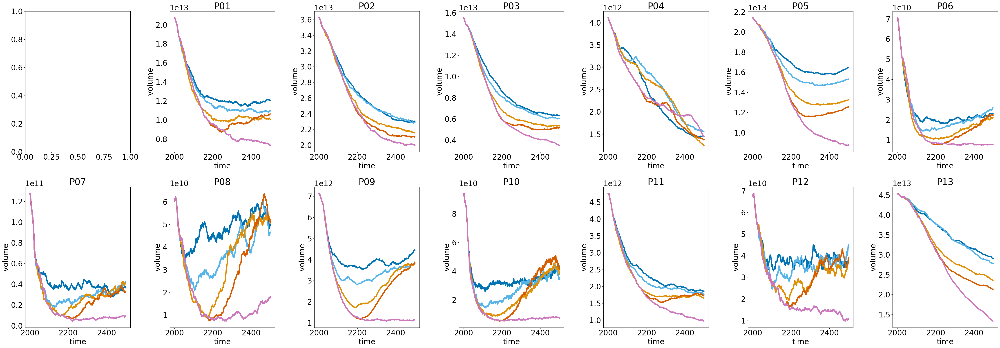

In [121]:
var = 'temp_20yr_avg'

plt.rc('font', size=24)
#xr.open_dataset(f'volume_evol_gfdl-esm2m_oversh_stab_provide_reg_common_running_glaciers.nc')


plt.figure(figsize=(45,16)) #, sharey=True, sharex=True)
plt.subplot(2,7,1)



for j, pi in enumerate(np.arange(1,14,1)):
    if pi<10:
        Preg = f'P0{pi}'
    else:
        Preg = f'P{pi}'
    plt.subplot(2,7,j+2)
    ax = plt.gca()
    pd_vol_scenario_rel_reg = df_scenario.sel(provide_region=Preg).volume.to_dataframe('volume').reset_index()
    sns.lineplot(data=pd_vol_scenario_rel_reg.loc[pd_vol_scenario_rel_reg.bias_correction==bc],
                 hue='scenario', x='time', y= 'volume', 
                 palette=color_scenario_poster,
             hue_order=scenarios,lw=4, legend=False,
             ax = ax)
    
    ax.set_title(f'{Preg}')


plt.tight_layout()
#plt.savefig('test_provide_reg.png', dpi=450) #, bbox_inches='tight')
#plt.savefig('overshoot_provide_reg.pdf')

### Basin plots

In [15]:
import geopandas as gpd
df_scenario_common_basin = xr.open_dataset(f'common_running_sum_all_basins_oversh_stab_2000_2500_bc_1980_2019.nc')
pd_basin_num = gpd.read_file('/home/www/fmaussion/misc/magicc/basins_shape/glacier_basins.shp')
f = open('/home/www/lschuster/provide/provide_glacier_regions/basin_ids_per_provide_region.json')
basins_per_preg = json.load(f)

pd_vol_scenario_rel_common_basin = (100*df_scenario_common_basin/df_scenario_common_basin.sel(time=2020)).volume.to_dataframe('volume_rel_2020_%').reset_index()
pd_vol_scenario_rel_common_basin = pd_vol_scenario_rel_common_basin.loc[pd_vol_scenario_rel_common_basin.bias_correction==bc]
scenarios = list(color_scenario_poster.keys())

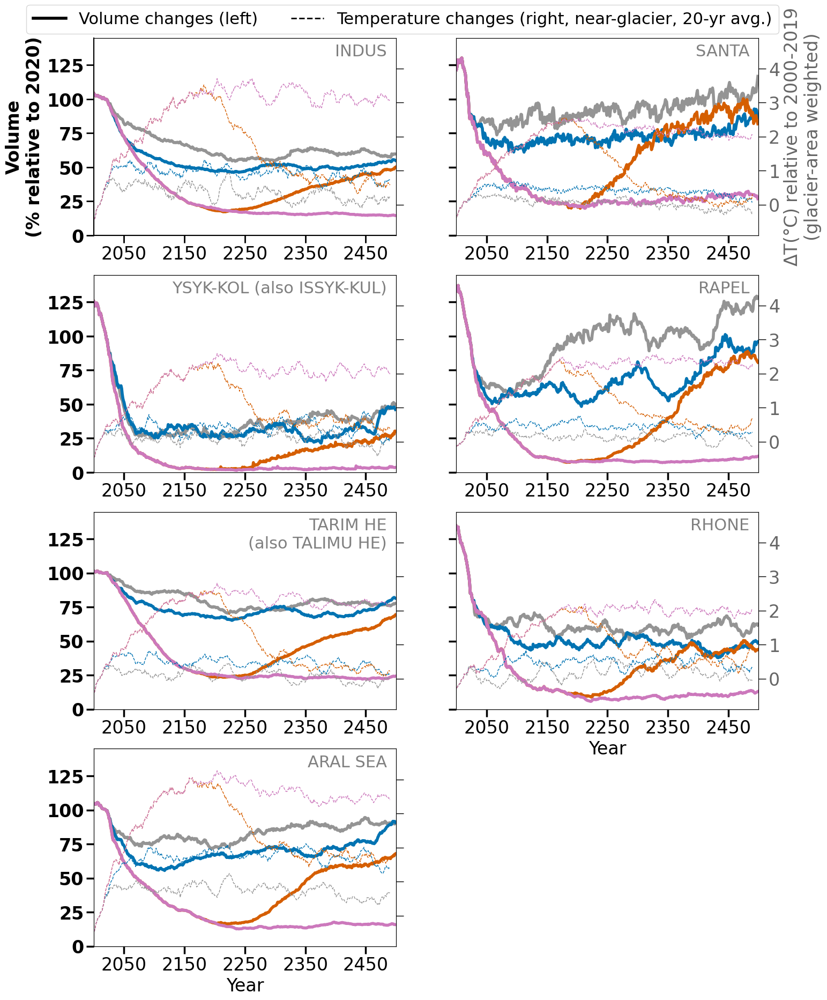

In [33]:
var = 'temp_20yr_avg'
basins = np.array([2309, 3425, 2919, 3423, 2914, 6243, 2902]) # 7 most arid and glaciated basins ... pd_basins_arid_glac_num.MRBID.values of 3_runoff_timeseries_basins.ipynb


plt.rc('font', size=24)

plt.figure(figsize=(16,22)) #, sharey=True, sharex=True)
plt.subplot(4,2,1)
ax = plt.gca()


basin = basins[0]
basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0]#.split()#[0]
continent_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['CONTINENT'].values[0]#.split()#[0]
#basin_name = f'{continent_n}: {basin_n}'
basin_name = f'{basin_n}'

#ax.set_title(basin_name)
sns.lineplot(data=pd_vol_scenario_rel_common_basin.loc[pd_vol_scenario_rel_common_basin.basin == str(basin)],
             hue='scenario', x='time', y= 'volume_rel_2020_%', 
             palette=color_scenario_poster.values(),
             hue_order=scenarios,lw=4, legend=True,
             ax = ax)
#ax.set_xlabel('Year')
#ax.grid(axis='x')
plt.ylabel(f'Volume\n(% relative to 2020)', weight='bold')
ax.set_yticks(ticks=[0,25,50,75,100,125],
           labels=[0,25,50,75,100,125], weight='bold')

for axis in 'left', 'bottom':
    ax.spines[axis].set_linewidth(1.5)

# set the parameters for both axis: label size in font points, the line tick line 
# width and length in pixels
ax.tick_params(axis='both', which='major', width=2, length=10)
ax2 = ax.twinx()  
for scenario in scenarios:
                #'stab_T30']:

    pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
    pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
    pd_clim_scenario_g.index = pd_clim_scenario_g.year
    temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
    if var == 'temp_20yr_avg':
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
    else:
        var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

    ax2.plot(pd_clim_scenario_g.year,
             var_g_to_ref,
             alpha = 1, 
             ls = '--',
             lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
ax2.set_ylabel('')
if var != 'temp_20yr_avg':
    ticks = np.arange(70,131,10)
    ax2.set_yticks(ticks=ticks,
                    labels=ticks, alpha=0.6) 
else:
    ax2.set_yticks(ticks=[0,1,2,3,4,5],
               labels=[0,1,2,3,4,5], alpha=0.6)


plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
ax.set_xlabel('')
ax.set_xlim([2000,2500])
ax2.set_xlim([2000,2500])
ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])

ax2.set_ylim([-0.9,4.9]);
ax.set_ylim([0,145]);

### add legends
handles, labels = ax.get_legend_handles_labels()
ax.get_legend().remove()
handles_2, labels_2 = ax2.get_legend_handles_labels()
#leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], #title='Scenarios',
#                fontsize=20, title_fontsize=22,loc = 'lower left', bbox_to_anchor=(-0.02,1.11), ncol=3)
#for l in leg.get_lines():
#    l.set_linewidth(4)
ax_0 = ax    


plt.text(0.97,0.97, basin_name,
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22, zorder=-1)

axs = []
for j, basin in enumerate(basins[1:]):
    basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0]#.split()[0]
    if basin_n=='TARIM HE (also TALIMU HE)':
        basin_n = 'TARIM HE\n(also TALIMU HE)'
    continent_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['CONTINENT'].values[0]#.split()#[0]
    basin_name = f'{basin_n}'
    #basin_name = f'{continent_n}: {basin_n}'
    plt.subplot(4,2,j+2)
    x_j = np.arange(1,20,2)
    x2_j = np.arange(0,20,2)

    ax = plt.gca()

    basin_vol_sel = pd_vol_scenario_rel_common_basin.loc[pd_vol_scenario_rel_common_basin.basin == str(basin)]
    sns.lineplot(data=basin_vol_sel,
             hue='scenario', x='time', y=  'volume_rel_2020_%',  
                 palette=list(color_scenario_poster.values()),
             hue_order=scenarios,lw=4, legend=False,
             ax = ax)

    #ax.set_title(f'{Preg}: {basin}')

    plt.text(0.97,0.97, basin_name,
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22, zorder=-1)

    if j in x_j:
        ax.set_yticks(ticks=[0,25,50,75,100,125],
                   labels=[0,25,50,75,100,125], weight='bold')
    else:
        ax.set_yticks(ticks=[0,25,50,75,100,125],
                   labels=[0,25,50,75,100,125], alpha=0, fontsize=1) #visible=False) 
    ax.set_ylabel('')

            #plt.setp(ax.get_yticklabels(), visible=False)
     #plt.setp(ax.get_yticklabels(), visible=False)

    #ax.set_ylim([70,1439.9]);


    ax.tick_params(axis='both', which='major', width=2.5, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        if var == 'temp_20yr_avg':
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
        else:
            var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g
        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 1, 
                 ls = '--',
                 lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
    if var != 'temp_20yr_avg':
        ticks = np.arange(70,131,10)
        ax2.set_yticks(ticks=ticks,
                        labels=ticks, alpha=0.6)  
        ylabel = 'near-glacier precipitation \n(% relative to 2000-2019)' #, glacier-area weighted)'

    else:
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
        ylabel = r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)'
    
    ax2.set_ylabel('')
    if j in x2_j:
        pass
        #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
    else:
        #ax2.set_yticks([])
        plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
    if j == 0:
        ax2.set_ylabel(ylabel,
                      alpha = 0.6)
    #ax2.set_ylim([0,5.5]);
    ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax2.set_ylim([-0.9,4.9]);
    ax.set_ylim([0,145]);
    axs.append(ax)
#plt.tight_layout()

for j,ax in enumerate(axs):
    if j>=4:
        ax.set_xlabel('Year')
    else:
        ax.set_xlabel('')

ax = ax_0
leg2 = ax.legend([handles[0], handles_2[0]], ['Volume changes (left)',
                                                  r'Temperature changes (right, near-glacier, 20-yr avg.)'],
                 loc='lower left', fontsize=22, bbox_to_anchor=(-0.25,0.98), ncol=2)
leg2.get_lines()[0].set_linewidth(4)
leg2.get_lines()[1].set_linewidth(2)
for l in leg2.get_lines():
    l.set_color('black')
#ax.add_artist(leg)
plt.savefig(f'figures/figures_basins/2_most_arid_glaciated_basin_50yr_volume_{bc}_vs_temperature.png')
plt.savefig(f'figures/figures_basins/2_most_arid_glaciated_basin_50yr_volume_{bc}_vs_temperature.pdf')


**For every basin separately**

In [71]:
plt.rc('font', size=24)
portrait = True

for Preg in df_scenario.provide_region.values:
    basins = basins_per_preg[Preg]
    if len(basins)<1:
        continue
    for a,color_scenarios in zip(['_all', '_poster_iugg'],
                           [color_scenario, color_scenario_poster]):
        scenarios = color_scenarios.keys()
        paletti = list(color_scenarios.values())  
        if portrait:
            plt.figure(figsize=(24,30)) #, sharey=True, sharex=True)
            plt.subplot(5,4,1)
        else:
            plt.figure(figsize=(45,16)) #, sharey=True, sharex=True)
            plt.subplot(2,8,1)
        ax = plt.gca()

        ax.set_ylabel('Volume\n(% relative to 2020)', weight='bold')
        basin = basins[0]
        basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0].split()[0]
        basin_name = f'{Preg}: {basin_n} ({basin})'
        ax.set_title(basin_name)
        sns.lineplot(data=pd_vol_scenario_rel_common_basin.loc[pd_vol_scenario_rel_common_basin.basin == str(basin)],
                     hue='scenario', x='time', y= 'volume_rel_2020_%', 
                     palette=paletti,
                     hue_order=scenarios,lw=4, legend=True,
                     ax = ax)
        #ax.set_xlabel('Year')
        #ax.grid(axis='x')
        ax.set_ylim([-2,149]);
        ax.set_yticks(ticks=[0,25,50,75,100,125],
                      labels=[0,25,50,75,100,125], weight='bold')

        for axis in 'left', 'bottom':
            ax.spines[axis].set_linewidth(1.5)

        # set the parameters for both axis: label size in font points, the line tick line 
        # width and length in pixels
        ax.tick_params(axis='both', which='major', width=2, length=10)
        ax2 = ax.twinx()  
        for scenario in scenarios:
            pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
            pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
            pd_clim_scenario_g.index = pd_clim_scenario_g.year
            temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

            ax2.plot(pd_clim_scenario_g.year,
                     var_g_to_ref,
                     alpha = 0.6, 
                     ls = '--',
                     lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
        ax2.set_ylabel('')
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                       labels=[0,1,2,3,4,5], alpha=0.6)
        ax2.set_ylim([-0.9,5.9]);

        plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
        ax.set_xlabel('')
        ax.set_xlim([2000,2500])
        ax2.set_xlim([2000,2500])
        ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
        ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])

        ### add legends
        handles, labels = ax.get_legend_handles_labels()
        ax.get_legend().remove()
        handles_2, labels_2 = ax2.get_legend_handles_labels()
        leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], title='Scenarios', fontsize=20, title_fontsize=22)
        for l in leg.get_lines():
            l.set_linewidth(4)
        leg2 = ax.legend([handles[0], handles_2[0]], ['Volume (left)',
                                                      r'$\Delta$T$_{reg,glacier}$ '+'(right)'],
                         loc='lower right', ncol=1, fontsize=20)
        leg2.get_lines()[0].set_linewidth(4)
        leg2.get_lines()[1].set_linewidth(2)
        for l in leg2.get_lines():
            l.set_color('grey')
        ax.add_artist(leg)


        for j, basin in enumerate(basins[1:]):
            basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0].split()[0]

            if portrait:
                plt.subplot(5,4,j+2)
                x_j = np.arange(3,20,4)
                x2_j = np.arange(2,20,4)
                year_xlabel_condi = j>10

            else:
                plt.subplot(2,8,j+2)
                x_j = [6]
                x2_j = [5,12]
                year_xlabel_condi = j>5
            ax = plt.gca()
            sns.lineplot(data=pd_vol_scenario_rel_common_basin.loc[pd_vol_scenario_rel_common_basin.basin == str(basin)],
                         hue='scenario', x='time', y= 'volume_rel_2020_%', 
                         palette=paletti,
                     hue_order=scenarios,lw=4, legend=False,
                     ax = ax)

            ax.set_title(f'{Preg}: {basin}')
            plt.text(0.97,0.97, basin_n,
                     transform=ax.transAxes,ha='right',va='top',
                     color='grey', fontsize=22)
            ax.set_yticks(ticks=[0,25,50,75,100,125],
                           labels=[0,25,50,75,100,125], weight='bold')
            if j in x_j:
                plt.ylabel(f'Volume\n(% relative to 2020)', weight='bold')
                ax.set_yticks(ticks=[0,25,50,75,100,125],
                           labels=[0,25,50,75,100,125], weight='bold')
            else:
                plt.ylabel('')
                ax.set_yticks(ticks=[0,25,50,75,100,125],
                           labels=[0,25,50,75,100,125], alpha=0, fontsize=1) #visible=False) 
                #plt.setp(ax.get_yticklabels(), visible=False)

            ax.set_ylim([-2,149]);
            ax.tick_params(axis='both', which='major', width=2.5, length=10)
            ax2 = ax.twinx()  
            for scenario in scenarios:
                pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
                pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
                pd_clim_scenario_g.index = pd_clim_scenario_g.year
                temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
                var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

                ax2.plot(pd_clim_scenario_g.year,
                         var_g_to_ref,
                         alpha = 0.6, 
                         ls = '--',
                         lw=1, color = color_scenario[scenario], label=label_scenario[scenario])

            ax2.set_yticks(ticks=[0,1,2,3,4,5],
                       labels=[0,1,2,3,4,5], alpha=0.6)
            if j in x2_j:
                ax2.set_ylabel(r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)',
                              alpha = 0.6)
                #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
            else:
                ax2.set_ylabel('')
                #ax2.set_yticks([])
                plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

            ax2.set_ylim([-0.9,5.9]);
            #if year_xlabel_condi:
            ax.set_xlabel('Year')
            #else:
            #    ax.set_xlabel('')
            ax.set_xlim([2000,2500])
            ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
            ax2.set_xlim([2000,2500])
            ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)  

        plt.tight_layout()
        #plt.savefig('test_provide_reg.png', dpi=450) #, bbox_inches='tight')
        if portrait:
            plt.savefig(f'figures/figures_basins/2_{Preg}_basin_volume_changes_overshoot{a}_{bc}_portrait.png')
        else:
            plt.savefig(f'figures/figures_basins/2_{Preg}_basin_volume_changes_overshoot{a}_{bc}.png')
        plt.close()